# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [22:11, 137KB/s]                                
SVHN Testing Set: 64.3MB [08:14, 130KB/s]                               


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

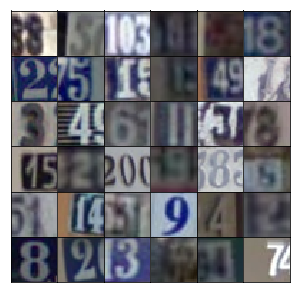

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [21]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1,4,4,512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha*x1, x1)
        # 4x4x512
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128
        
        # Output layer, 32x32x3
        logits =  tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
tf_cfg = tf.ConfigProto(allow_soft_placement=True)
tf_cfg.gpu_options.per_process_gpu_memory_fraction = 0.4
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0
    
    with tf.Session(config=tf_cfg) as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [26]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.3472... Generator Loss: 0.6299
Epoch 1/25... Discriminator Loss: 0.5823... Generator Loss: 1.2548
Epoch 1/25... Discriminator Loss: 0.1163... Generator Loss: 2.9487
Epoch 1/25... Discriminator Loss: 0.1244... Generator Loss: 3.0048
Epoch 1/25... Discriminator Loss: 0.1320... Generator Loss: 2.9844
Epoch 1/25... Discriminator Loss: 0.1346... Generator Loss: 2.7536
Epoch 1/25... Discriminator Loss: 0.1430... Generator Loss: 3.2436
Epoch 1/25... Discriminator Loss: 0.1338... Generator Loss: 3.2310
Epoch 1/25... Discriminator Loss: 0.1026... Generator Loss: 3.8926
Epoch 1/25... Discriminator Loss: 0.5674... Generator Loss: 2.5420


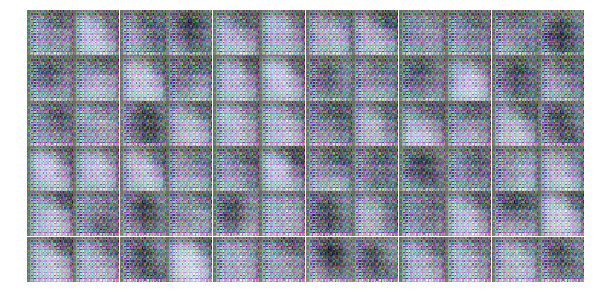

Epoch 1/25... Discriminator Loss: 0.5466... Generator Loss: 2.0101
Epoch 1/25... Discriminator Loss: 0.3502... Generator Loss: 2.2412
Epoch 1/25... Discriminator Loss: 0.7360... Generator Loss: 0.8859
Epoch 1/25... Discriminator Loss: 0.3763... Generator Loss: 3.0222
Epoch 1/25... Discriminator Loss: 0.8728... Generator Loss: 0.8066
Epoch 1/25... Discriminator Loss: 0.4949... Generator Loss: 1.3893
Epoch 1/25... Discriminator Loss: 0.2511... Generator Loss: 2.3684
Epoch 1/25... Discriminator Loss: 0.6767... Generator Loss: 1.6168
Epoch 1/25... Discriminator Loss: 1.1499... Generator Loss: 0.6028
Epoch 1/25... Discriminator Loss: 0.4181... Generator Loss: 1.9116


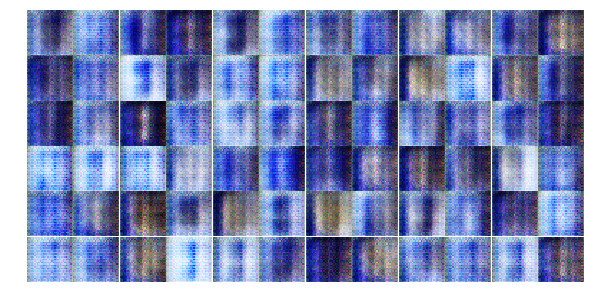

Epoch 1/25... Discriminator Loss: 1.0700... Generator Loss: 1.3730
Epoch 1/25... Discriminator Loss: 0.5143... Generator Loss: 2.0072
Epoch 1/25... Discriminator Loss: 0.4719... Generator Loss: 1.4087
Epoch 1/25... Discriminator Loss: 0.4567... Generator Loss: 1.5762
Epoch 1/25... Discriminator Loss: 3.3270... Generator Loss: 6.8804
Epoch 1/25... Discriminator Loss: 1.2480... Generator Loss: 1.4059
Epoch 1/25... Discriminator Loss: 1.2281... Generator Loss: 2.0418
Epoch 1/25... Discriminator Loss: 0.4570... Generator Loss: 2.2470
Epoch 1/25... Discriminator Loss: 1.0736... Generator Loss: 2.8351
Epoch 1/25... Discriminator Loss: 0.6710... Generator Loss: 1.2647


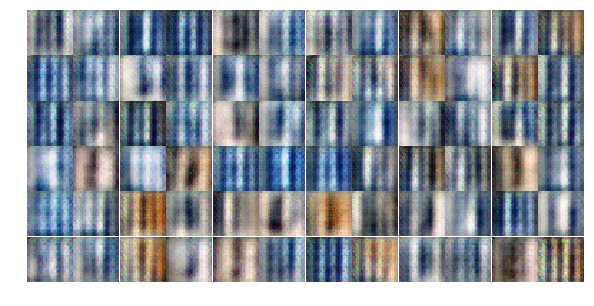

Epoch 1/25... Discriminator Loss: 0.4982... Generator Loss: 1.9712
Epoch 1/25... Discriminator Loss: 0.6972... Generator Loss: 1.1217
Epoch 1/25... Discriminator Loss: 0.5144... Generator Loss: 2.1568
Epoch 1/25... Discriminator Loss: 0.6087... Generator Loss: 1.4737
Epoch 1/25... Discriminator Loss: 0.4513... Generator Loss: 1.7233
Epoch 1/25... Discriminator Loss: 0.2749... Generator Loss: 2.3539
Epoch 1/25... Discriminator Loss: 0.6793... Generator Loss: 0.9968
Epoch 1/25... Discriminator Loss: 0.5811... Generator Loss: 1.6737
Epoch 1/25... Discriminator Loss: 0.2499... Generator Loss: 2.8166
Epoch 1/25... Discriminator Loss: 0.3269... Generator Loss: 3.8317


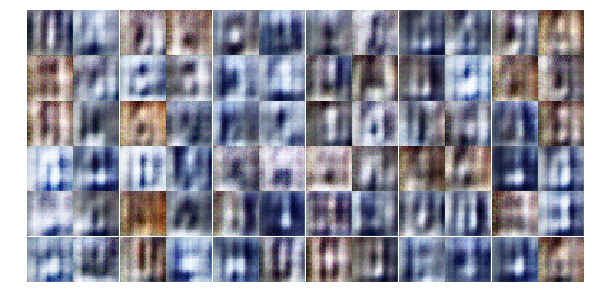

Epoch 1/25... Discriminator Loss: 0.3673... Generator Loss: 1.8110
Epoch 1/25... Discriminator Loss: 0.2433... Generator Loss: 2.7249
Epoch 1/25... Discriminator Loss: 0.3778... Generator Loss: 1.6705
Epoch 1/25... Discriminator Loss: 0.1782... Generator Loss: 3.1507
Epoch 1/25... Discriminator Loss: 0.8848... Generator Loss: 1.4552
Epoch 1/25... Discriminator Loss: 0.9471... Generator Loss: 1.0221
Epoch 1/25... Discriminator Loss: 0.5171... Generator Loss: 1.8701
Epoch 1/25... Discriminator Loss: 1.0207... Generator Loss: 0.8569
Epoch 1/25... Discriminator Loss: 0.4945... Generator Loss: 1.3958
Epoch 1/25... Discriminator Loss: 0.9737... Generator Loss: 0.9372


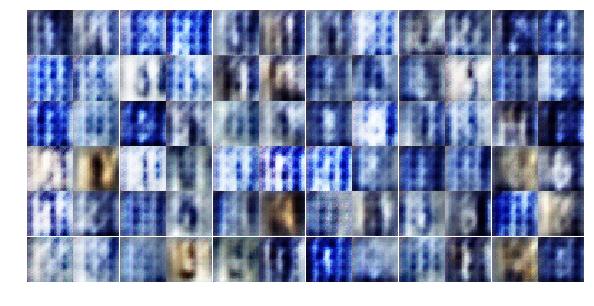

Epoch 1/25... Discriminator Loss: 1.2577... Generator Loss: 1.7746
Epoch 1/25... Discriminator Loss: 0.7685... Generator Loss: 1.3631
Epoch 1/25... Discriminator Loss: 0.7472... Generator Loss: 1.2042
Epoch 1/25... Discriminator Loss: 0.8718... Generator Loss: 1.0493
Epoch 1/25... Discriminator Loss: 0.9732... Generator Loss: 2.0379
Epoch 1/25... Discriminator Loss: 0.6144... Generator Loss: 1.2949
Epoch 1/25... Discriminator Loss: 0.6512... Generator Loss: 1.7695
Epoch 2/25... Discriminator Loss: 0.7887... Generator Loss: 1.5702
Epoch 2/25... Discriminator Loss: 0.6419... Generator Loss: 1.8202
Epoch 2/25... Discriminator Loss: 0.7661... Generator Loss: 1.0744


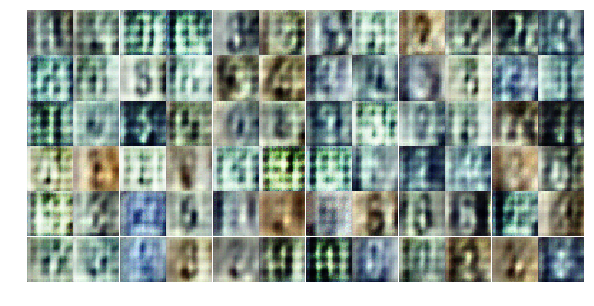

Epoch 2/25... Discriminator Loss: 0.9245... Generator Loss: 1.1258
Epoch 2/25... Discriminator Loss: 0.9780... Generator Loss: 1.1993
Epoch 2/25... Discriminator Loss: 1.0483... Generator Loss: 1.2485
Epoch 2/25... Discriminator Loss: 1.1124... Generator Loss: 1.3310
Epoch 2/25... Discriminator Loss: 0.7494... Generator Loss: 1.3578
Epoch 2/25... Discriminator Loss: 0.9296... Generator Loss: 1.3329
Epoch 2/25... Discriminator Loss: 1.0562... Generator Loss: 1.0965
Epoch 2/25... Discriminator Loss: 0.6714... Generator Loss: 1.5370
Epoch 2/25... Discriminator Loss: 0.7826... Generator Loss: 1.5912
Epoch 2/25... Discriminator Loss: 0.9345... Generator Loss: 1.2025


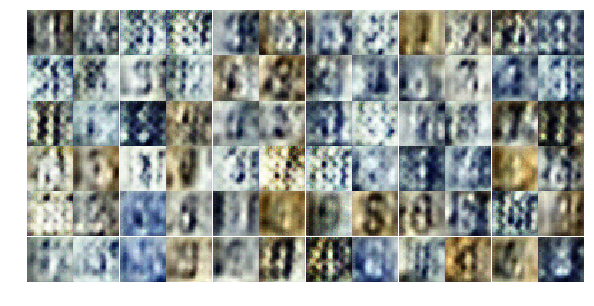

Epoch 2/25... Discriminator Loss: 1.1384... Generator Loss: 0.8887
Epoch 2/25... Discriminator Loss: 0.8754... Generator Loss: 1.9660
Epoch 2/25... Discriminator Loss: 0.7423... Generator Loss: 1.0561
Epoch 2/25... Discriminator Loss: 0.9467... Generator Loss: 1.4201
Epoch 2/25... Discriminator Loss: 0.7850... Generator Loss: 1.4992
Epoch 2/25... Discriminator Loss: 1.2267... Generator Loss: 0.9094
Epoch 2/25... Discriminator Loss: 1.2253... Generator Loss: 1.2132
Epoch 2/25... Discriminator Loss: 1.1426... Generator Loss: 1.0514
Epoch 2/25... Discriminator Loss: 1.0492... Generator Loss: 1.2776
Epoch 2/25... Discriminator Loss: 1.3747... Generator Loss: 0.6306


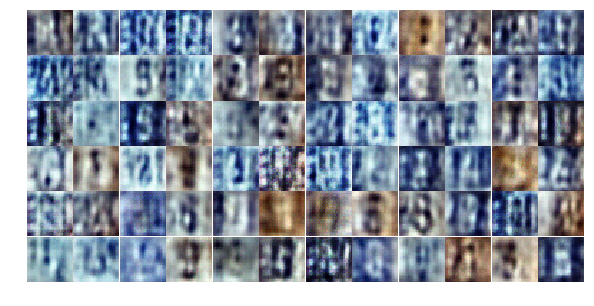

Epoch 2/25... Discriminator Loss: 1.0095... Generator Loss: 0.8639
Epoch 2/25... Discriminator Loss: 1.0945... Generator Loss: 1.4680
Epoch 2/25... Discriminator Loss: 1.1018... Generator Loss: 1.0235
Epoch 2/25... Discriminator Loss: 0.9086... Generator Loss: 1.1962
Epoch 2/25... Discriminator Loss: 0.9208... Generator Loss: 1.4601
Epoch 2/25... Discriminator Loss: 0.8095... Generator Loss: 1.2893
Epoch 2/25... Discriminator Loss: 1.0144... Generator Loss: 1.1897
Epoch 2/25... Discriminator Loss: 0.9684... Generator Loss: 0.9725
Epoch 2/25... Discriminator Loss: 1.1758... Generator Loss: 0.9271
Epoch 2/25... Discriminator Loss: 1.0093... Generator Loss: 1.1109


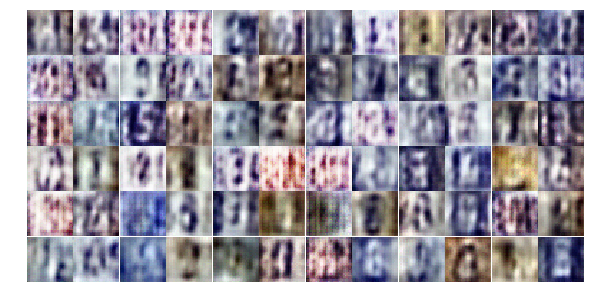

Epoch 2/25... Discriminator Loss: 1.1990... Generator Loss: 0.6615
Epoch 2/25... Discriminator Loss: 1.1770... Generator Loss: 0.9586
Epoch 2/25... Discriminator Loss: 0.9634... Generator Loss: 1.1244
Epoch 2/25... Discriminator Loss: 0.8780... Generator Loss: 1.2392
Epoch 2/25... Discriminator Loss: 0.9658... Generator Loss: 1.2661
Epoch 2/25... Discriminator Loss: 1.2855... Generator Loss: 0.6798
Epoch 2/25... Discriminator Loss: 1.1007... Generator Loss: 0.9565
Epoch 2/25... Discriminator Loss: 1.1588... Generator Loss: 1.2188
Epoch 2/25... Discriminator Loss: 1.1342... Generator Loss: 0.7596
Epoch 2/25... Discriminator Loss: 1.0032... Generator Loss: 1.0903


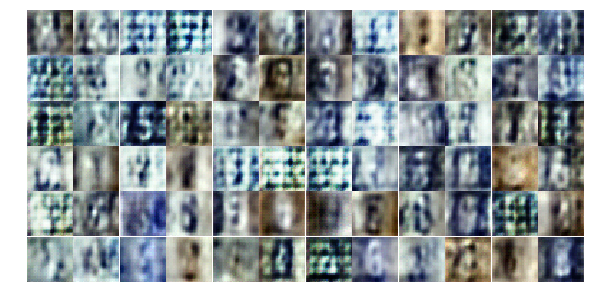

Epoch 2/25... Discriminator Loss: 1.0547... Generator Loss: 1.2513
Epoch 2/25... Discriminator Loss: 0.9930... Generator Loss: 1.3097
Epoch 2/25... Discriminator Loss: 0.8914... Generator Loss: 0.9604
Epoch 2/25... Discriminator Loss: 1.3363... Generator Loss: 0.5036
Epoch 2/25... Discriminator Loss: 1.1604... Generator Loss: 0.8070
Epoch 2/25... Discriminator Loss: 0.7117... Generator Loss: 1.0638
Epoch 2/25... Discriminator Loss: 0.5748... Generator Loss: 1.7830
Epoch 2/25... Discriminator Loss: 0.9149... Generator Loss: 1.1999
Epoch 2/25... Discriminator Loss: 0.7883... Generator Loss: 1.5754
Epoch 2/25... Discriminator Loss: 0.8849... Generator Loss: 1.1074


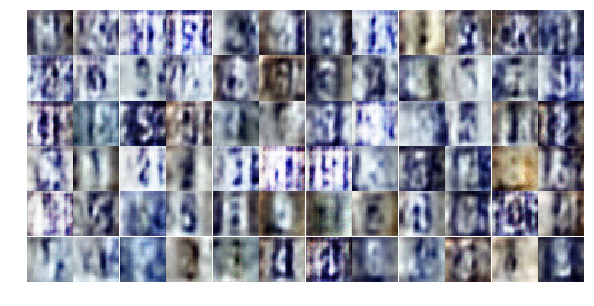

Epoch 2/25... Discriminator Loss: 0.6899... Generator Loss: 1.2249
Epoch 2/25... Discriminator Loss: 0.6803... Generator Loss: 1.1284
Epoch 2/25... Discriminator Loss: 1.3913... Generator Loss: 0.4642
Epoch 2/25... Discriminator Loss: 1.1431... Generator Loss: 1.0739
Epoch 3/25... Discriminator Loss: 0.6872... Generator Loss: 2.1342
Epoch 3/25... Discriminator Loss: 0.8113... Generator Loss: 1.0386
Epoch 3/25... Discriminator Loss: 1.0494... Generator Loss: 1.4399
Epoch 3/25... Discriminator Loss: 1.0397... Generator Loss: 0.6208
Epoch 3/25... Discriminator Loss: 0.9523... Generator Loss: 0.8290
Epoch 3/25... Discriminator Loss: 1.6872... Generator Loss: 0.3956


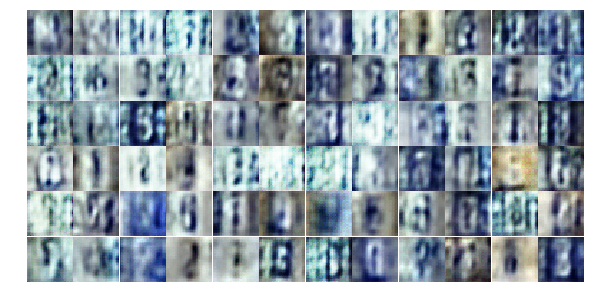

Epoch 3/25... Discriminator Loss: 0.7280... Generator Loss: 1.2093
Epoch 3/25... Discriminator Loss: 0.7004... Generator Loss: 1.2502
Epoch 3/25... Discriminator Loss: 0.4830... Generator Loss: 1.6000
Epoch 3/25... Discriminator Loss: 0.6263... Generator Loss: 1.3662
Epoch 3/25... Discriminator Loss: 0.5339... Generator Loss: 1.5776
Epoch 3/25... Discriminator Loss: 0.8866... Generator Loss: 1.7334
Epoch 3/25... Discriminator Loss: 0.5367... Generator Loss: 1.8150
Epoch 3/25... Discriminator Loss: 1.0352... Generator Loss: 1.8003
Epoch 3/25... Discriminator Loss: 0.6642... Generator Loss: 1.3199
Epoch 3/25... Discriminator Loss: 0.9869... Generator Loss: 0.7724


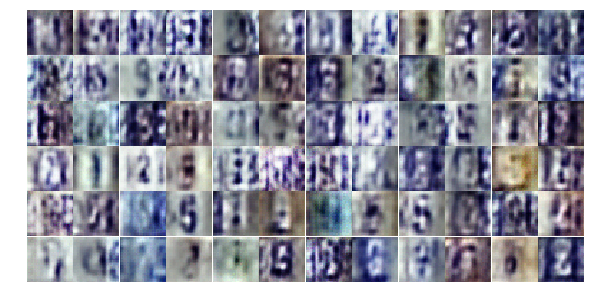

Epoch 3/25... Discriminator Loss: 0.6540... Generator Loss: 1.2941
Epoch 3/25... Discriminator Loss: 0.6096... Generator Loss: 1.1138
Epoch 3/25... Discriminator Loss: 0.6001... Generator Loss: 1.3529
Epoch 3/25... Discriminator Loss: 0.6074... Generator Loss: 1.4737
Epoch 3/25... Discriminator Loss: 0.6958... Generator Loss: 1.1178
Epoch 3/25... Discriminator Loss: 0.5576... Generator Loss: 2.2243
Epoch 3/25... Discriminator Loss: 0.7434... Generator Loss: 1.7378
Epoch 3/25... Discriminator Loss: 0.6854... Generator Loss: 1.8328
Epoch 3/25... Discriminator Loss: 0.4453... Generator Loss: 1.6469
Epoch 3/25... Discriminator Loss: 2.0691... Generator Loss: 5.9624


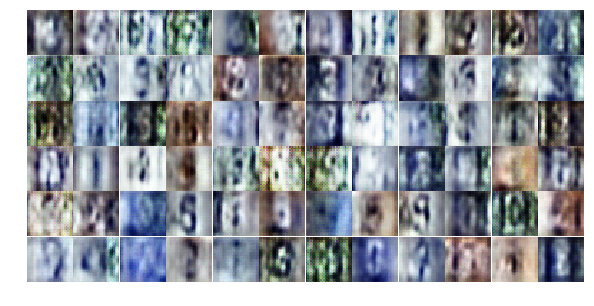

Epoch 3/25... Discriminator Loss: 0.4756... Generator Loss: 2.0277
Epoch 3/25... Discriminator Loss: 0.7500... Generator Loss: 1.1448
Epoch 3/25... Discriminator Loss: 0.7692... Generator Loss: 1.2788
Epoch 3/25... Discriminator Loss: 0.5429... Generator Loss: 1.8993
Epoch 3/25... Discriminator Loss: 0.7804... Generator Loss: 1.8352
Epoch 3/25... Discriminator Loss: 0.4651... Generator Loss: 1.6240
Epoch 3/25... Discriminator Loss: 0.9033... Generator Loss: 1.0618
Epoch 3/25... Discriminator Loss: 0.4247... Generator Loss: 1.8545
Epoch 3/25... Discriminator Loss: 0.4343... Generator Loss: 1.5829
Epoch 3/25... Discriminator Loss: 0.7675... Generator Loss: 0.9687


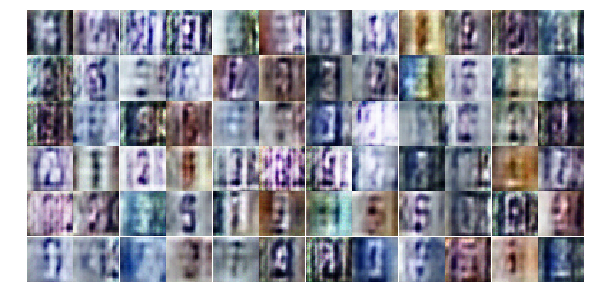

Epoch 3/25... Discriminator Loss: 0.5126... Generator Loss: 1.4035
Epoch 3/25... Discriminator Loss: 0.3905... Generator Loss: 1.8160
Epoch 3/25... Discriminator Loss: 0.4216... Generator Loss: 1.8736
Epoch 3/25... Discriminator Loss: 0.4559... Generator Loss: 1.9911
Epoch 3/25... Discriminator Loss: 0.6711... Generator Loss: 2.9310
Epoch 3/25... Discriminator Loss: 0.7458... Generator Loss: 1.0973
Epoch 3/25... Discriminator Loss: 0.6964... Generator Loss: 1.1062
Epoch 3/25... Discriminator Loss: 0.4138... Generator Loss: 1.5603
Epoch 3/25... Discriminator Loss: 0.6648... Generator Loss: 1.0767
Epoch 3/25... Discriminator Loss: 0.9237... Generator Loss: 0.8752


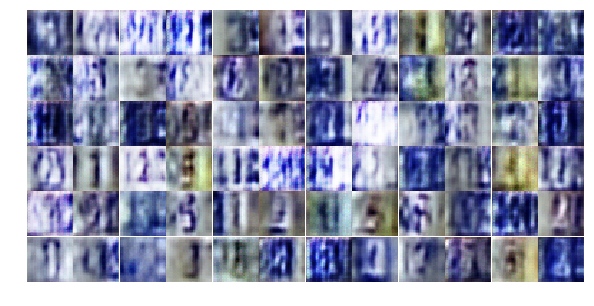

Epoch 3/25... Discriminator Loss: 0.7533... Generator Loss: 1.2586
Epoch 3/25... Discriminator Loss: 0.6465... Generator Loss: 1.2189
Epoch 3/25... Discriminator Loss: 0.4118... Generator Loss: 1.8636
Epoch 3/25... Discriminator Loss: 0.5687... Generator Loss: 1.3511
Epoch 3/25... Discriminator Loss: 0.7745... Generator Loss: 3.5741
Epoch 3/25... Discriminator Loss: 0.4443... Generator Loss: 1.5079
Epoch 3/25... Discriminator Loss: 0.3552... Generator Loss: 1.9361
Epoch 3/25... Discriminator Loss: 0.4689... Generator Loss: 1.7371
Epoch 3/25... Discriminator Loss: 0.8369... Generator Loss: 1.2532
Epoch 3/25... Discriminator Loss: 0.8046... Generator Loss: 0.9383


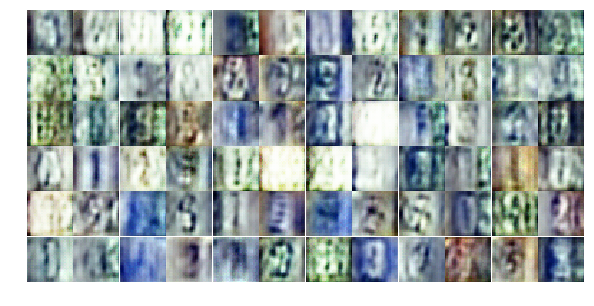

Epoch 3/25... Discriminator Loss: 0.6939... Generator Loss: 2.0407
Epoch 4/25... Discriminator Loss: 0.5501... Generator Loss: 1.7680
Epoch 4/25... Discriminator Loss: 0.7195... Generator Loss: 1.2920
Epoch 4/25... Discriminator Loss: 0.9194... Generator Loss: 0.7775
Epoch 4/25... Discriminator Loss: 0.5838... Generator Loss: 1.8259
Epoch 4/25... Discriminator Loss: 0.7238... Generator Loss: 2.4252
Epoch 4/25... Discriminator Loss: 1.0332... Generator Loss: 1.9141
Epoch 4/25... Discriminator Loss: 0.8061... Generator Loss: 1.1176
Epoch 4/25... Discriminator Loss: 0.6406... Generator Loss: 1.5776
Epoch 4/25... Discriminator Loss: 0.7604... Generator Loss: 2.1504


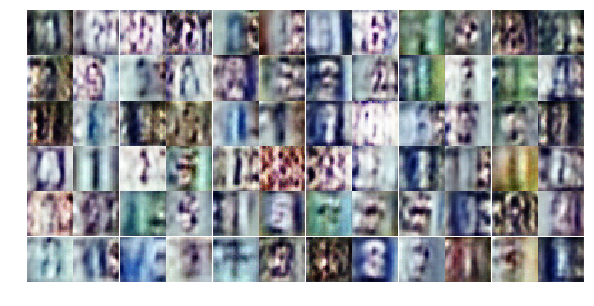

Epoch 4/25... Discriminator Loss: 0.5270... Generator Loss: 3.1736
Epoch 4/25... Discriminator Loss: 0.6018... Generator Loss: 1.4856
Epoch 4/25... Discriminator Loss: 1.3938... Generator Loss: 1.1230
Epoch 4/25... Discriminator Loss: 0.8537... Generator Loss: 2.4716
Epoch 4/25... Discriminator Loss: 0.8274... Generator Loss: 2.1251
Epoch 4/25... Discriminator Loss: 1.8347... Generator Loss: 0.2490
Epoch 4/25... Discriminator Loss: 0.5453... Generator Loss: 2.1470
Epoch 4/25... Discriminator Loss: 0.5786... Generator Loss: 1.2857
Epoch 4/25... Discriminator Loss: 0.8488... Generator Loss: 0.8640
Epoch 4/25... Discriminator Loss: 0.6521... Generator Loss: 2.1213


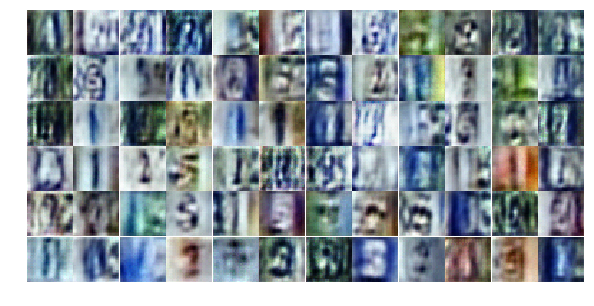

Epoch 4/25... Discriminator Loss: 0.5437... Generator Loss: 1.6698
Epoch 4/25... Discriminator Loss: 0.5711... Generator Loss: 2.8110
Epoch 4/25... Discriminator Loss: 0.5844... Generator Loss: 2.0009
Epoch 4/25... Discriminator Loss: 0.6769... Generator Loss: 1.0646
Epoch 4/25... Discriminator Loss: 0.2637... Generator Loss: 2.3943
Epoch 4/25... Discriminator Loss: 0.3683... Generator Loss: 2.4759
Epoch 4/25... Discriminator Loss: 0.9380... Generator Loss: 0.6888
Epoch 4/25... Discriminator Loss: 0.4036... Generator Loss: 1.7433
Epoch 4/25... Discriminator Loss: 0.9651... Generator Loss: 2.9425
Epoch 4/25... Discriminator Loss: 0.4452... Generator Loss: 1.7478


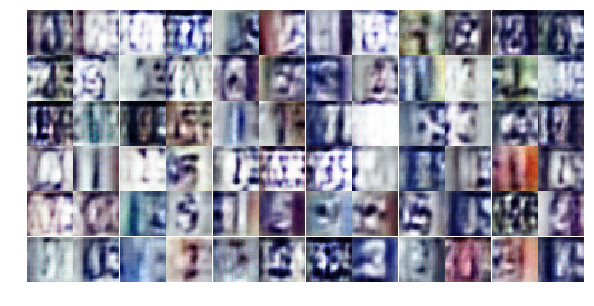

Epoch 4/25... Discriminator Loss: 0.4676... Generator Loss: 1.5269
Epoch 4/25... Discriminator Loss: 0.3899... Generator Loss: 2.1233
Epoch 4/25... Discriminator Loss: 0.4486... Generator Loss: 1.7836
Epoch 4/25... Discriminator Loss: 0.3039... Generator Loss: 2.1348
Epoch 4/25... Discriminator Loss: 0.6773... Generator Loss: 1.0358
Epoch 4/25... Discriminator Loss: 0.5740... Generator Loss: 1.7031
Epoch 4/25... Discriminator Loss: 0.4317... Generator Loss: 2.2573
Epoch 4/25... Discriminator Loss: 0.6537... Generator Loss: 1.0009
Epoch 4/25... Discriminator Loss: 0.6710... Generator Loss: 0.9904
Epoch 4/25... Discriminator Loss: 0.7291... Generator Loss: 0.9768


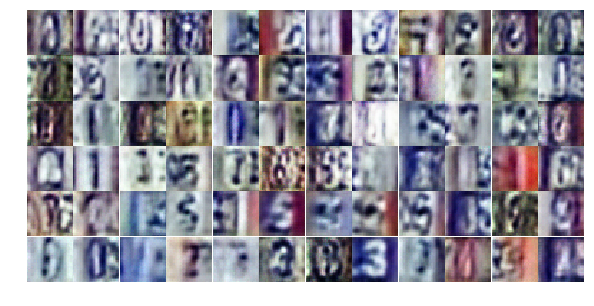

Epoch 4/25... Discriminator Loss: 0.5893... Generator Loss: 1.2160
Epoch 4/25... Discriminator Loss: 1.5807... Generator Loss: 4.2691
Epoch 4/25... Discriminator Loss: 1.1428... Generator Loss: 0.5754
Epoch 4/25... Discriminator Loss: 0.4578... Generator Loss: 1.8358
Epoch 4/25... Discriminator Loss: 0.4302... Generator Loss: 2.1246
Epoch 4/25... Discriminator Loss: 0.9188... Generator Loss: 0.8316
Epoch 4/25... Discriminator Loss: 0.5814... Generator Loss: 1.3789
Epoch 4/25... Discriminator Loss: 0.5070... Generator Loss: 1.6884
Epoch 4/25... Discriminator Loss: 0.8161... Generator Loss: 0.7998
Epoch 4/25... Discriminator Loss: 0.4462... Generator Loss: 2.0896


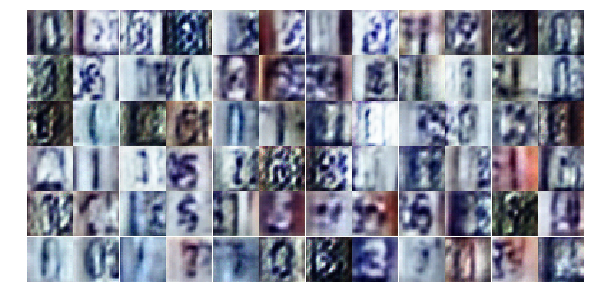

Epoch 4/25... Discriminator Loss: 0.5265... Generator Loss: 1.3767
Epoch 4/25... Discriminator Loss: 0.3168... Generator Loss: 1.8863
Epoch 4/25... Discriminator Loss: 0.2350... Generator Loss: 2.3161
Epoch 4/25... Discriminator Loss: 0.8386... Generator Loss: 1.9088
Epoch 4/25... Discriminator Loss: 0.8486... Generator Loss: 0.7267
Epoch 4/25... Discriminator Loss: 0.5848... Generator Loss: 1.1527
Epoch 4/25... Discriminator Loss: 0.4480... Generator Loss: 2.1804
Epoch 4/25... Discriminator Loss: 1.1308... Generator Loss: 0.6013
Epoch 4/25... Discriminator Loss: 0.4674... Generator Loss: 2.0447
Epoch 5/25... Discriminator Loss: 0.3470... Generator Loss: 1.7578


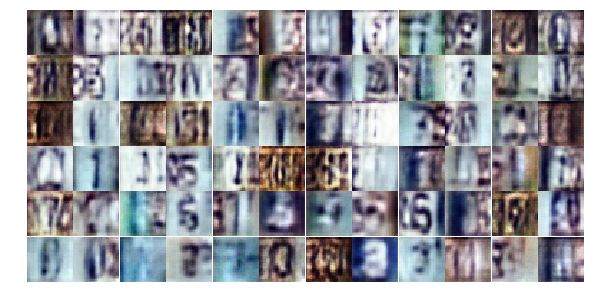

Epoch 5/25... Discriminator Loss: 0.3451... Generator Loss: 1.7386
Epoch 5/25... Discriminator Loss: 0.4428... Generator Loss: 1.9328
Epoch 5/25... Discriminator Loss: 0.4524... Generator Loss: 1.6140
Epoch 5/25... Discriminator Loss: 0.4126... Generator Loss: 1.5531
Epoch 5/25... Discriminator Loss: 0.3841... Generator Loss: 1.7248
Epoch 5/25... Discriminator Loss: 0.5983... Generator Loss: 1.1217
Epoch 5/25... Discriminator Loss: 0.4474... Generator Loss: 1.3702
Epoch 5/25... Discriminator Loss: 0.3866... Generator Loss: 2.1981
Epoch 5/25... Discriminator Loss: 0.7006... Generator Loss: 1.0374
Epoch 5/25... Discriminator Loss: 1.4354... Generator Loss: 0.4552


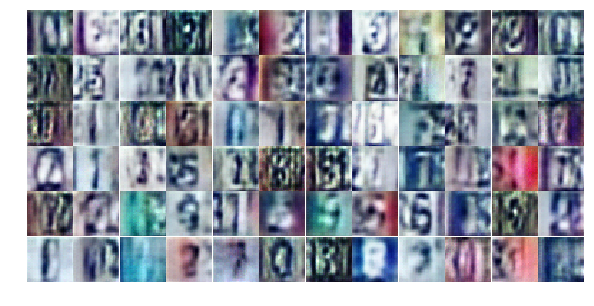

Epoch 5/25... Discriminator Loss: 0.7352... Generator Loss: 1.4773
Epoch 5/25... Discriminator Loss: 0.4511... Generator Loss: 1.6746
Epoch 5/25... Discriminator Loss: 0.5424... Generator Loss: 1.2544
Epoch 5/25... Discriminator Loss: 1.9676... Generator Loss: 0.2077
Epoch 5/25... Discriminator Loss: 0.6695... Generator Loss: 1.6422
Epoch 5/25... Discriminator Loss: 1.2430... Generator Loss: 0.6077
Epoch 5/25... Discriminator Loss: 0.5004... Generator Loss: 1.5530
Epoch 5/25... Discriminator Loss: 0.4339... Generator Loss: 1.8300
Epoch 5/25... Discriminator Loss: 0.5285... Generator Loss: 1.3021
Epoch 5/25... Discriminator Loss: 0.5525... Generator Loss: 1.2348


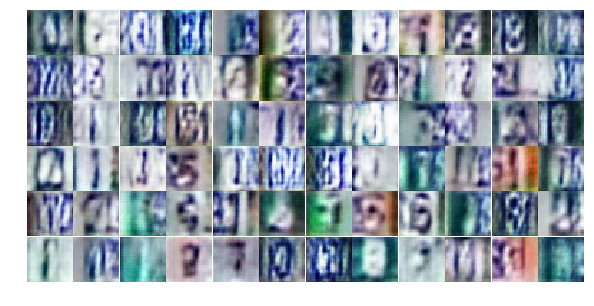

Epoch 5/25... Discriminator Loss: 0.3743... Generator Loss: 1.8574
Epoch 5/25... Discriminator Loss: 0.6337... Generator Loss: 1.4123
Epoch 5/25... Discriminator Loss: 0.5271... Generator Loss: 2.8501
Epoch 5/25... Discriminator Loss: 0.5843... Generator Loss: 2.4747
Epoch 5/25... Discriminator Loss: 0.3399... Generator Loss: 1.7474
Epoch 5/25... Discriminator Loss: 0.7199... Generator Loss: 0.9430
Epoch 5/25... Discriminator Loss: 0.8293... Generator Loss: 0.7718
Epoch 5/25... Discriminator Loss: 0.5795... Generator Loss: 1.1874
Epoch 5/25... Discriminator Loss: 0.9360... Generator Loss: 0.7133
Epoch 5/25... Discriminator Loss: 0.2682... Generator Loss: 2.1197


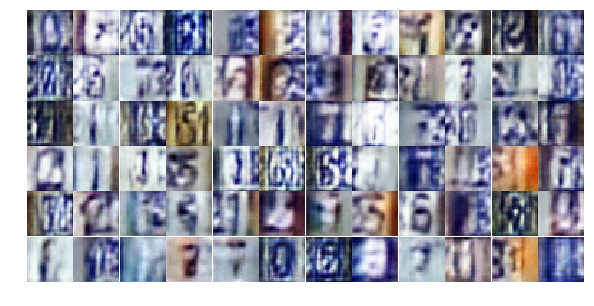

Epoch 5/25... Discriminator Loss: 0.4987... Generator Loss: 1.5691
Epoch 5/25... Discriminator Loss: 0.3556... Generator Loss: 1.9277
Epoch 5/25... Discriminator Loss: 0.5631... Generator Loss: 1.5043
Epoch 5/25... Discriminator Loss: 0.4802... Generator Loss: 1.4054
Epoch 5/25... Discriminator Loss: 1.0190... Generator Loss: 0.8629
Epoch 5/25... Discriminator Loss: 0.4682... Generator Loss: 2.8793
Epoch 5/25... Discriminator Loss: 0.6212... Generator Loss: 1.1564
Epoch 5/25... Discriminator Loss: 0.5668... Generator Loss: 1.2259
Epoch 5/25... Discriminator Loss: 0.9847... Generator Loss: 0.6481
Epoch 5/25... Discriminator Loss: 0.3282... Generator Loss: 2.1108


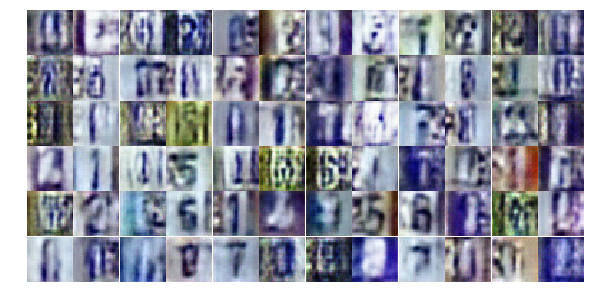

Epoch 5/25... Discriminator Loss: 0.3726... Generator Loss: 2.4457
Epoch 5/25... Discriminator Loss: 0.8392... Generator Loss: 0.7685
Epoch 5/25... Discriminator Loss: 1.0031... Generator Loss: 0.6503
Epoch 5/25... Discriminator Loss: 0.3587... Generator Loss: 1.8849
Epoch 5/25... Discriminator Loss: 0.8616... Generator Loss: 1.5009
Epoch 5/25... Discriminator Loss: 0.8431... Generator Loss: 0.8465
Epoch 5/25... Discriminator Loss: 0.6864... Generator Loss: 1.2783
Epoch 5/25... Discriminator Loss: 0.6527... Generator Loss: 1.0132
Epoch 5/25... Discriminator Loss: 0.5945... Generator Loss: 1.1382
Epoch 5/25... Discriminator Loss: 0.5024... Generator Loss: 1.4812


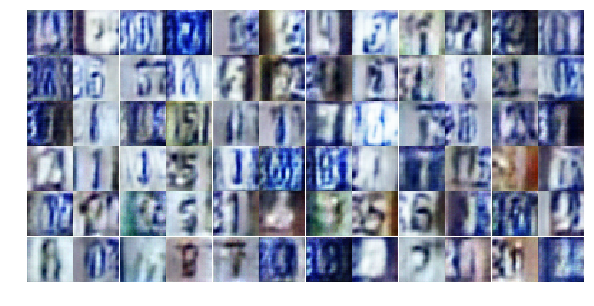

Epoch 5/25... Discriminator Loss: 1.2195... Generator Loss: 0.4379
Epoch 5/25... Discriminator Loss: 0.7859... Generator Loss: 1.1052
Epoch 5/25... Discriminator Loss: 0.6715... Generator Loss: 1.2220
Epoch 5/25... Discriminator Loss: 0.7588... Generator Loss: 0.8583
Epoch 5/25... Discriminator Loss: 0.5780... Generator Loss: 1.4156
Epoch 5/25... Discriminator Loss: 0.6271... Generator Loss: 1.4234
Epoch 6/25... Discriminator Loss: 0.5744... Generator Loss: 1.1809
Epoch 6/25... Discriminator Loss: 0.4003... Generator Loss: 1.6250
Epoch 6/25... Discriminator Loss: 0.5486... Generator Loss: 1.4712
Epoch 6/25... Discriminator Loss: 0.8827... Generator Loss: 1.0357


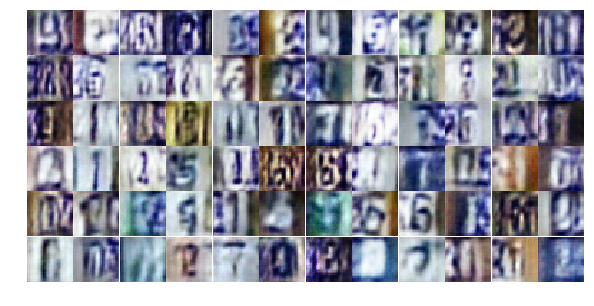

Epoch 6/25... Discriminator Loss: 1.5658... Generator Loss: 0.3004
Epoch 6/25... Discriminator Loss: 0.9068... Generator Loss: 0.8089
Epoch 6/25... Discriminator Loss: 1.0609... Generator Loss: 0.6703
Epoch 6/25... Discriminator Loss: 0.7795... Generator Loss: 1.1282
Epoch 6/25... Discriminator Loss: 0.9039... Generator Loss: 0.7084
Epoch 6/25... Discriminator Loss: 0.5187... Generator Loss: 1.2504
Epoch 6/25... Discriminator Loss: 0.4090... Generator Loss: 2.0270
Epoch 6/25... Discriminator Loss: 0.5352... Generator Loss: 1.9195
Epoch 6/25... Discriminator Loss: 0.7088... Generator Loss: 1.1440
Epoch 6/25... Discriminator Loss: 0.3915... Generator Loss: 2.0250


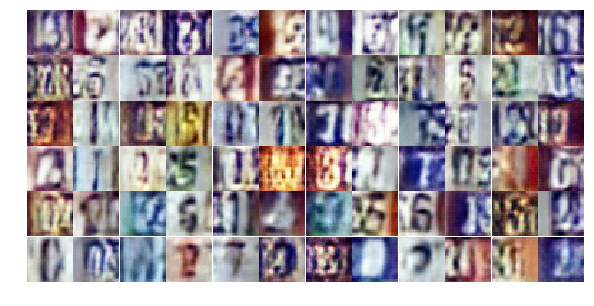

Epoch 6/25... Discriminator Loss: 0.7355... Generator Loss: 2.8236
Epoch 6/25... Discriminator Loss: 0.6303... Generator Loss: 1.6845
Epoch 6/25... Discriminator Loss: 1.2131... Generator Loss: 0.4779
Epoch 6/25... Discriminator Loss: 0.6902... Generator Loss: 2.3421
Epoch 6/25... Discriminator Loss: 0.5131... Generator Loss: 1.3256
Epoch 6/25... Discriminator Loss: 0.5925... Generator Loss: 1.5241
Epoch 6/25... Discriminator Loss: 0.5378... Generator Loss: 1.3076
Epoch 6/25... Discriminator Loss: 0.7005... Generator Loss: 1.0162
Epoch 6/25... Discriminator Loss: 0.5331... Generator Loss: 2.1092
Epoch 6/25... Discriminator Loss: 0.6635... Generator Loss: 1.9020


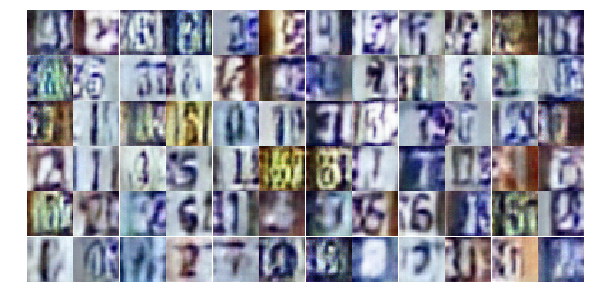

Epoch 6/25... Discriminator Loss: 0.7668... Generator Loss: 0.8611
Epoch 6/25... Discriminator Loss: 0.6360... Generator Loss: 1.1633
Epoch 6/25... Discriminator Loss: 1.3543... Generator Loss: 0.4957
Epoch 6/25... Discriminator Loss: 0.8794... Generator Loss: 0.7233
Epoch 6/25... Discriminator Loss: 0.7789... Generator Loss: 2.5173
Epoch 6/25... Discriminator Loss: 1.3534... Generator Loss: 1.9771
Epoch 6/25... Discriminator Loss: 0.6052... Generator Loss: 1.2834
Epoch 6/25... Discriminator Loss: 0.4071... Generator Loss: 1.8897
Epoch 6/25... Discriminator Loss: 0.5509... Generator Loss: 1.4153
Epoch 6/25... Discriminator Loss: 0.4969... Generator Loss: 1.6608


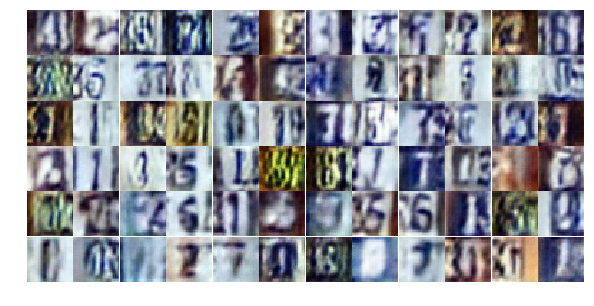

Epoch 6/25... Discriminator Loss: 1.1158... Generator Loss: 0.5421
Epoch 6/25... Discriminator Loss: 0.5418... Generator Loss: 1.4105
Epoch 6/25... Discriminator Loss: 1.0885... Generator Loss: 0.5907
Epoch 6/25... Discriminator Loss: 0.6984... Generator Loss: 0.9145
Epoch 6/25... Discriminator Loss: 0.7620... Generator Loss: 1.2218
Epoch 6/25... Discriminator Loss: 0.5542... Generator Loss: 1.2305
Epoch 6/25... Discriminator Loss: 0.4885... Generator Loss: 1.5633
Epoch 6/25... Discriminator Loss: 0.4695... Generator Loss: 1.6928
Epoch 6/25... Discriminator Loss: 1.0156... Generator Loss: 0.6191
Epoch 6/25... Discriminator Loss: 0.5887... Generator Loss: 1.0118


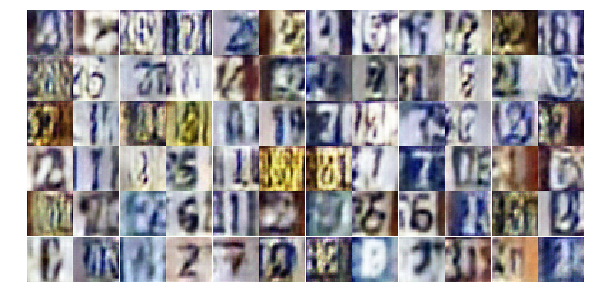

Epoch 6/25... Discriminator Loss: 1.3589... Generator Loss: 3.4063
Epoch 6/25... Discriminator Loss: 0.7850... Generator Loss: 1.8179
Epoch 6/25... Discriminator Loss: 0.9738... Generator Loss: 0.6176
Epoch 6/25... Discriminator Loss: 0.5688... Generator Loss: 1.3098
Epoch 6/25... Discriminator Loss: 0.4936... Generator Loss: 1.5757
Epoch 6/25... Discriminator Loss: 0.6811... Generator Loss: 0.9351
Epoch 6/25... Discriminator Loss: 0.8530... Generator Loss: 0.7771
Epoch 6/25... Discriminator Loss: 0.9170... Generator Loss: 0.7301
Epoch 6/25... Discriminator Loss: 0.5962... Generator Loss: 1.1387
Epoch 6/25... Discriminator Loss: 1.3355... Generator Loss: 0.4206


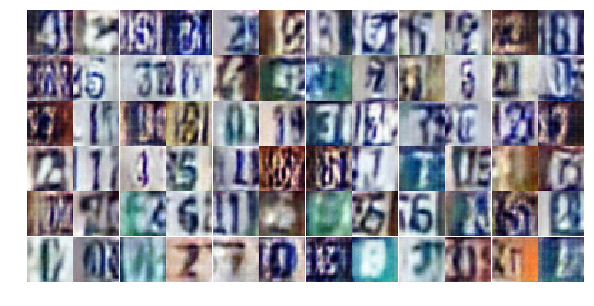

Epoch 6/25... Discriminator Loss: 0.4354... Generator Loss: 1.7166
Epoch 6/25... Discriminator Loss: 0.7136... Generator Loss: 1.0039
Epoch 6/25... Discriminator Loss: 0.5648... Generator Loss: 1.1543
Epoch 7/25... Discriminator Loss: 0.5500... Generator Loss: 2.9838
Epoch 7/25... Discriminator Loss: 0.3395... Generator Loss: 1.7493
Epoch 7/25... Discriminator Loss: 0.5013... Generator Loss: 1.4793
Epoch 7/25... Discriminator Loss: 0.8831... Generator Loss: 0.7778
Epoch 7/25... Discriminator Loss: 0.8621... Generator Loss: 0.9565
Epoch 7/25... Discriminator Loss: 2.2726... Generator Loss: 3.4130
Epoch 7/25... Discriminator Loss: 1.0026... Generator Loss: 0.7575


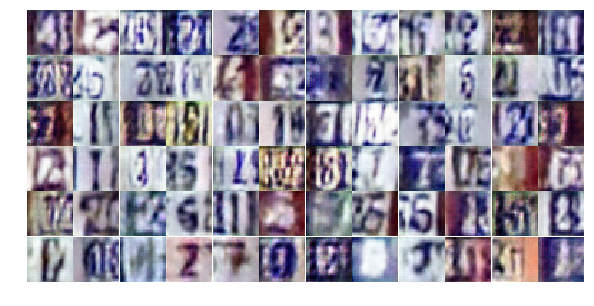

Epoch 7/25... Discriminator Loss: 0.7187... Generator Loss: 1.5773
Epoch 7/25... Discriminator Loss: 0.6948... Generator Loss: 1.0511
Epoch 7/25... Discriminator Loss: 0.5687... Generator Loss: 1.3298
Epoch 7/25... Discriminator Loss: 0.7042... Generator Loss: 1.2040
Epoch 7/25... Discriminator Loss: 0.6092... Generator Loss: 1.6782
Epoch 7/25... Discriminator Loss: 0.6233... Generator Loss: 1.0660
Epoch 7/25... Discriminator Loss: 0.7023... Generator Loss: 1.8462
Epoch 7/25... Discriminator Loss: 0.7934... Generator Loss: 2.3411
Epoch 7/25... Discriminator Loss: 0.7349... Generator Loss: 2.0623
Epoch 7/25... Discriminator Loss: 0.5629... Generator Loss: 1.2182


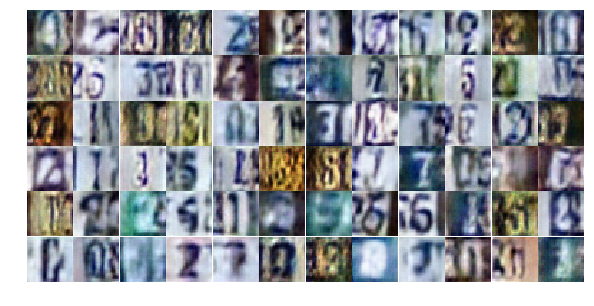

Epoch 7/25... Discriminator Loss: 0.6828... Generator Loss: 1.2210
Epoch 7/25... Discriminator Loss: 0.4039... Generator Loss: 1.8506
Epoch 7/25... Discriminator Loss: 1.6256... Generator Loss: 0.3325
Epoch 7/25... Discriminator Loss: 0.5039... Generator Loss: 1.3961
Epoch 7/25... Discriminator Loss: 0.6271... Generator Loss: 2.7982
Epoch 7/25... Discriminator Loss: 0.5019... Generator Loss: 1.3976
Epoch 7/25... Discriminator Loss: 0.5867... Generator Loss: 1.1206
Epoch 7/25... Discriminator Loss: 1.0837... Generator Loss: 0.5931
Epoch 7/25... Discriminator Loss: 0.3656... Generator Loss: 1.8075
Epoch 7/25... Discriminator Loss: 0.4915... Generator Loss: 1.3260


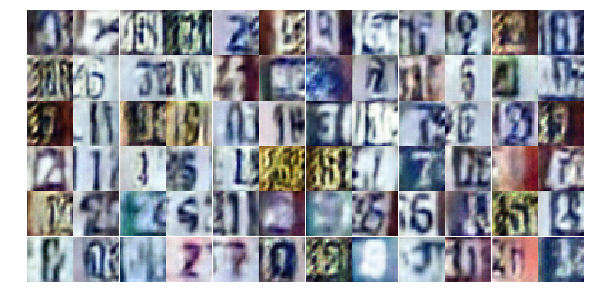

Epoch 7/25... Discriminator Loss: 0.7468... Generator Loss: 0.9401
Epoch 7/25... Discriminator Loss: 1.5689... Generator Loss: 0.3817
Epoch 7/25... Discriminator Loss: 0.4882... Generator Loss: 1.3683
Epoch 7/25... Discriminator Loss: 0.5541... Generator Loss: 1.2381
Epoch 7/25... Discriminator Loss: 0.4989... Generator Loss: 1.4272
Epoch 7/25... Discriminator Loss: 1.2374... Generator Loss: 0.4733
Epoch 7/25... Discriminator Loss: 0.5776... Generator Loss: 1.0931
Epoch 7/25... Discriminator Loss: 0.9578... Generator Loss: 0.6498
Epoch 7/25... Discriminator Loss: 0.7914... Generator Loss: 0.8828
Epoch 7/25... Discriminator Loss: 0.5132... Generator Loss: 2.2015


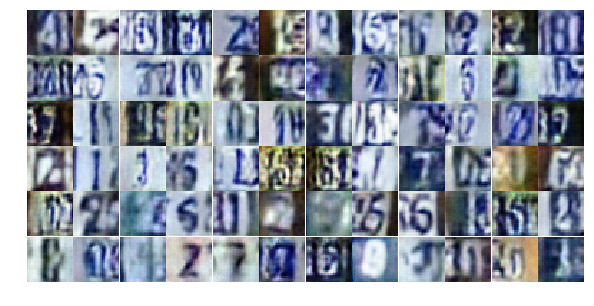

Epoch 7/25... Discriminator Loss: 1.4209... Generator Loss: 0.4160
Epoch 7/25... Discriminator Loss: 1.0418... Generator Loss: 2.9536
Epoch 7/25... Discriminator Loss: 0.3352... Generator Loss: 2.2143
Epoch 7/25... Discriminator Loss: 0.6433... Generator Loss: 1.2144
Epoch 7/25... Discriminator Loss: 0.4803... Generator Loss: 2.1114
Epoch 7/25... Discriminator Loss: 0.5090... Generator Loss: 1.2805
Epoch 7/25... Discriminator Loss: 0.3944... Generator Loss: 1.8827
Epoch 7/25... Discriminator Loss: 1.6333... Generator Loss: 0.3443
Epoch 7/25... Discriminator Loss: 0.4185... Generator Loss: 3.9164
Epoch 7/25... Discriminator Loss: 0.6378... Generator Loss: 1.1355


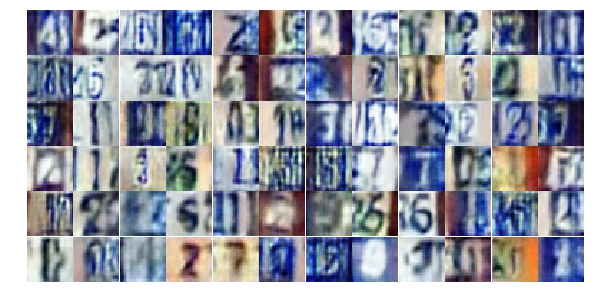

Epoch 7/25... Discriminator Loss: 0.6360... Generator Loss: 2.8949
Epoch 7/25... Discriminator Loss: 0.7641... Generator Loss: 1.1688
Epoch 7/25... Discriminator Loss: 0.7864... Generator Loss: 0.8759
Epoch 7/25... Discriminator Loss: 0.7421... Generator Loss: 0.8601
Epoch 7/25... Discriminator Loss: 0.5048... Generator Loss: 1.3307
Epoch 7/25... Discriminator Loss: 0.3227... Generator Loss: 2.0116
Epoch 7/25... Discriminator Loss: 0.9358... Generator Loss: 0.9210
Epoch 7/25... Discriminator Loss: 0.7693... Generator Loss: 2.0039
Epoch 7/25... Discriminator Loss: 0.6630... Generator Loss: 2.0364
Epoch 7/25... Discriminator Loss: 0.4558... Generator Loss: 1.2516


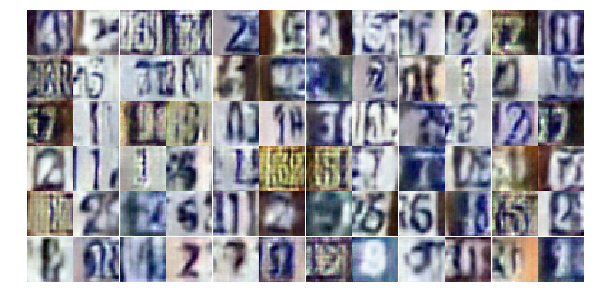

Epoch 7/25... Discriminator Loss: 0.3686... Generator Loss: 1.7775
Epoch 8/25... Discriminator Loss: 0.7334... Generator Loss: 0.9086
Epoch 8/25... Discriminator Loss: 0.9349... Generator Loss: 0.6625
Epoch 8/25... Discriminator Loss: 2.7322... Generator Loss: 0.1286
Epoch 8/25... Discriminator Loss: 0.7604... Generator Loss: 2.2053
Epoch 8/25... Discriminator Loss: 0.7578... Generator Loss: 1.2342
Epoch 8/25... Discriminator Loss: 0.7406... Generator Loss: 1.0588
Epoch 8/25... Discriminator Loss: 0.4677... Generator Loss: 1.3641
Epoch 8/25... Discriminator Loss: 1.1175... Generator Loss: 0.5608
Epoch 8/25... Discriminator Loss: 0.7850... Generator Loss: 0.9250


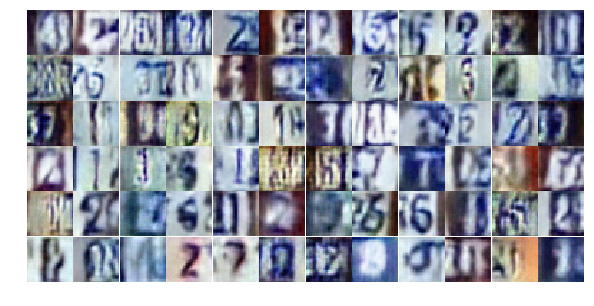

Epoch 8/25... Discriminator Loss: 0.4508... Generator Loss: 1.9214
Epoch 8/25... Discriminator Loss: 0.4810... Generator Loss: 1.3084
Epoch 8/25... Discriminator Loss: 0.6866... Generator Loss: 0.9983
Epoch 8/25... Discriminator Loss: 0.4647... Generator Loss: 1.6009
Epoch 8/25... Discriminator Loss: 0.7981... Generator Loss: 0.8376
Epoch 8/25... Discriminator Loss: 0.9516... Generator Loss: 2.0032
Epoch 8/25... Discriminator Loss: 0.4482... Generator Loss: 2.0477
Epoch 8/25... Discriminator Loss: 0.7234... Generator Loss: 0.9868
Epoch 8/25... Discriminator Loss: 0.6690... Generator Loss: 1.0717
Epoch 8/25... Discriminator Loss: 0.8634... Generator Loss: 0.9693


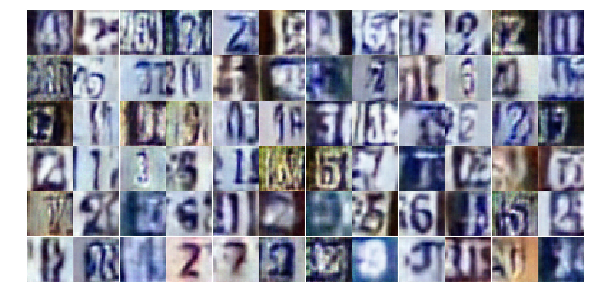

Epoch 8/25... Discriminator Loss: 0.4172... Generator Loss: 1.5855
Epoch 8/25... Discriminator Loss: 0.5594... Generator Loss: 1.1750
Epoch 8/25... Discriminator Loss: 0.8354... Generator Loss: 0.7843
Epoch 8/25... Discriminator Loss: 1.1807... Generator Loss: 3.1206
Epoch 8/25... Discriminator Loss: 0.4621... Generator Loss: 2.1671
Epoch 8/25... Discriminator Loss: 0.6570... Generator Loss: 1.2511
Epoch 8/25... Discriminator Loss: 0.5955... Generator Loss: 1.2464
Epoch 8/25... Discriminator Loss: 0.9578... Generator Loss: 0.7079
Epoch 8/25... Discriminator Loss: 0.6776... Generator Loss: 1.6199
Epoch 8/25... Discriminator Loss: 0.5313... Generator Loss: 1.2781


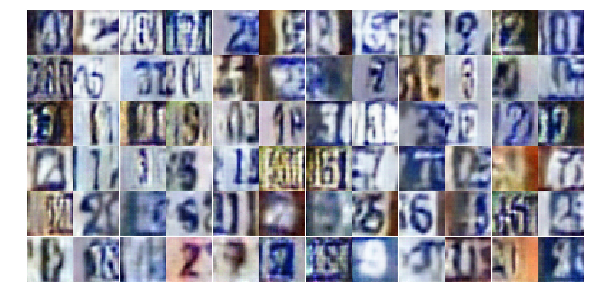

Epoch 8/25... Discriminator Loss: 0.6806... Generator Loss: 1.2129
Epoch 8/25... Discriminator Loss: 0.4990... Generator Loss: 1.3362
Epoch 8/25... Discriminator Loss: 0.4404... Generator Loss: 1.5315
Epoch 8/25... Discriminator Loss: 0.6074... Generator Loss: 1.0910
Epoch 8/25... Discriminator Loss: 1.6324... Generator Loss: 0.3056
Epoch 8/25... Discriminator Loss: 0.7601... Generator Loss: 0.8725
Epoch 8/25... Discriminator Loss: 0.4488... Generator Loss: 1.5345
Epoch 8/25... Discriminator Loss: 0.4984... Generator Loss: 1.4257
Epoch 8/25... Discriminator Loss: 0.6522... Generator Loss: 1.2830
Epoch 8/25... Discriminator Loss: 0.4643... Generator Loss: 1.4072


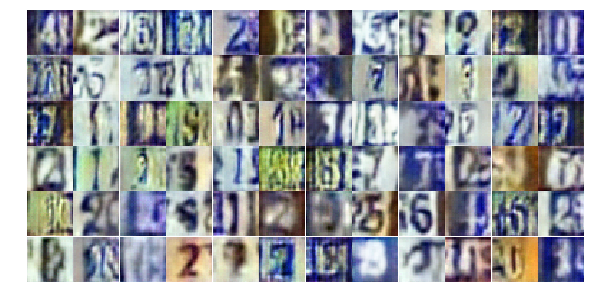

Epoch 8/25... Discriminator Loss: 0.3964... Generator Loss: 1.5466
Epoch 8/25... Discriminator Loss: 1.2248... Generator Loss: 0.4902
Epoch 8/25... Discriminator Loss: 1.5506... Generator Loss: 0.3889
Epoch 8/25... Discriminator Loss: 0.7450... Generator Loss: 1.7619
Epoch 8/25... Discriminator Loss: 0.8756... Generator Loss: 2.4804
Epoch 8/25... Discriminator Loss: 0.9922... Generator Loss: 0.6337
Epoch 8/25... Discriminator Loss: 0.3990... Generator Loss: 1.7102
Epoch 8/25... Discriminator Loss: 0.5374... Generator Loss: 1.2802
Epoch 8/25... Discriminator Loss: 0.6672... Generator Loss: 1.3042
Epoch 8/25... Discriminator Loss: 0.5970... Generator Loss: 1.4213


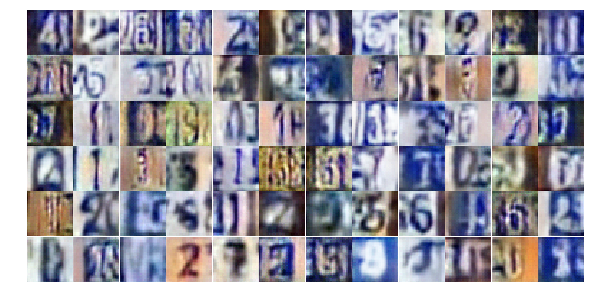

Epoch 8/25... Discriminator Loss: 0.6793... Generator Loss: 1.0250
Epoch 8/25... Discriminator Loss: 0.4061... Generator Loss: 1.6473
Epoch 8/25... Discriminator Loss: 0.4137... Generator Loss: 1.7527
Epoch 8/25... Discriminator Loss: 0.9949... Generator Loss: 0.5870
Epoch 8/25... Discriminator Loss: 0.4812... Generator Loss: 2.3778
Epoch 8/25... Discriminator Loss: 0.9894... Generator Loss: 0.6246
Epoch 8/25... Discriminator Loss: 0.5535... Generator Loss: 1.1285
Epoch 8/25... Discriminator Loss: 0.4536... Generator Loss: 1.6042
Epoch 9/25... Discriminator Loss: 1.4021... Generator Loss: 0.3527
Epoch 9/25... Discriminator Loss: 0.8290... Generator Loss: 0.7686


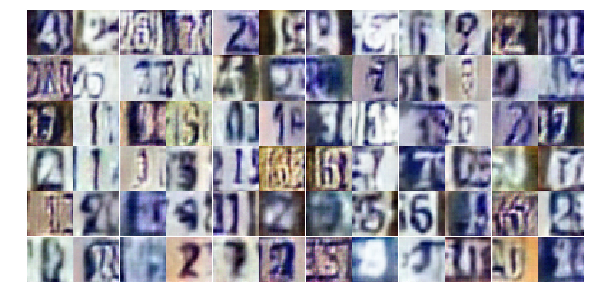

Epoch 9/25... Discriminator Loss: 0.7724... Generator Loss: 0.8445
Epoch 9/25... Discriminator Loss: 0.7002... Generator Loss: 2.6878
Epoch 9/25... Discriminator Loss: 1.1075... Generator Loss: 0.6108
Epoch 9/25... Discriminator Loss: 0.5776... Generator Loss: 1.1075
Epoch 9/25... Discriminator Loss: 1.1293... Generator Loss: 0.5254
Epoch 9/25... Discriminator Loss: 0.6098... Generator Loss: 1.2319
Epoch 9/25... Discriminator Loss: 0.6721... Generator Loss: 1.3657
Epoch 9/25... Discriminator Loss: 0.5036... Generator Loss: 1.2452
Epoch 9/25... Discriminator Loss: 0.7280... Generator Loss: 0.9404
Epoch 9/25... Discriminator Loss: 0.5803... Generator Loss: 1.1617


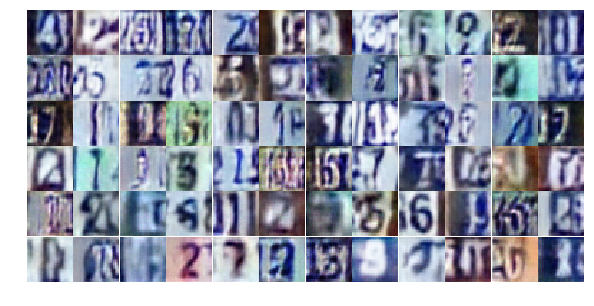

Epoch 9/25... Discriminator Loss: 0.8421... Generator Loss: 0.7860
Epoch 9/25... Discriminator Loss: 1.7898... Generator Loss: 2.2728
Epoch 9/25... Discriminator Loss: 1.0147... Generator Loss: 0.7556
Epoch 9/25... Discriminator Loss: 0.7891... Generator Loss: 0.8470
Epoch 9/25... Discriminator Loss: 0.4168... Generator Loss: 1.5739
Epoch 9/25... Discriminator Loss: 0.5675... Generator Loss: 1.3074
Epoch 9/25... Discriminator Loss: 0.5943... Generator Loss: 1.0768
Epoch 9/25... Discriminator Loss: 0.4519... Generator Loss: 1.4324
Epoch 9/25... Discriminator Loss: 1.1372... Generator Loss: 0.5678
Epoch 9/25... Discriminator Loss: 1.0077... Generator Loss: 0.6151


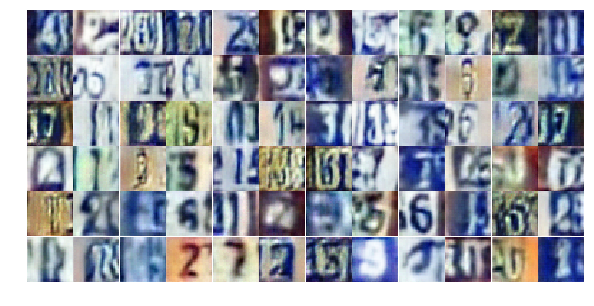

Epoch 9/25... Discriminator Loss: 1.0135... Generator Loss: 0.6328
Epoch 9/25... Discriminator Loss: 0.6121... Generator Loss: 1.5436
Epoch 9/25... Discriminator Loss: 0.5158... Generator Loss: 1.6902
Epoch 9/25... Discriminator Loss: 0.6240... Generator Loss: 1.2127
Epoch 9/25... Discriminator Loss: 0.8233... Generator Loss: 2.1316
Epoch 9/25... Discriminator Loss: 0.5628... Generator Loss: 1.3174
Epoch 9/25... Discriminator Loss: 0.5648... Generator Loss: 1.7018
Epoch 9/25... Discriminator Loss: 0.4740... Generator Loss: 1.8933
Epoch 9/25... Discriminator Loss: 0.5885... Generator Loss: 1.0818
Epoch 9/25... Discriminator Loss: 0.4489... Generator Loss: 1.4011


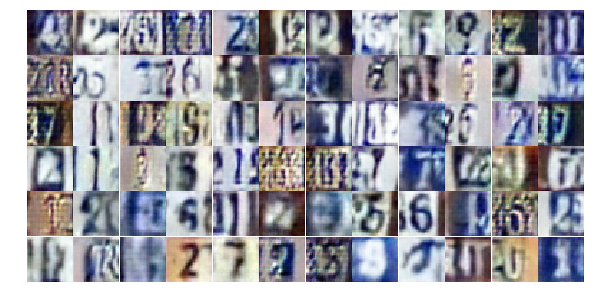

Epoch 9/25... Discriminator Loss: 0.5852... Generator Loss: 1.1418
Epoch 9/25... Discriminator Loss: 0.6790... Generator Loss: 1.0430
Epoch 9/25... Discriminator Loss: 1.2304... Generator Loss: 0.4724
Epoch 9/25... Discriminator Loss: 0.5645... Generator Loss: 1.9371
Epoch 9/25... Discriminator Loss: 0.5278... Generator Loss: 1.3237
Epoch 9/25... Discriminator Loss: 0.6970... Generator Loss: 0.9919
Epoch 9/25... Discriminator Loss: 0.6121... Generator Loss: 1.1333
Epoch 9/25... Discriminator Loss: 0.4462... Generator Loss: 1.3348
Epoch 9/25... Discriminator Loss: 0.8893... Generator Loss: 0.7625
Epoch 9/25... Discriminator Loss: 0.8880... Generator Loss: 0.7208


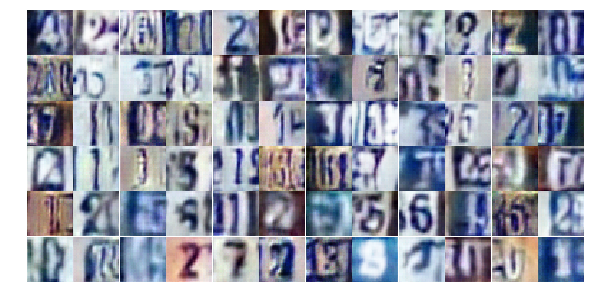

Epoch 9/25... Discriminator Loss: 0.5676... Generator Loss: 1.2240
Epoch 9/25... Discriminator Loss: 0.5835... Generator Loss: 1.1413
Epoch 9/25... Discriminator Loss: 1.6220... Generator Loss: 3.4129
Epoch 9/25... Discriminator Loss: 0.8985... Generator Loss: 0.9658
Epoch 9/25... Discriminator Loss: 0.4859... Generator Loss: 1.4828
Epoch 9/25... Discriminator Loss: 0.6340... Generator Loss: 1.2394
Epoch 9/25... Discriminator Loss: 0.6795... Generator Loss: 1.1053
Epoch 9/25... Discriminator Loss: 0.5836... Generator Loss: 1.0327
Epoch 9/25... Discriminator Loss: 0.4982... Generator Loss: 1.8176
Epoch 9/25... Discriminator Loss: 0.4373... Generator Loss: 1.9121


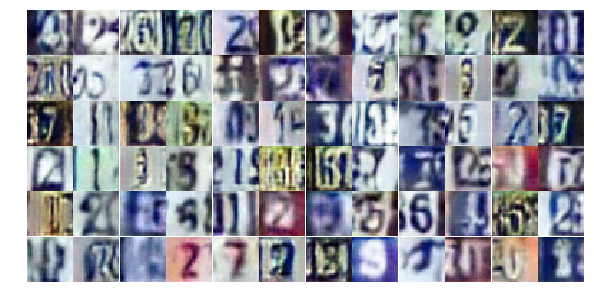

Epoch 9/25... Discriminator Loss: 0.9980... Generator Loss: 0.6540
Epoch 9/25... Discriminator Loss: 1.0698... Generator Loss: 3.4559
Epoch 9/25... Discriminator Loss: 1.2750... Generator Loss: 0.4691
Epoch 9/25... Discriminator Loss: 0.9749... Generator Loss: 0.6527
Epoch 9/25... Discriminator Loss: 0.6436... Generator Loss: 1.0744
Epoch 10/25... Discriminator Loss: 0.4768... Generator Loss: 1.9466
Epoch 10/25... Discriminator Loss: 0.4169... Generator Loss: 1.8142
Epoch 10/25... Discriminator Loss: 1.2694... Generator Loss: 0.4555
Epoch 10/25... Discriminator Loss: 0.9186... Generator Loss: 2.3721
Epoch 10/25... Discriminator Loss: 1.0529... Generator Loss: 0.6024


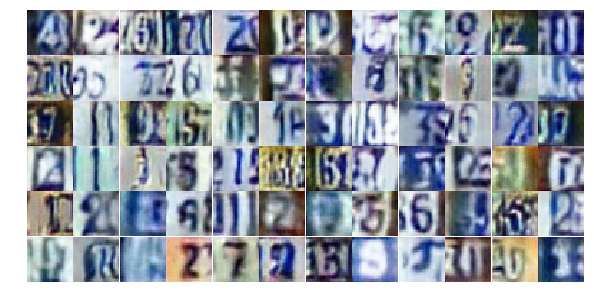

Epoch 10/25... Discriminator Loss: 0.9290... Generator Loss: 0.6652
Epoch 10/25... Discriminator Loss: 0.5729... Generator Loss: 1.2051
Epoch 10/25... Discriminator Loss: 0.6267... Generator Loss: 1.1920
Epoch 10/25... Discriminator Loss: 0.5993... Generator Loss: 1.2824
Epoch 10/25... Discriminator Loss: 0.6412... Generator Loss: 1.6224
Epoch 10/25... Discriminator Loss: 0.6954... Generator Loss: 1.0530
Epoch 10/25... Discriminator Loss: 0.7152... Generator Loss: 0.9475
Epoch 10/25... Discriminator Loss: 1.1541... Generator Loss: 0.5451
Epoch 10/25... Discriminator Loss: 1.0013... Generator Loss: 0.6134
Epoch 10/25... Discriminator Loss: 0.6720... Generator Loss: 1.1949


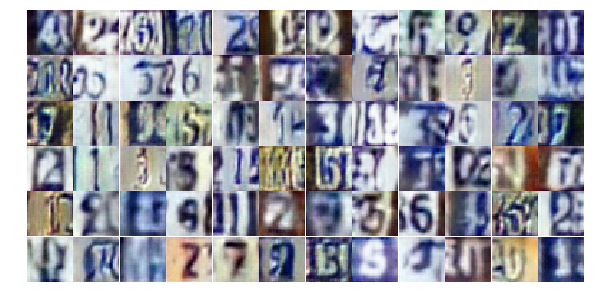

Epoch 10/25... Discriminator Loss: 0.6971... Generator Loss: 1.3348
Epoch 10/25... Discriminator Loss: 0.6443... Generator Loss: 1.0368
Epoch 10/25... Discriminator Loss: 0.4161... Generator Loss: 1.5163
Epoch 10/25... Discriminator Loss: 0.7117... Generator Loss: 0.9621
Epoch 10/25... Discriminator Loss: 0.7492... Generator Loss: 1.5029
Epoch 10/25... Discriminator Loss: 0.7063... Generator Loss: 0.9604
Epoch 10/25... Discriminator Loss: 0.6140... Generator Loss: 1.1710
Epoch 10/25... Discriminator Loss: 0.4986... Generator Loss: 1.8543
Epoch 10/25... Discriminator Loss: 0.6766... Generator Loss: 0.9599
Epoch 10/25... Discriminator Loss: 0.6637... Generator Loss: 3.5248


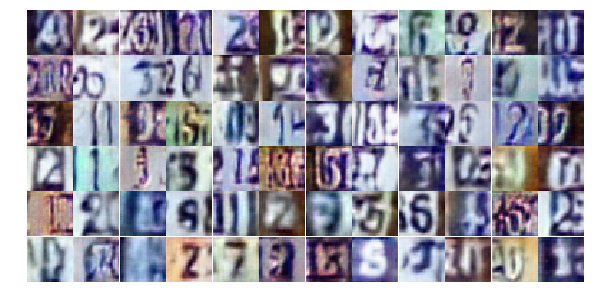

Epoch 10/25... Discriminator Loss: 1.5151... Generator Loss: 0.3786
Epoch 10/25... Discriminator Loss: 0.8246... Generator Loss: 1.4959
Epoch 10/25... Discriminator Loss: 0.6034... Generator Loss: 1.3776
Epoch 10/25... Discriminator Loss: 0.4954... Generator Loss: 1.5907
Epoch 10/25... Discriminator Loss: 1.1691... Generator Loss: 0.4883
Epoch 10/25... Discriminator Loss: 0.6403... Generator Loss: 1.0526
Epoch 10/25... Discriminator Loss: 0.3678... Generator Loss: 1.8234
Epoch 10/25... Discriminator Loss: 0.7301... Generator Loss: 0.9352
Epoch 10/25... Discriminator Loss: 0.8843... Generator Loss: 0.7601
Epoch 10/25... Discriminator Loss: 0.8694... Generator Loss: 0.7181


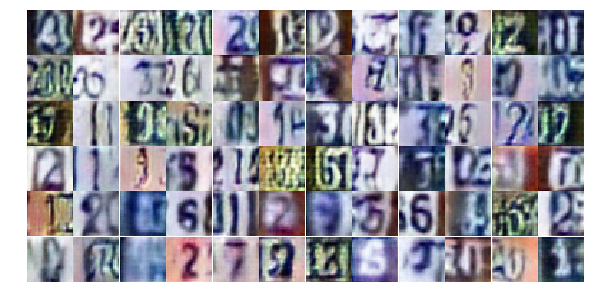

Epoch 10/25... Discriminator Loss: 0.5642... Generator Loss: 1.4431
Epoch 10/25... Discriminator Loss: 0.8707... Generator Loss: 0.7437
Epoch 10/25... Discriminator Loss: 0.3884... Generator Loss: 1.8428
Epoch 10/25... Discriminator Loss: 0.6489... Generator Loss: 2.5961
Epoch 10/25... Discriminator Loss: 0.7079... Generator Loss: 1.1736
Epoch 10/25... Discriminator Loss: 1.1461... Generator Loss: 0.6057
Epoch 10/25... Discriminator Loss: 0.7534... Generator Loss: 0.8607
Epoch 10/25... Discriminator Loss: 1.2133... Generator Loss: 0.5248
Epoch 10/25... Discriminator Loss: 0.6703... Generator Loss: 0.9860
Epoch 10/25... Discriminator Loss: 1.5947... Generator Loss: 0.3245


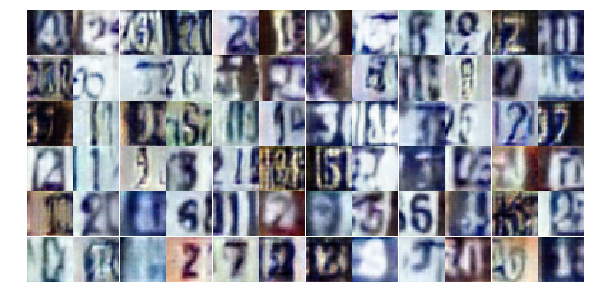

Epoch 10/25... Discriminator Loss: 0.8721... Generator Loss: 0.8240
Epoch 10/25... Discriminator Loss: 0.7278... Generator Loss: 1.0811
Epoch 10/25... Discriminator Loss: 0.4773... Generator Loss: 1.4232
Epoch 10/25... Discriminator Loss: 0.6476... Generator Loss: 1.4264
Epoch 10/25... Discriminator Loss: 0.5488... Generator Loss: 1.4107
Epoch 10/25... Discriminator Loss: 0.5968... Generator Loss: 2.0898
Epoch 10/25... Discriminator Loss: 0.5806... Generator Loss: 1.1752
Epoch 10/25... Discriminator Loss: 0.4572... Generator Loss: 1.3623
Epoch 10/25... Discriminator Loss: 0.6161... Generator Loss: 2.8079
Epoch 10/25... Discriminator Loss: 0.5914... Generator Loss: 1.2658


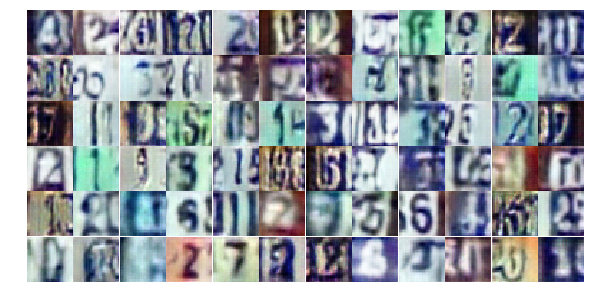

Epoch 10/25... Discriminator Loss: 0.6941... Generator Loss: 1.0983
Epoch 10/25... Discriminator Loss: 0.4866... Generator Loss: 1.4068
Epoch 10/25... Discriminator Loss: 0.5708... Generator Loss: 1.1545
Epoch 11/25... Discriminator Loss: 0.6439... Generator Loss: 1.3702
Epoch 11/25... Discriminator Loss: 0.3736... Generator Loss: 2.1927
Epoch 11/25... Discriminator Loss: 1.4978... Generator Loss: 0.3265
Epoch 11/25... Discriminator Loss: 1.5812... Generator Loss: 0.3839
Epoch 11/25... Discriminator Loss: 2.1429... Generator Loss: 0.2277
Epoch 11/25... Discriminator Loss: 2.1606... Generator Loss: 1.8257
Epoch 11/25... Discriminator Loss: 0.4734... Generator Loss: 1.7394


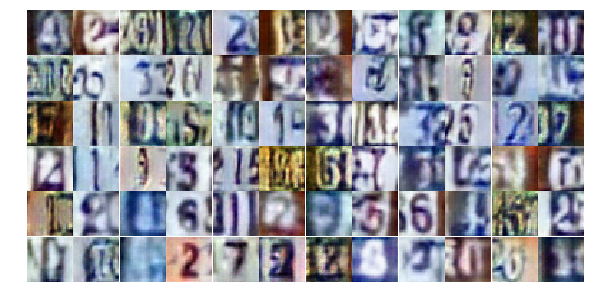

Epoch 11/25... Discriminator Loss: 0.4805... Generator Loss: 1.2019
Epoch 11/25... Discriminator Loss: 0.8661... Generator Loss: 0.8848
Epoch 11/25... Discriminator Loss: 0.4854... Generator Loss: 1.4839
Epoch 11/25... Discriminator Loss: 0.7291... Generator Loss: 0.9903
Epoch 11/25... Discriminator Loss: 0.7723... Generator Loss: 0.9175
Epoch 11/25... Discriminator Loss: 0.4435... Generator Loss: 1.8146
Epoch 11/25... Discriminator Loss: 0.7253... Generator Loss: 1.0284
Epoch 11/25... Discriminator Loss: 0.4111... Generator Loss: 1.8346
Epoch 11/25... Discriminator Loss: 0.7067... Generator Loss: 0.8887
Epoch 11/25... Discriminator Loss: 1.4895... Generator Loss: 0.4120


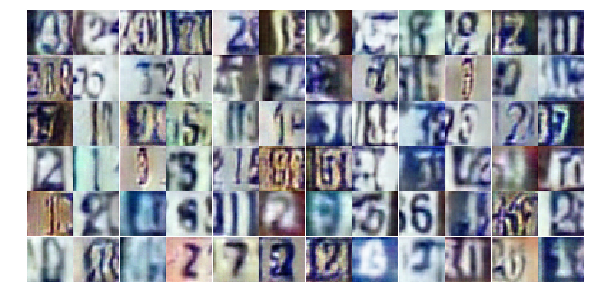

Epoch 11/25... Discriminator Loss: 0.6032... Generator Loss: 1.1289
Epoch 11/25... Discriminator Loss: 0.3546... Generator Loss: 1.8186
Epoch 11/25... Discriminator Loss: 0.8534... Generator Loss: 0.7796
Epoch 11/25... Discriminator Loss: 0.5887... Generator Loss: 1.1025
Epoch 11/25... Discriminator Loss: 0.3656... Generator Loss: 1.9987
Epoch 11/25... Discriminator Loss: 0.5392... Generator Loss: 1.4845
Epoch 11/25... Discriminator Loss: 0.5386... Generator Loss: 1.5318
Epoch 11/25... Discriminator Loss: 1.0945... Generator Loss: 0.5724
Epoch 11/25... Discriminator Loss: 0.4450... Generator Loss: 1.6979
Epoch 11/25... Discriminator Loss: 0.6558... Generator Loss: 1.0620


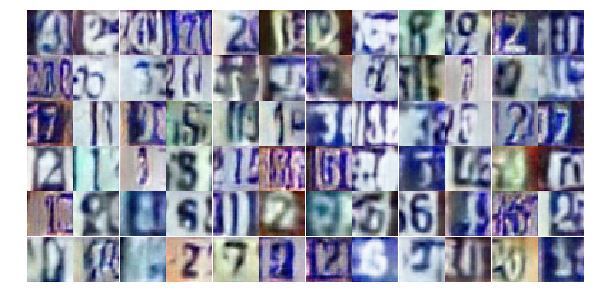

Epoch 11/25... Discriminator Loss: 0.5824... Generator Loss: 1.3564
Epoch 11/25... Discriminator Loss: 0.6864... Generator Loss: 1.0106
Epoch 11/25... Discriminator Loss: 0.7475... Generator Loss: 1.0514
Epoch 11/25... Discriminator Loss: 0.5477... Generator Loss: 1.3005
Epoch 11/25... Discriminator Loss: 0.9401... Generator Loss: 0.6401
Epoch 11/25... Discriminator Loss: 0.9462... Generator Loss: 0.7033
Epoch 11/25... Discriminator Loss: 1.1088... Generator Loss: 0.6629
Epoch 11/25... Discriminator Loss: 0.9436... Generator Loss: 0.7222
Epoch 11/25... Discriminator Loss: 0.6974... Generator Loss: 0.9631
Epoch 11/25... Discriminator Loss: 1.1041... Generator Loss: 0.5846


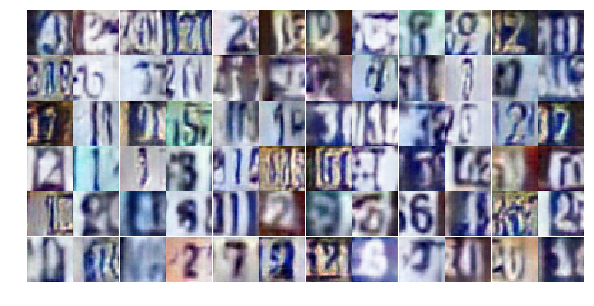

Epoch 11/25... Discriminator Loss: 0.4553... Generator Loss: 1.5511
Epoch 11/25... Discriminator Loss: 0.4930... Generator Loss: 1.3561
Epoch 11/25... Discriminator Loss: 0.6017... Generator Loss: 1.0676
Epoch 11/25... Discriminator Loss: 0.6729... Generator Loss: 1.0284
Epoch 11/25... Discriminator Loss: 1.2608... Generator Loss: 0.4610
Epoch 11/25... Discriminator Loss: 0.5721... Generator Loss: 1.2448
Epoch 11/25... Discriminator Loss: 0.3149... Generator Loss: 1.9407
Epoch 11/25... Discriminator Loss: 0.7856... Generator Loss: 0.8805
Epoch 11/25... Discriminator Loss: 1.2284... Generator Loss: 0.5133
Epoch 11/25... Discriminator Loss: 0.3650... Generator Loss: 1.7230


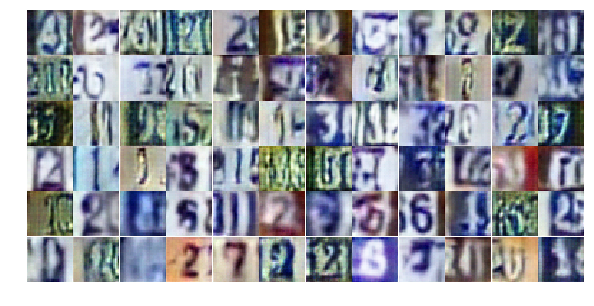

Epoch 11/25... Discriminator Loss: 0.5472... Generator Loss: 1.2664
Epoch 11/25... Discriminator Loss: 0.3464... Generator Loss: 1.8677
Epoch 11/25... Discriminator Loss: 0.5688... Generator Loss: 1.2512
Epoch 11/25... Discriminator Loss: 0.9167... Generator Loss: 0.7079
Epoch 11/25... Discriminator Loss: 0.9221... Generator Loss: 0.7048
Epoch 11/25... Discriminator Loss: 0.6695... Generator Loss: 1.0380
Epoch 11/25... Discriminator Loss: 1.6057... Generator Loss: 3.0729
Epoch 11/25... Discriminator Loss: 0.7658... Generator Loss: 2.3292
Epoch 11/25... Discriminator Loss: 0.9001... Generator Loss: 0.7979
Epoch 11/25... Discriminator Loss: 0.7390... Generator Loss: 0.9361


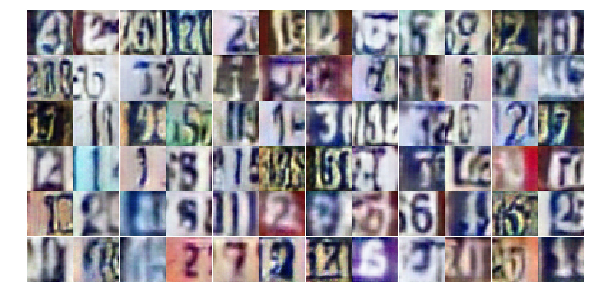

Epoch 12/25... Discriminator Loss: 0.5537... Generator Loss: 1.5612
Epoch 12/25... Discriminator Loss: 0.5955... Generator Loss: 1.8438
Epoch 12/25... Discriminator Loss: 0.8941... Generator Loss: 0.7395
Epoch 12/25... Discriminator Loss: 0.6574... Generator Loss: 1.2296
Epoch 12/25... Discriminator Loss: 0.4682... Generator Loss: 1.4266
Epoch 12/25... Discriminator Loss: 0.7926... Generator Loss: 0.8936
Epoch 12/25... Discriminator Loss: 0.5390... Generator Loss: 1.4892
Epoch 12/25... Discriminator Loss: 0.4165... Generator Loss: 1.9897
Epoch 12/25... Discriminator Loss: 0.7034... Generator Loss: 1.2212
Epoch 12/25... Discriminator Loss: 1.1678... Generator Loss: 0.5744


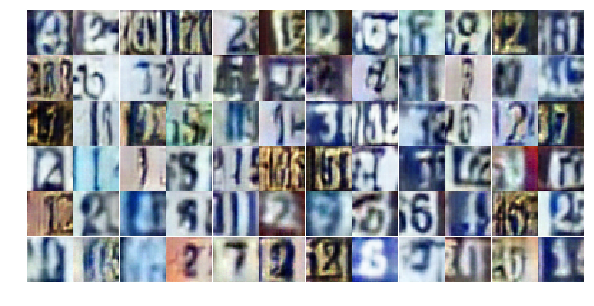

Epoch 12/25... Discriminator Loss: 0.5314... Generator Loss: 1.2898
Epoch 12/25... Discriminator Loss: 0.7996... Generator Loss: 0.8279
Epoch 12/25... Discriminator Loss: 0.5597... Generator Loss: 1.5910
Epoch 12/25... Discriminator Loss: 0.5198... Generator Loss: 1.6365
Epoch 12/25... Discriminator Loss: 0.5313... Generator Loss: 2.3071
Epoch 12/25... Discriminator Loss: 1.2190... Generator Loss: 0.5789
Epoch 12/25... Discriminator Loss: 1.8557... Generator Loss: 0.2337
Epoch 12/25... Discriminator Loss: 0.4120... Generator Loss: 1.9653
Epoch 12/25... Discriminator Loss: 0.8159... Generator Loss: 0.7858
Epoch 12/25... Discriminator Loss: 0.7590... Generator Loss: 1.0890


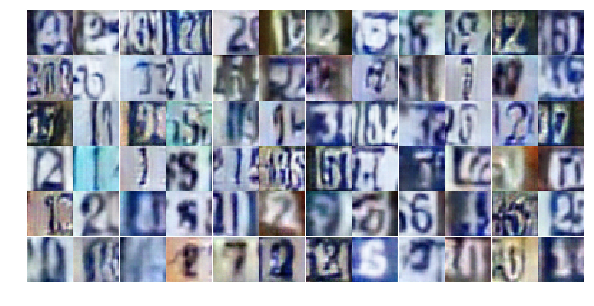

Epoch 12/25... Discriminator Loss: 0.3595... Generator Loss: 1.6082
Epoch 12/25... Discriminator Loss: 0.4562... Generator Loss: 1.4974
Epoch 12/25... Discriminator Loss: 0.6757... Generator Loss: 1.0311
Epoch 12/25... Discriminator Loss: 0.4051... Generator Loss: 1.6960
Epoch 12/25... Discriminator Loss: 0.3782... Generator Loss: 1.6671
Epoch 12/25... Discriminator Loss: 0.6988... Generator Loss: 1.2836
Epoch 12/25... Discriminator Loss: 0.7360... Generator Loss: 1.0851
Epoch 12/25... Discriminator Loss: 0.3313... Generator Loss: 1.7432
Epoch 12/25... Discriminator Loss: 0.3892... Generator Loss: 1.5698
Epoch 12/25... Discriminator Loss: 0.4975... Generator Loss: 1.4847


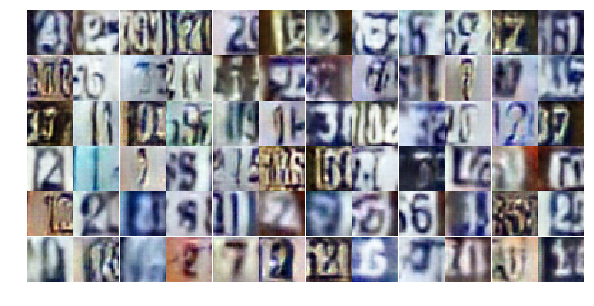

Epoch 12/25... Discriminator Loss: 0.6994... Generator Loss: 1.0047
Epoch 12/25... Discriminator Loss: 0.3956... Generator Loss: 1.7847
Epoch 12/25... Discriminator Loss: 0.8767... Generator Loss: 0.7484
Epoch 12/25... Discriminator Loss: 1.7940... Generator Loss: 0.2470
Epoch 12/25... Discriminator Loss: 1.0661... Generator Loss: 2.4310
Epoch 12/25... Discriminator Loss: 0.7900... Generator Loss: 1.8913
Epoch 12/25... Discriminator Loss: 0.9009... Generator Loss: 0.7888
Epoch 12/25... Discriminator Loss: 0.8512... Generator Loss: 0.9534
Epoch 12/25... Discriminator Loss: 0.4755... Generator Loss: 1.6202
Epoch 12/25... Discriminator Loss: 0.3585... Generator Loss: 1.7612


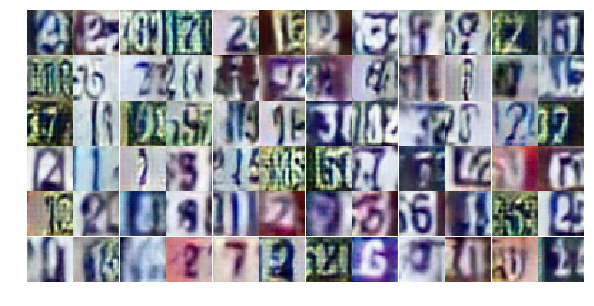

Epoch 12/25... Discriminator Loss: 1.0112... Generator Loss: 0.6453
Epoch 12/25... Discriminator Loss: 0.3808... Generator Loss: 1.5346
Epoch 12/25... Discriminator Loss: 0.4227... Generator Loss: 1.4502
Epoch 12/25... Discriminator Loss: 0.5657... Generator Loss: 1.4444
Epoch 12/25... Discriminator Loss: 0.8306... Generator Loss: 0.8070
Epoch 12/25... Discriminator Loss: 0.9093... Generator Loss: 0.7580
Epoch 12/25... Discriminator Loss: 0.8164... Generator Loss: 0.8796
Epoch 12/25... Discriminator Loss: 0.7441... Generator Loss: 0.8657
Epoch 12/25... Discriminator Loss: 0.4241... Generator Loss: 1.5931
Epoch 12/25... Discriminator Loss: 0.7202... Generator Loss: 0.9255


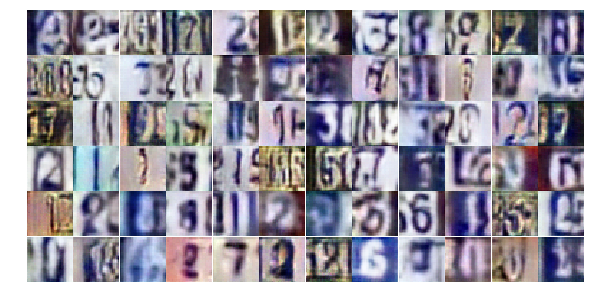

Epoch 12/25... Discriminator Loss: 1.0265... Generator Loss: 0.7028
Epoch 12/25... Discriminator Loss: 0.6074... Generator Loss: 1.0704
Epoch 12/25... Discriminator Loss: 1.2038... Generator Loss: 2.7756
Epoch 12/25... Discriminator Loss: 1.2106... Generator Loss: 0.4926
Epoch 12/25... Discriminator Loss: 0.6694... Generator Loss: 0.9212
Epoch 12/25... Discriminator Loss: 1.1384... Generator Loss: 2.8608
Epoch 12/25... Discriminator Loss: 1.1014... Generator Loss: 0.5664
Epoch 13/25... Discriminator Loss: 0.4681... Generator Loss: 1.4886
Epoch 13/25... Discriminator Loss: 0.5103... Generator Loss: 1.3229
Epoch 13/25... Discriminator Loss: 0.6962... Generator Loss: 0.9927


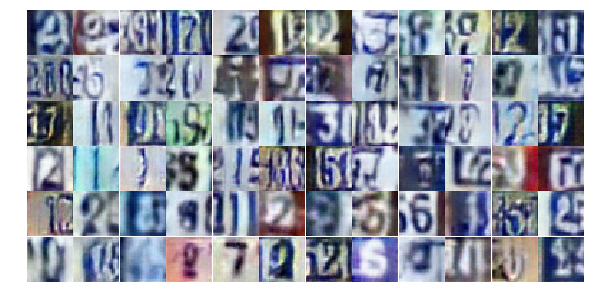

Epoch 13/25... Discriminator Loss: 0.4422... Generator Loss: 1.7410
Epoch 13/25... Discriminator Loss: 0.6128... Generator Loss: 1.5402
Epoch 13/25... Discriminator Loss: 1.6680... Generator Loss: 0.2773
Epoch 13/25... Discriminator Loss: 3.5204... Generator Loss: 0.0525
Epoch 13/25... Discriminator Loss: 1.0570... Generator Loss: 0.6323
Epoch 13/25... Discriminator Loss: 0.6538... Generator Loss: 1.0778
Epoch 13/25... Discriminator Loss: 0.4633... Generator Loss: 1.6840
Epoch 13/25... Discriminator Loss: 0.8090... Generator Loss: 0.7932
Epoch 13/25... Discriminator Loss: 0.4674... Generator Loss: 1.3199
Epoch 13/25... Discriminator Loss: 0.5822... Generator Loss: 1.2132


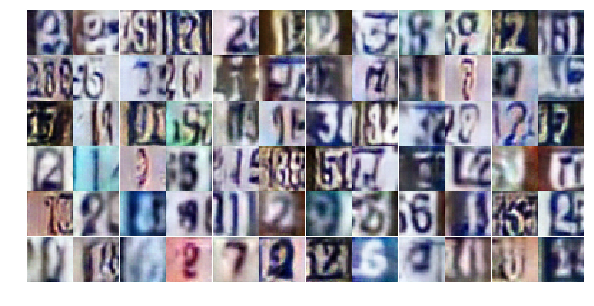

Epoch 13/25... Discriminator Loss: 0.7431... Generator Loss: 0.8706
Epoch 13/25... Discriminator Loss: 0.4318... Generator Loss: 1.6174
Epoch 13/25... Discriminator Loss: 0.9351... Generator Loss: 0.8568
Epoch 13/25... Discriminator Loss: 0.6979... Generator Loss: 1.1351
Epoch 13/25... Discriminator Loss: 0.5396... Generator Loss: 1.2714
Epoch 13/25... Discriminator Loss: 0.8271... Generator Loss: 0.8137
Epoch 13/25... Discriminator Loss: 0.7327... Generator Loss: 0.9728
Epoch 13/25... Discriminator Loss: 0.9875... Generator Loss: 0.6563
Epoch 13/25... Discriminator Loss: 0.5676... Generator Loss: 1.3479
Epoch 13/25... Discriminator Loss: 1.1480... Generator Loss: 0.4851


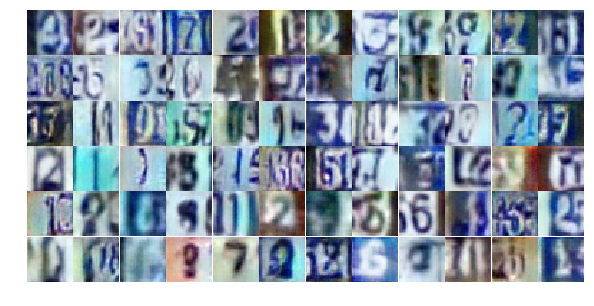

Epoch 13/25... Discriminator Loss: 0.8439... Generator Loss: 1.1959
Epoch 13/25... Discriminator Loss: 0.4931... Generator Loss: 1.5040
Epoch 13/25... Discriminator Loss: 0.5854... Generator Loss: 1.8467
Epoch 13/25... Discriminator Loss: 0.6443... Generator Loss: 1.0106
Epoch 13/25... Discriminator Loss: 0.5809... Generator Loss: 1.4010
Epoch 13/25... Discriminator Loss: 0.6126... Generator Loss: 1.0204
Epoch 13/25... Discriminator Loss: 0.7497... Generator Loss: 1.6214
Epoch 13/25... Discriminator Loss: 0.5198... Generator Loss: 1.2437
Epoch 13/25... Discriminator Loss: 0.4984... Generator Loss: 1.4405
Epoch 13/25... Discriminator Loss: 0.5770... Generator Loss: 1.3113


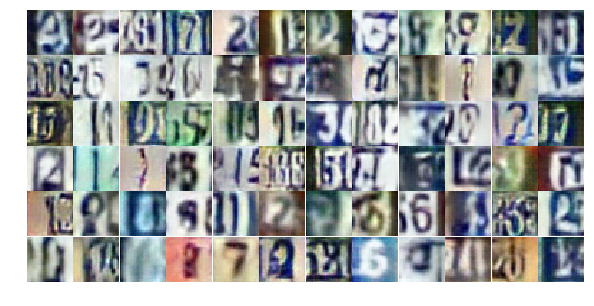

Epoch 13/25... Discriminator Loss: 1.2060... Generator Loss: 0.4823
Epoch 13/25... Discriminator Loss: 1.5658... Generator Loss: 3.1523
Epoch 13/25... Discriminator Loss: 0.8313... Generator Loss: 0.9127
Epoch 13/25... Discriminator Loss: 1.0667... Generator Loss: 0.6714
Epoch 13/25... Discriminator Loss: 0.5422... Generator Loss: 1.3235
Epoch 13/25... Discriminator Loss: 0.3939... Generator Loss: 1.6930
Epoch 13/25... Discriminator Loss: 0.4619... Generator Loss: 1.3331
Epoch 13/25... Discriminator Loss: 0.6280... Generator Loss: 1.2252
Epoch 13/25... Discriminator Loss: 0.5804... Generator Loss: 1.4115
Epoch 13/25... Discriminator Loss: 0.9714... Generator Loss: 0.7030


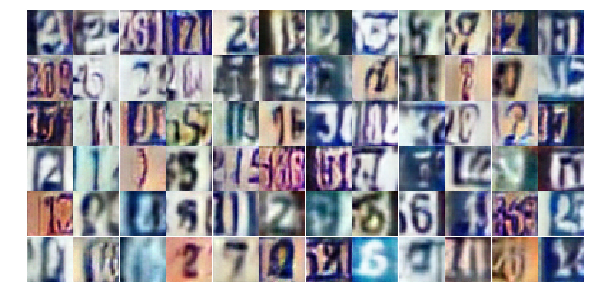

Epoch 13/25... Discriminator Loss: 0.8469... Generator Loss: 0.7574
Epoch 13/25... Discriminator Loss: 0.9667... Generator Loss: 2.2392
Epoch 13/25... Discriminator Loss: 0.8142... Generator Loss: 2.4325
Epoch 13/25... Discriminator Loss: 0.6360... Generator Loss: 1.2118
Epoch 13/25... Discriminator Loss: 1.0914... Generator Loss: 0.5700
Epoch 13/25... Discriminator Loss: 0.7064... Generator Loss: 0.9985
Epoch 13/25... Discriminator Loss: 0.7478... Generator Loss: 0.9103
Epoch 13/25... Discriminator Loss: 0.7483... Generator Loss: 0.8733
Epoch 13/25... Discriminator Loss: 1.5666... Generator Loss: 0.3192
Epoch 13/25... Discriminator Loss: 1.0671... Generator Loss: 0.6183


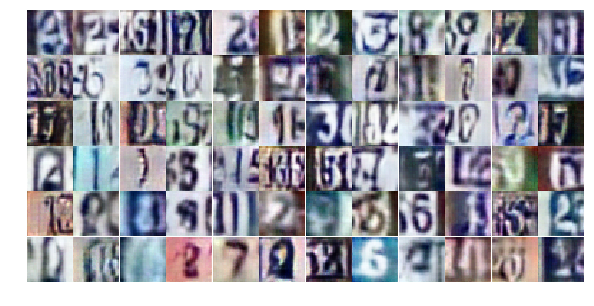

Epoch 13/25... Discriminator Loss: 0.3513... Generator Loss: 2.2891
Epoch 13/25... Discriminator Loss: 1.3698... Generator Loss: 0.4392
Epoch 13/25... Discriminator Loss: 0.5422... Generator Loss: 1.2630
Epoch 13/25... Discriminator Loss: 0.7172... Generator Loss: 0.9593
Epoch 14/25... Discriminator Loss: 0.7739... Generator Loss: 0.8735
Epoch 14/25... Discriminator Loss: 0.6714... Generator Loss: 1.1816
Epoch 14/25... Discriminator Loss: 0.7259... Generator Loss: 1.2185
Epoch 14/25... Discriminator Loss: 0.4447... Generator Loss: 2.0976
Epoch 14/25... Discriminator Loss: 0.5465... Generator Loss: 1.2767
Epoch 14/25... Discriminator Loss: 0.4794... Generator Loss: 1.3454


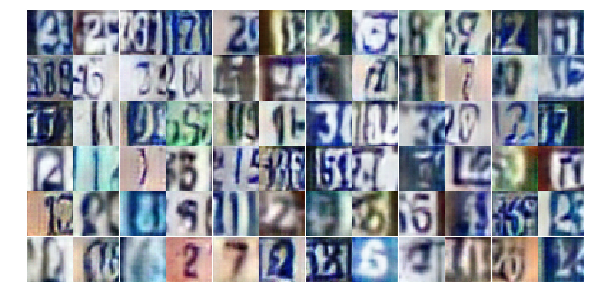

Epoch 14/25... Discriminator Loss: 0.8168... Generator Loss: 2.9704
Epoch 14/25... Discriminator Loss: 0.8389... Generator Loss: 0.7574
Epoch 14/25... Discriminator Loss: 0.7170... Generator Loss: 1.1967
Epoch 14/25... Discriminator Loss: 0.6699... Generator Loss: 1.0156
Epoch 14/25... Discriminator Loss: 1.0714... Generator Loss: 0.6407
Epoch 14/25... Discriminator Loss: 0.2606... Generator Loss: 2.2202
Epoch 14/25... Discriminator Loss: 0.3935... Generator Loss: 1.9231
Epoch 14/25... Discriminator Loss: 1.5545... Generator Loss: 0.3044
Epoch 14/25... Discriminator Loss: 0.7962... Generator Loss: 1.0567
Epoch 14/25... Discriminator Loss: 1.2751... Generator Loss: 0.4583


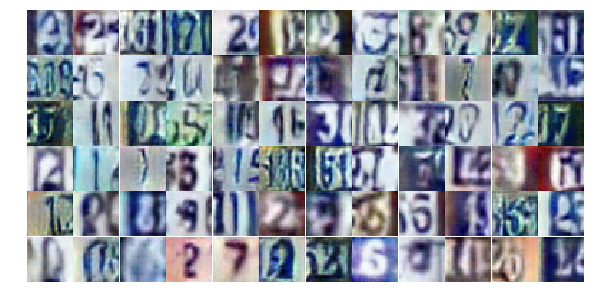

Epoch 14/25... Discriminator Loss: 0.4811... Generator Loss: 1.2371
Epoch 14/25... Discriminator Loss: 0.6040... Generator Loss: 1.8587
Epoch 14/25... Discriminator Loss: 0.8010... Generator Loss: 1.7566
Epoch 14/25... Discriminator Loss: 0.5565... Generator Loss: 1.3395
Epoch 14/25... Discriminator Loss: 0.7733... Generator Loss: 1.1450
Epoch 14/25... Discriminator Loss: 0.9082... Generator Loss: 0.7635
Epoch 14/25... Discriminator Loss: 0.6166... Generator Loss: 1.2120
Epoch 14/25... Discriminator Loss: 0.4095... Generator Loss: 1.5318
Epoch 14/25... Discriminator Loss: 0.6289... Generator Loss: 1.1687
Epoch 14/25... Discriminator Loss: 0.4843... Generator Loss: 1.4712


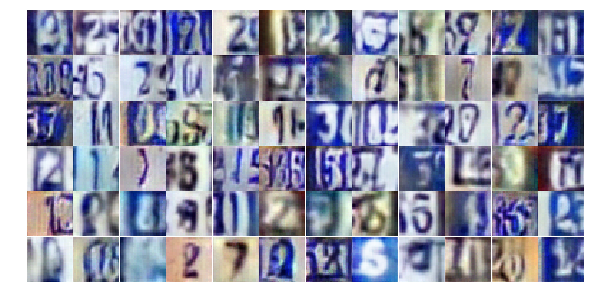

Epoch 14/25... Discriminator Loss: 1.5498... Generator Loss: 0.3359
Epoch 14/25... Discriminator Loss: 0.6334... Generator Loss: 0.9661
Epoch 14/25... Discriminator Loss: 0.4023... Generator Loss: 1.4513
Epoch 14/25... Discriminator Loss: 0.3510... Generator Loss: 1.6263
Epoch 14/25... Discriminator Loss: 0.8792... Generator Loss: 0.8922
Epoch 14/25... Discriminator Loss: 0.7850... Generator Loss: 0.9336
Epoch 14/25... Discriminator Loss: 0.6895... Generator Loss: 1.1842
Epoch 14/25... Discriminator Loss: 0.4145... Generator Loss: 1.6889
Epoch 14/25... Discriminator Loss: 0.2808... Generator Loss: 2.1895
Epoch 14/25... Discriminator Loss: 1.8821... Generator Loss: 2.7345


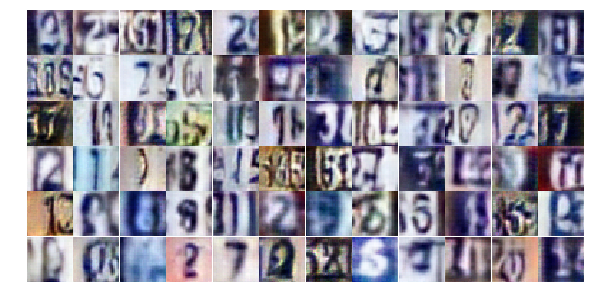

Epoch 14/25... Discriminator Loss: 1.1829... Generator Loss: 0.5430
Epoch 14/25... Discriminator Loss: 1.2251... Generator Loss: 0.5405
Epoch 14/25... Discriminator Loss: 0.7996... Generator Loss: 0.9960
Epoch 14/25... Discriminator Loss: 0.7879... Generator Loss: 0.8571
Epoch 14/25... Discriminator Loss: 1.0383... Generator Loss: 0.6891
Epoch 14/25... Discriminator Loss: 0.9183... Generator Loss: 0.7767
Epoch 14/25... Discriminator Loss: 0.6875... Generator Loss: 1.1075
Epoch 14/25... Discriminator Loss: 0.6254... Generator Loss: 1.1028
Epoch 14/25... Discriminator Loss: 2.0154... Generator Loss: 0.2099
Epoch 14/25... Discriminator Loss: 1.4784... Generator Loss: 0.4282


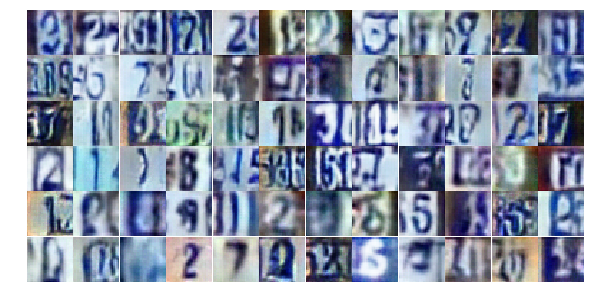

Epoch 14/25... Discriminator Loss: 0.9453... Generator Loss: 1.7971
Epoch 14/25... Discriminator Loss: 1.3429... Generator Loss: 0.4414
Epoch 14/25... Discriminator Loss: 0.6310... Generator Loss: 1.1397
Epoch 14/25... Discriminator Loss: 0.6750... Generator Loss: 1.0703
Epoch 14/25... Discriminator Loss: 0.6738... Generator Loss: 1.0938
Epoch 14/25... Discriminator Loss: 0.7634... Generator Loss: 0.8966
Epoch 14/25... Discriminator Loss: 0.6618... Generator Loss: 1.5750
Epoch 14/25... Discriminator Loss: 0.6561... Generator Loss: 1.2548
Epoch 14/25... Discriminator Loss: 1.2878... Generator Loss: 0.4409
Epoch 14/25... Discriminator Loss: 1.7606... Generator Loss: 0.2598


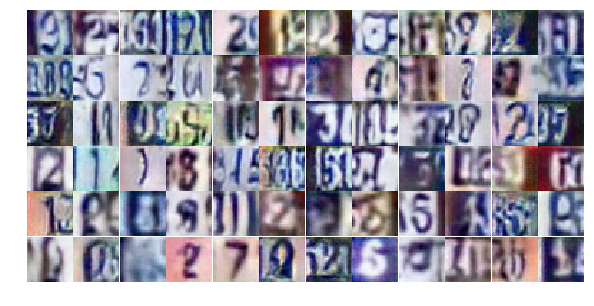

Epoch 14/25... Discriminator Loss: 1.7786... Generator Loss: 0.3246
Epoch 14/25... Discriminator Loss: 1.1939... Generator Loss: 0.5219
Epoch 15/25... Discriminator Loss: 0.7091... Generator Loss: 1.0435
Epoch 15/25... Discriminator Loss: 0.5366... Generator Loss: 1.4851
Epoch 15/25... Discriminator Loss: 0.7049... Generator Loss: 1.0094
Epoch 15/25... Discriminator Loss: 0.6629... Generator Loss: 1.0425
Epoch 15/25... Discriminator Loss: 0.5136... Generator Loss: 1.3892
Epoch 15/25... Discriminator Loss: 0.6845... Generator Loss: 1.2011
Epoch 15/25... Discriminator Loss: 1.1419... Generator Loss: 0.5139
Epoch 15/25... Discriminator Loss: 0.6689... Generator Loss: 1.0184


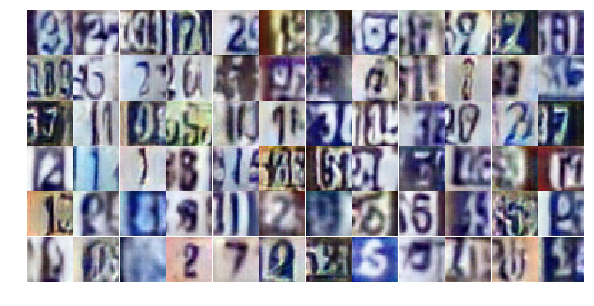

Epoch 15/25... Discriminator Loss: 0.7429... Generator Loss: 0.9609
Epoch 15/25... Discriminator Loss: 0.7956... Generator Loss: 0.9785
Epoch 15/25... Discriminator Loss: 0.8573... Generator Loss: 0.8185
Epoch 15/25... Discriminator Loss: 0.5217... Generator Loss: 1.2783
Epoch 15/25... Discriminator Loss: 0.7861... Generator Loss: 0.9469
Epoch 15/25... Discriminator Loss: 0.5440... Generator Loss: 1.3310
Epoch 15/25... Discriminator Loss: 1.1904... Generator Loss: 1.3837
Epoch 15/25... Discriminator Loss: 1.1076... Generator Loss: 2.3388
Epoch 15/25... Discriminator Loss: 0.5182... Generator Loss: 2.0831
Epoch 15/25... Discriminator Loss: 0.8389... Generator Loss: 0.8207


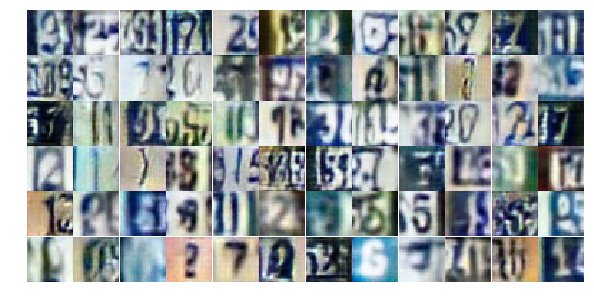

Epoch 15/25... Discriminator Loss: 0.7055... Generator Loss: 1.1592
Epoch 15/25... Discriminator Loss: 0.5472... Generator Loss: 1.5613
Epoch 15/25... Discriminator Loss: 0.6379... Generator Loss: 1.1420
Epoch 15/25... Discriminator Loss: 0.8033... Generator Loss: 0.8994
Epoch 15/25... Discriminator Loss: 1.3320... Generator Loss: 0.4406
Epoch 15/25... Discriminator Loss: 0.5438... Generator Loss: 1.5570
Epoch 15/25... Discriminator Loss: 0.9883... Generator Loss: 0.7180
Epoch 15/25... Discriminator Loss: 0.7715... Generator Loss: 0.9496
Epoch 15/25... Discriminator Loss: 0.8287... Generator Loss: 0.7889
Epoch 15/25... Discriminator Loss: 1.5970... Generator Loss: 0.3891


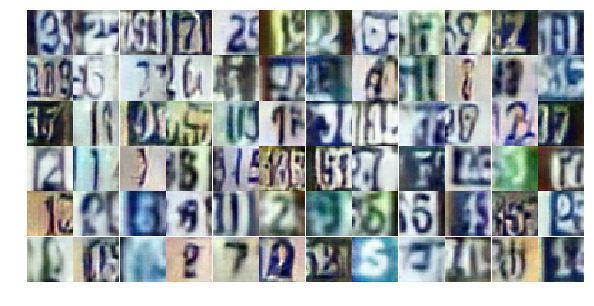

Epoch 15/25... Discriminator Loss: 0.7970... Generator Loss: 0.8896
Epoch 15/25... Discriminator Loss: 0.7558... Generator Loss: 0.9180
Epoch 15/25... Discriminator Loss: 0.5365... Generator Loss: 1.1542
Epoch 15/25... Discriminator Loss: 0.5361... Generator Loss: 1.4220
Epoch 15/25... Discriminator Loss: 0.6425... Generator Loss: 1.4467
Epoch 15/25... Discriminator Loss: 0.7401... Generator Loss: 1.1207
Epoch 15/25... Discriminator Loss: 0.4322... Generator Loss: 1.7378
Epoch 15/25... Discriminator Loss: 0.7371... Generator Loss: 1.0004
Epoch 15/25... Discriminator Loss: 0.4863... Generator Loss: 1.9851
Epoch 15/25... Discriminator Loss: 1.1543... Generator Loss: 0.5244


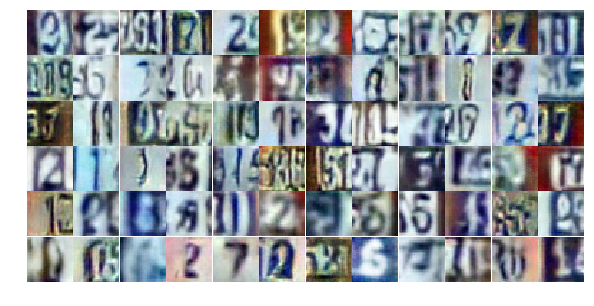

Epoch 15/25... Discriminator Loss: 0.7090... Generator Loss: 0.9943
Epoch 15/25... Discriminator Loss: 1.2973... Generator Loss: 0.4244
Epoch 15/25... Discriminator Loss: 0.8810... Generator Loss: 0.7863
Epoch 15/25... Discriminator Loss: 0.4704... Generator Loss: 1.6269
Epoch 15/25... Discriminator Loss: 0.5330... Generator Loss: 1.2312
Epoch 15/25... Discriminator Loss: 1.6659... Generator Loss: 0.3579
Epoch 15/25... Discriminator Loss: 1.1000... Generator Loss: 0.6278
Epoch 15/25... Discriminator Loss: 0.7176... Generator Loss: 1.0649
Epoch 15/25... Discriminator Loss: 0.8779... Generator Loss: 0.7679
Epoch 15/25... Discriminator Loss: 0.7892... Generator Loss: 1.0318


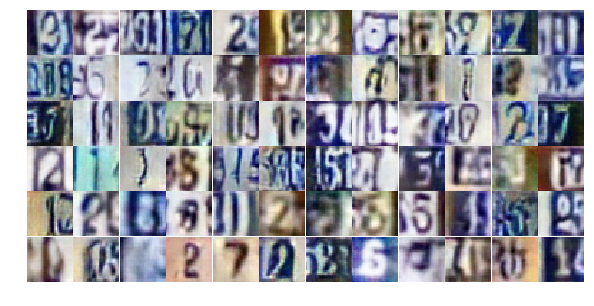

Epoch 15/25... Discriminator Loss: 0.7639... Generator Loss: 0.8602
Epoch 15/25... Discriminator Loss: 0.7365... Generator Loss: 1.0019
Epoch 15/25... Discriminator Loss: 0.7500... Generator Loss: 0.9220
Epoch 15/25... Discriminator Loss: 1.1686... Generator Loss: 0.5240
Epoch 15/25... Discriminator Loss: 0.4740... Generator Loss: 1.4544
Epoch 15/25... Discriminator Loss: 0.6768... Generator Loss: 1.7626
Epoch 15/25... Discriminator Loss: 0.8573... Generator Loss: 0.7571
Epoch 15/25... Discriminator Loss: 0.6433... Generator Loss: 1.1603
Epoch 15/25... Discriminator Loss: 1.8198... Generator Loss: 0.2591
Epoch 16/25... Discriminator Loss: 1.2755... Generator Loss: 0.4546


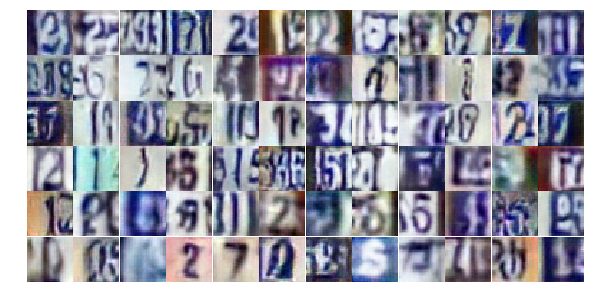

Epoch 16/25... Discriminator Loss: 0.6662... Generator Loss: 1.0992
Epoch 16/25... Discriminator Loss: 0.8773... Generator Loss: 1.9299
Epoch 16/25... Discriminator Loss: 1.1160... Generator Loss: 0.5837
Epoch 16/25... Discriminator Loss: 0.6805... Generator Loss: 1.0714
Epoch 16/25... Discriminator Loss: 0.4695... Generator Loss: 1.8765
Epoch 16/25... Discriminator Loss: 0.7747... Generator Loss: 0.9638
Epoch 16/25... Discriminator Loss: 1.7560... Generator Loss: 0.2528
Epoch 16/25... Discriminator Loss: 0.9840... Generator Loss: 0.6266
Epoch 16/25... Discriminator Loss: 0.9337... Generator Loss: 0.6928
Epoch 16/25... Discriminator Loss: 0.3978... Generator Loss: 1.6278


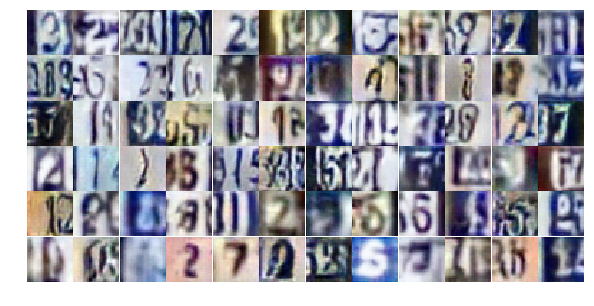

Epoch 16/25... Discriminator Loss: 1.7574... Generator Loss: 0.2960
Epoch 16/25... Discriminator Loss: 0.5350... Generator Loss: 1.3501
Epoch 16/25... Discriminator Loss: 0.7548... Generator Loss: 1.6166
Epoch 16/25... Discriminator Loss: 1.3646... Generator Loss: 0.4270
Epoch 16/25... Discriminator Loss: 0.6152... Generator Loss: 1.3077
Epoch 16/25... Discriminator Loss: 0.6480... Generator Loss: 1.1885
Epoch 16/25... Discriminator Loss: 1.3760... Generator Loss: 0.4602
Epoch 16/25... Discriminator Loss: 0.4814... Generator Loss: 1.8044
Epoch 16/25... Discriminator Loss: 0.5242... Generator Loss: 1.2376
Epoch 16/25... Discriminator Loss: 0.6277... Generator Loss: 1.1100


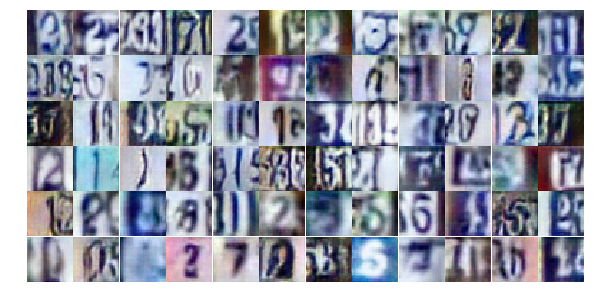

Epoch 16/25... Discriminator Loss: 0.8526... Generator Loss: 0.8944
Epoch 16/25... Discriminator Loss: 0.6397... Generator Loss: 1.3220
Epoch 16/25... Discriminator Loss: 0.9572... Generator Loss: 0.7102
Epoch 16/25... Discriminator Loss: 1.1898... Generator Loss: 0.5181
Epoch 16/25... Discriminator Loss: 0.5577... Generator Loss: 1.3843
Epoch 16/25... Discriminator Loss: 0.7763... Generator Loss: 0.8685
Epoch 16/25... Discriminator Loss: 0.8634... Generator Loss: 0.7727
Epoch 16/25... Discriminator Loss: 0.5056... Generator Loss: 1.4848
Epoch 16/25... Discriminator Loss: 0.7972... Generator Loss: 0.8285
Epoch 16/25... Discriminator Loss: 0.7620... Generator Loss: 0.9138


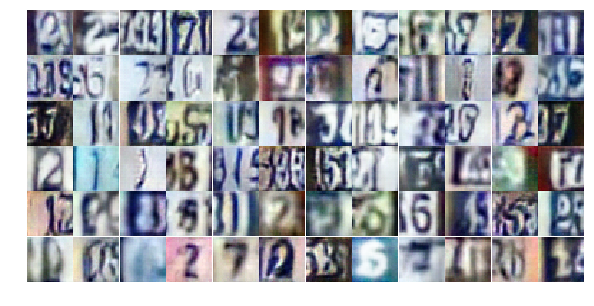

Epoch 16/25... Discriminator Loss: 0.4903... Generator Loss: 1.2091
Epoch 16/25... Discriminator Loss: 0.6283... Generator Loss: 1.0369
Epoch 16/25... Discriminator Loss: 0.6748... Generator Loss: 1.2583
Epoch 16/25... Discriminator Loss: 0.6941... Generator Loss: 1.6078
Epoch 16/25... Discriminator Loss: 0.7001... Generator Loss: 1.3497
Epoch 16/25... Discriminator Loss: 0.5457... Generator Loss: 2.0727
Epoch 16/25... Discriminator Loss: 1.1951... Generator Loss: 0.5098
Epoch 16/25... Discriminator Loss: 1.5563... Generator Loss: 0.3518
Epoch 16/25... Discriminator Loss: 0.7572... Generator Loss: 1.2585
Epoch 16/25... Discriminator Loss: 0.4730... Generator Loss: 1.4689


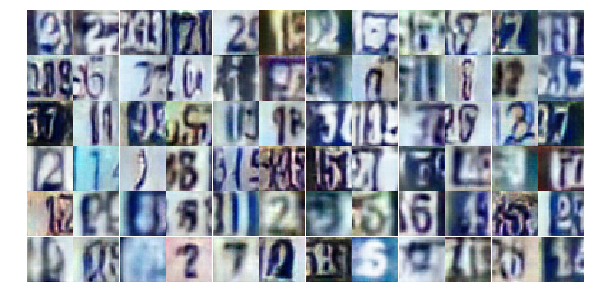

Epoch 16/25... Discriminator Loss: 0.4618... Generator Loss: 1.6916
Epoch 16/25... Discriminator Loss: 0.6268... Generator Loss: 1.1446
Epoch 16/25... Discriminator Loss: 1.1173... Generator Loss: 0.6367
Epoch 16/25... Discriminator Loss: 1.1114... Generator Loss: 0.5250
Epoch 16/25... Discriminator Loss: 0.7800... Generator Loss: 1.2889
Epoch 16/25... Discriminator Loss: 1.1231... Generator Loss: 0.5474
Epoch 16/25... Discriminator Loss: 0.5469... Generator Loss: 1.1576
Epoch 16/25... Discriminator Loss: 0.6674... Generator Loss: 1.0931
Epoch 16/25... Discriminator Loss: 0.6559... Generator Loss: 0.9644
Epoch 16/25... Discriminator Loss: 0.9046... Generator Loss: 0.7444


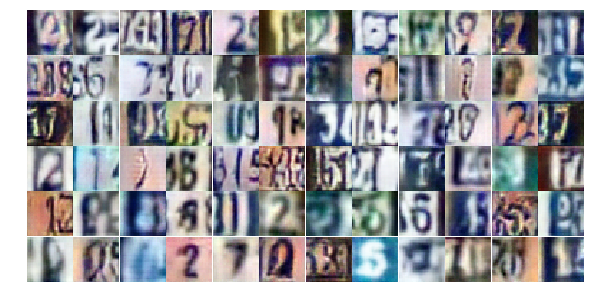

Epoch 16/25... Discriminator Loss: 1.2984... Generator Loss: 0.4189
Epoch 16/25... Discriminator Loss: 0.6918... Generator Loss: 2.1961
Epoch 16/25... Discriminator Loss: 1.4780... Generator Loss: 0.4134
Epoch 16/25... Discriminator Loss: 0.6183... Generator Loss: 1.0385
Epoch 16/25... Discriminator Loss: 0.6424... Generator Loss: 1.0975
Epoch 16/25... Discriminator Loss: 0.8883... Generator Loss: 0.7584
Epoch 17/25... Discriminator Loss: 0.6057... Generator Loss: 1.4663
Epoch 17/25... Discriminator Loss: 0.6341... Generator Loss: 1.2862
Epoch 17/25... Discriminator Loss: 0.8598... Generator Loss: 0.7874
Epoch 17/25... Discriminator Loss: 0.6716... Generator Loss: 1.1714


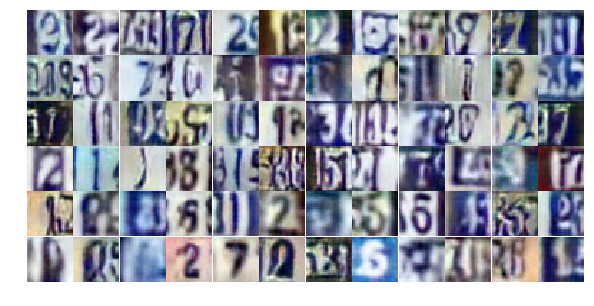

Epoch 17/25... Discriminator Loss: 0.5250... Generator Loss: 1.2932
Epoch 17/25... Discriminator Loss: 0.6192... Generator Loss: 1.0667
Epoch 17/25... Discriminator Loss: 1.2443... Generator Loss: 0.5618
Epoch 17/25... Discriminator Loss: 1.2155... Generator Loss: 0.6649
Epoch 17/25... Discriminator Loss: 1.0327... Generator Loss: 0.7247
Epoch 17/25... Discriminator Loss: 1.5554... Generator Loss: 0.4069
Epoch 17/25... Discriminator Loss: 1.0381... Generator Loss: 0.6615
Epoch 17/25... Discriminator Loss: 0.8953... Generator Loss: 0.6906
Epoch 17/25... Discriminator Loss: 0.5187... Generator Loss: 1.3437
Epoch 17/25... Discriminator Loss: 0.8442... Generator Loss: 0.8301


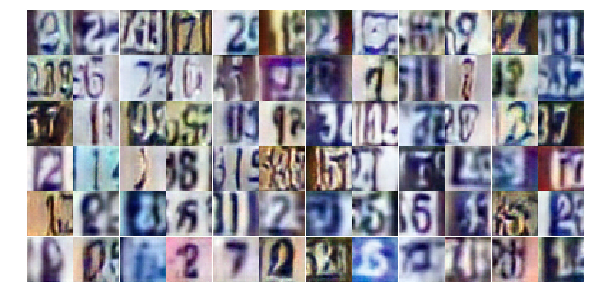

Epoch 17/25... Discriminator Loss: 0.9998... Generator Loss: 0.7548
Epoch 17/25... Discriminator Loss: 0.7861... Generator Loss: 0.8713
Epoch 17/25... Discriminator Loss: 0.5912... Generator Loss: 1.4307
Epoch 17/25... Discriminator Loss: 0.5775... Generator Loss: 1.3099
Epoch 17/25... Discriminator Loss: 0.5793... Generator Loss: 1.2478
Epoch 17/25... Discriminator Loss: 1.0527... Generator Loss: 0.6289
Epoch 17/25... Discriminator Loss: 0.4612... Generator Loss: 1.8121
Epoch 17/25... Discriminator Loss: 0.5808... Generator Loss: 1.6379
Epoch 17/25... Discriminator Loss: 0.6666... Generator Loss: 1.0113
Epoch 17/25... Discriminator Loss: 0.7528... Generator Loss: 0.8590


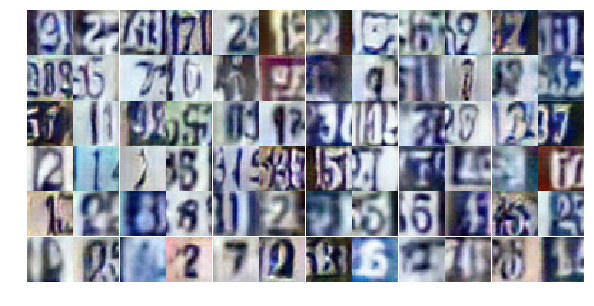

Epoch 17/25... Discriminator Loss: 1.0003... Generator Loss: 0.9006
Epoch 17/25... Discriminator Loss: 0.4029... Generator Loss: 1.7221
Epoch 17/25... Discriminator Loss: 0.6830... Generator Loss: 0.9495
Epoch 17/25... Discriminator Loss: 0.9336... Generator Loss: 0.6808
Epoch 17/25... Discriminator Loss: 1.6049... Generator Loss: 0.3000
Epoch 17/25... Discriminator Loss: 0.5458... Generator Loss: 1.3023
Epoch 17/25... Discriminator Loss: 0.7075... Generator Loss: 0.9810
Epoch 17/25... Discriminator Loss: 0.8727... Generator Loss: 0.7649
Epoch 17/25... Discriminator Loss: 0.9476... Generator Loss: 0.6731
Epoch 17/25... Discriminator Loss: 0.3524... Generator Loss: 1.6416


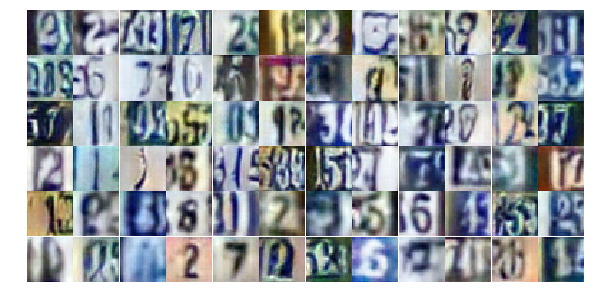

Epoch 17/25... Discriminator Loss: 0.8758... Generator Loss: 0.8059
Epoch 17/25... Discriminator Loss: 1.2523... Generator Loss: 0.5908
Epoch 17/25... Discriminator Loss: 0.5480... Generator Loss: 1.7087
Epoch 17/25... Discriminator Loss: 0.7474... Generator Loss: 1.1044
Epoch 17/25... Discriminator Loss: 1.0934... Generator Loss: 0.5555
Epoch 17/25... Discriminator Loss: 0.6848... Generator Loss: 0.9670
Epoch 17/25... Discriminator Loss: 1.1192... Generator Loss: 0.5995
Epoch 17/25... Discriminator Loss: 0.4868... Generator Loss: 1.5997
Epoch 17/25... Discriminator Loss: 0.4744... Generator Loss: 1.4176
Epoch 17/25... Discriminator Loss: 1.1064... Generator Loss: 0.5318


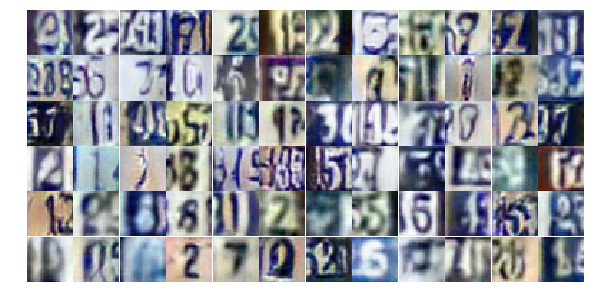

Epoch 17/25... Discriminator Loss: 2.2536... Generator Loss: 3.4627
Epoch 17/25... Discriminator Loss: 0.5420... Generator Loss: 1.2253
Epoch 17/25... Discriminator Loss: 0.7778... Generator Loss: 1.3412
Epoch 17/25... Discriminator Loss: 0.4440... Generator Loss: 1.4907
Epoch 17/25... Discriminator Loss: 0.7424... Generator Loss: 0.9246
Epoch 17/25... Discriminator Loss: 0.7762... Generator Loss: 0.9671
Epoch 17/25... Discriminator Loss: 0.9879... Generator Loss: 0.6274
Epoch 17/25... Discriminator Loss: 0.5739... Generator Loss: 1.1800
Epoch 17/25... Discriminator Loss: 0.6305... Generator Loss: 1.1997
Epoch 17/25... Discriminator Loss: 1.5953... Generator Loss: 0.3243


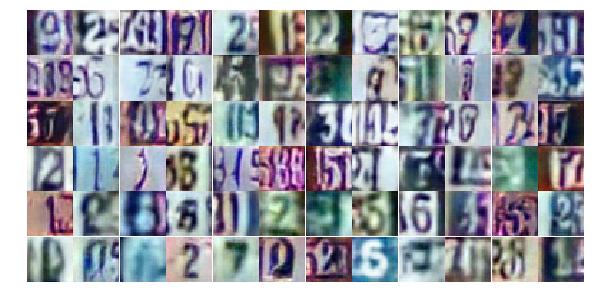

Epoch 17/25... Discriminator Loss: 0.8101... Generator Loss: 1.7464
Epoch 17/25... Discriminator Loss: 0.9745... Generator Loss: 1.7619
Epoch 17/25... Discriminator Loss: 0.4186... Generator Loss: 1.9173
Epoch 17/25... Discriminator Loss: 0.9154... Generator Loss: 2.8922
Epoch 18/25... Discriminator Loss: 1.3668... Generator Loss: 0.4780
Epoch 18/25... Discriminator Loss: 1.1451... Generator Loss: 0.5418
Epoch 18/25... Discriminator Loss: 0.4970... Generator Loss: 1.5715
Epoch 18/25... Discriminator Loss: 0.7502... Generator Loss: 0.8905
Epoch 18/25... Discriminator Loss: 1.0558... Generator Loss: 0.6555
Epoch 18/25... Discriminator Loss: 0.7500... Generator Loss: 1.0696


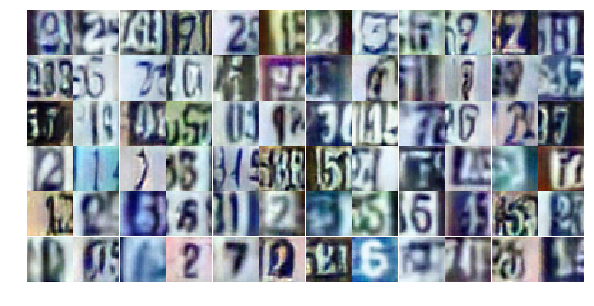

Epoch 18/25... Discriminator Loss: 0.4689... Generator Loss: 1.7444
Epoch 18/25... Discriminator Loss: 1.4339... Generator Loss: 0.3829
Epoch 18/25... Discriminator Loss: 0.9059... Generator Loss: 0.7264
Epoch 18/25... Discriminator Loss: 0.6060... Generator Loss: 1.3420
Epoch 18/25... Discriminator Loss: 0.5551... Generator Loss: 1.3061
Epoch 18/25... Discriminator Loss: 1.1284... Generator Loss: 0.5724
Epoch 18/25... Discriminator Loss: 0.6307... Generator Loss: 1.3052
Epoch 18/25... Discriminator Loss: 0.5997... Generator Loss: 1.1859
Epoch 18/25... Discriminator Loss: 0.7843... Generator Loss: 0.8226
Epoch 18/25... Discriminator Loss: 0.2846... Generator Loss: 2.3217


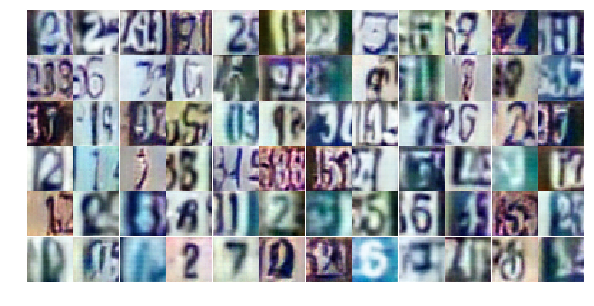

Epoch 18/25... Discriminator Loss: 0.6614... Generator Loss: 1.0076
Epoch 18/25... Discriminator Loss: 0.8088... Generator Loss: 0.8212
Epoch 18/25... Discriminator Loss: 1.4350... Generator Loss: 0.3705
Epoch 18/25... Discriminator Loss: 0.5078... Generator Loss: 1.2918
Epoch 18/25... Discriminator Loss: 0.8853... Generator Loss: 0.7738
Epoch 18/25... Discriminator Loss: 1.0447... Generator Loss: 0.6333
Epoch 18/25... Discriminator Loss: 0.7786... Generator Loss: 1.0471
Epoch 18/25... Discriminator Loss: 1.0584... Generator Loss: 0.6714
Epoch 18/25... Discriminator Loss: 0.5589... Generator Loss: 1.4271
Epoch 18/25... Discriminator Loss: 0.6371... Generator Loss: 1.0924


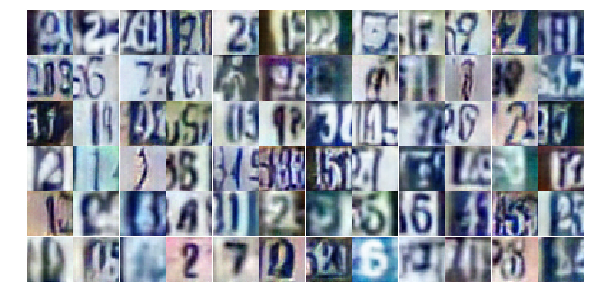

Epoch 18/25... Discriminator Loss: 0.4931... Generator Loss: 1.3254
Epoch 18/25... Discriminator Loss: 0.7121... Generator Loss: 1.0927
Epoch 18/25... Discriminator Loss: 0.7346... Generator Loss: 1.0772
Epoch 18/25... Discriminator Loss: 0.6425... Generator Loss: 1.2682
Epoch 18/25... Discriminator Loss: 1.2562... Generator Loss: 0.5243
Epoch 18/25... Discriminator Loss: 0.7300... Generator Loss: 1.0128
Epoch 18/25... Discriminator Loss: 0.7212... Generator Loss: 0.9738
Epoch 18/25... Discriminator Loss: 0.4462... Generator Loss: 1.5533
Epoch 18/25... Discriminator Loss: 0.8289... Generator Loss: 0.7501
Epoch 18/25... Discriminator Loss: 0.6469... Generator Loss: 1.1868


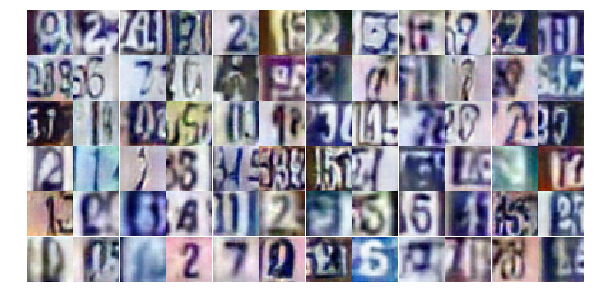

Epoch 18/25... Discriminator Loss: 0.6317... Generator Loss: 1.1615
Epoch 18/25... Discriminator Loss: 0.8390... Generator Loss: 0.8173
Epoch 18/25... Discriminator Loss: 0.6317... Generator Loss: 1.0150
Epoch 18/25... Discriminator Loss: 0.5657... Generator Loss: 1.5369
Epoch 18/25... Discriminator Loss: 0.6494... Generator Loss: 1.2776
Epoch 18/25... Discriminator Loss: 0.4663... Generator Loss: 1.3210
Epoch 18/25... Discriminator Loss: 1.0427... Generator Loss: 0.6068
Epoch 18/25... Discriminator Loss: 2.2891... Generator Loss: 4.1773
Epoch 18/25... Discriminator Loss: 3.5924... Generator Loss: 0.0513
Epoch 18/25... Discriminator Loss: 0.3824... Generator Loss: 1.7977


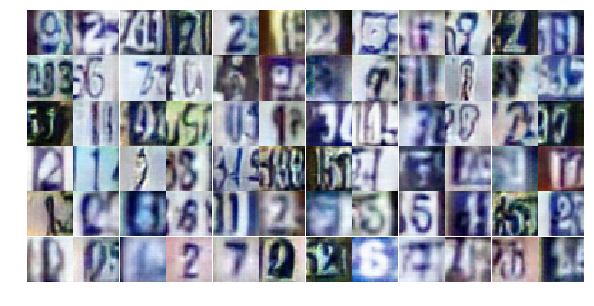

Epoch 18/25... Discriminator Loss: 0.9266... Generator Loss: 0.8019
Epoch 18/25... Discriminator Loss: 0.8621... Generator Loss: 0.9105
Epoch 18/25... Discriminator Loss: 0.8385... Generator Loss: 1.1332
Epoch 18/25... Discriminator Loss: 0.9156... Generator Loss: 0.7889
Epoch 18/25... Discriminator Loss: 0.6711... Generator Loss: 1.1418
Epoch 18/25... Discriminator Loss: 0.5612... Generator Loss: 1.6644
Epoch 18/25... Discriminator Loss: 0.6501... Generator Loss: 1.0359
Epoch 18/25... Discriminator Loss: 0.4023... Generator Loss: 2.0804
Epoch 18/25... Discriminator Loss: 0.9555... Generator Loss: 0.6780
Epoch 18/25... Discriminator Loss: 0.9891... Generator Loss: 0.6869


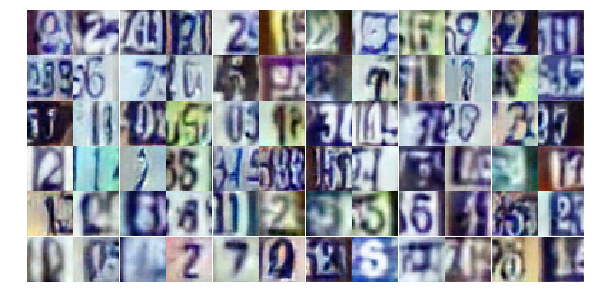

Epoch 18/25... Discriminator Loss: 0.7042... Generator Loss: 2.6007
Epoch 19/25... Discriminator Loss: 1.1331... Generator Loss: 0.6028
Epoch 19/25... Discriminator Loss: 1.3075... Generator Loss: 0.4531
Epoch 19/25... Discriminator Loss: 0.8416... Generator Loss: 1.4136
Epoch 19/25... Discriminator Loss: 0.6714... Generator Loss: 0.9832
Epoch 19/25... Discriminator Loss: 1.1303... Generator Loss: 0.5907
Epoch 19/25... Discriminator Loss: 0.4448... Generator Loss: 2.0943
Epoch 19/25... Discriminator Loss: 0.9384... Generator Loss: 0.9298
Epoch 19/25... Discriminator Loss: 0.7357... Generator Loss: 1.2067
Epoch 19/25... Discriminator Loss: 1.0958... Generator Loss: 0.5896


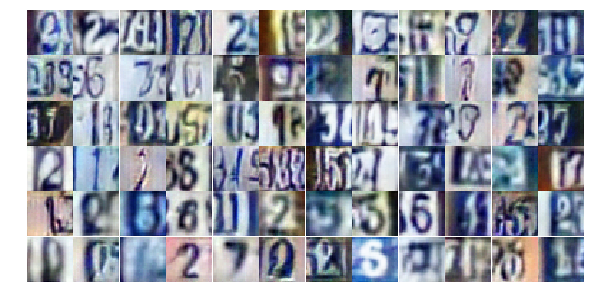

Epoch 19/25... Discriminator Loss: 0.8551... Generator Loss: 0.7725
Epoch 19/25... Discriminator Loss: 0.9362... Generator Loss: 0.7039
Epoch 19/25... Discriminator Loss: 0.7945... Generator Loss: 1.0260
Epoch 19/25... Discriminator Loss: 1.1137... Generator Loss: 0.5851
Epoch 19/25... Discriminator Loss: 0.8990... Generator Loss: 0.7538
Epoch 19/25... Discriminator Loss: 0.7193... Generator Loss: 0.9296
Epoch 19/25... Discriminator Loss: 0.9534... Generator Loss: 0.6620
Epoch 19/25... Discriminator Loss: 0.7674... Generator Loss: 0.8939
Epoch 19/25... Discriminator Loss: 0.9283... Generator Loss: 1.9417
Epoch 19/25... Discriminator Loss: 0.6332... Generator Loss: 1.1274


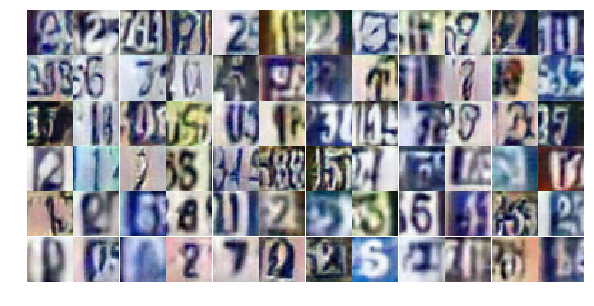

Epoch 19/25... Discriminator Loss: 1.2787... Generator Loss: 0.4591
Epoch 19/25... Discriminator Loss: 0.9508... Generator Loss: 0.8367
Epoch 19/25... Discriminator Loss: 1.6878... Generator Loss: 0.2985
Epoch 19/25... Discriminator Loss: 0.7404... Generator Loss: 1.3500
Epoch 19/25... Discriminator Loss: 1.2497... Generator Loss: 0.5923
Epoch 19/25... Discriminator Loss: 1.1976... Generator Loss: 1.1971
Epoch 19/25... Discriminator Loss: 1.1117... Generator Loss: 0.6072
Epoch 19/25... Discriminator Loss: 0.4574... Generator Loss: 1.8243
Epoch 19/25... Discriminator Loss: 0.7780... Generator Loss: 0.8966
Epoch 19/25... Discriminator Loss: 1.4428... Generator Loss: 0.3795


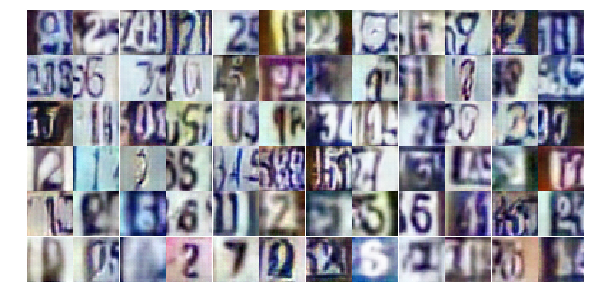

Epoch 19/25... Discriminator Loss: 0.8138... Generator Loss: 0.8585
Epoch 19/25... Discriminator Loss: 0.9574... Generator Loss: 0.7694
Epoch 19/25... Discriminator Loss: 0.9554... Generator Loss: 0.6588
Epoch 19/25... Discriminator Loss: 0.7629... Generator Loss: 0.9534
Epoch 19/25... Discriminator Loss: 0.7946... Generator Loss: 0.8792
Epoch 19/25... Discriminator Loss: 0.9416... Generator Loss: 0.7166
Epoch 19/25... Discriminator Loss: 0.7098... Generator Loss: 1.1137
Epoch 19/25... Discriminator Loss: 0.4322... Generator Loss: 2.1791
Epoch 19/25... Discriminator Loss: 1.0520... Generator Loss: 0.6171
Epoch 19/25... Discriminator Loss: 0.5457... Generator Loss: 1.2133


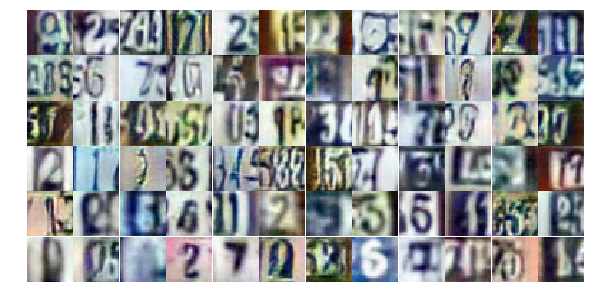

Epoch 19/25... Discriminator Loss: 0.6132... Generator Loss: 1.0839
Epoch 19/25... Discriminator Loss: 1.1183... Generator Loss: 0.5957
Epoch 19/25... Discriminator Loss: 0.9277... Generator Loss: 0.6750
Epoch 19/25... Discriminator Loss: 0.6129... Generator Loss: 1.0879
Epoch 19/25... Discriminator Loss: 0.9891... Generator Loss: 0.7021
Epoch 19/25... Discriminator Loss: 0.7187... Generator Loss: 2.0752
Epoch 19/25... Discriminator Loss: 0.5913... Generator Loss: 1.0856
Epoch 19/25... Discriminator Loss: 0.5082... Generator Loss: 2.1388
Epoch 19/25... Discriminator Loss: 0.7032... Generator Loss: 1.2394
Epoch 19/25... Discriminator Loss: 0.7460... Generator Loss: 1.2583


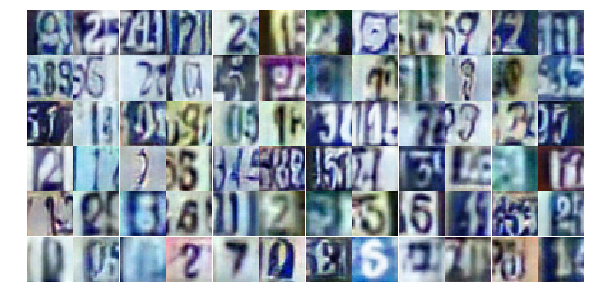

Epoch 19/25... Discriminator Loss: 0.9089... Generator Loss: 0.7919
Epoch 19/25... Discriminator Loss: 0.5031... Generator Loss: 1.3755
Epoch 19/25... Discriminator Loss: 0.7504... Generator Loss: 1.1425
Epoch 19/25... Discriminator Loss: 0.7001... Generator Loss: 1.0430
Epoch 19/25... Discriminator Loss: 0.8578... Generator Loss: 3.1013
Epoch 19/25... Discriminator Loss: 1.3118... Generator Loss: 1.9079
Epoch 19/25... Discriminator Loss: 0.9789... Generator Loss: 0.9604
Epoch 19/25... Discriminator Loss: 0.6573... Generator Loss: 1.3140
Epoch 20/25... Discriminator Loss: 0.7772... Generator Loss: 1.0456
Epoch 20/25... Discriminator Loss: 0.6953... Generator Loss: 1.1418


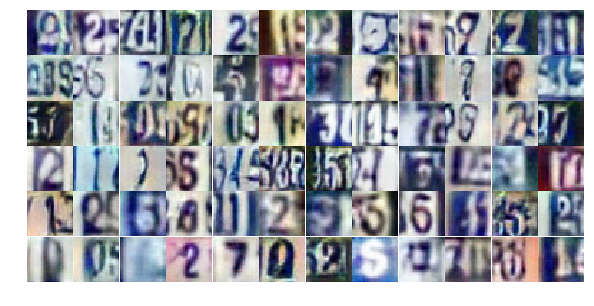

Epoch 20/25... Discriminator Loss: 0.5245... Generator Loss: 1.3313
Epoch 20/25... Discriminator Loss: 0.8230... Generator Loss: 0.8181
Epoch 20/25... Discriminator Loss: 1.3240... Generator Loss: 0.4684
Epoch 20/25... Discriminator Loss: 1.6129... Generator Loss: 0.3093
Epoch 20/25... Discriminator Loss: 0.8146... Generator Loss: 0.9056
Epoch 20/25... Discriminator Loss: 0.8780... Generator Loss: 0.7773
Epoch 20/25... Discriminator Loss: 0.7560... Generator Loss: 0.8786
Epoch 20/25... Discriminator Loss: 0.7642... Generator Loss: 0.9003
Epoch 20/25... Discriminator Loss: 0.7345... Generator Loss: 1.1356
Epoch 20/25... Discriminator Loss: 0.7581... Generator Loss: 0.8771


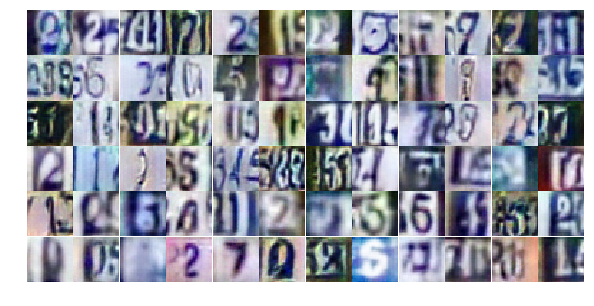

Epoch 20/25... Discriminator Loss: 1.3257... Generator Loss: 0.5122
Epoch 20/25... Discriminator Loss: 0.9116... Generator Loss: 0.7659
Epoch 20/25... Discriminator Loss: 0.8941... Generator Loss: 0.7662
Epoch 20/25... Discriminator Loss: 0.8465... Generator Loss: 0.8600
Epoch 20/25... Discriminator Loss: 1.0386... Generator Loss: 0.6281
Epoch 20/25... Discriminator Loss: 1.1395... Generator Loss: 0.6060
Epoch 20/25... Discriminator Loss: 1.6484... Generator Loss: 0.3347
Epoch 20/25... Discriminator Loss: 0.7415... Generator Loss: 1.1754
Epoch 20/25... Discriminator Loss: 0.7225... Generator Loss: 1.0286
Epoch 20/25... Discriminator Loss: 0.8504... Generator Loss: 0.8120


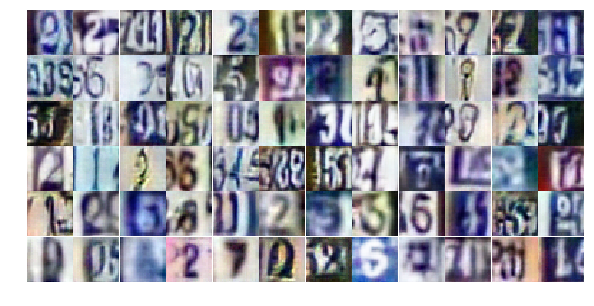

Epoch 20/25... Discriminator Loss: 0.7723... Generator Loss: 0.8449
Epoch 20/25... Discriminator Loss: 0.7856... Generator Loss: 0.8720
Epoch 20/25... Discriminator Loss: 0.3360... Generator Loss: 1.7407
Epoch 20/25... Discriminator Loss: 1.5821... Generator Loss: 0.3478
Epoch 20/25... Discriminator Loss: 0.9660... Generator Loss: 0.7095
Epoch 20/25... Discriminator Loss: 0.5591... Generator Loss: 1.1847
Epoch 20/25... Discriminator Loss: 0.6749... Generator Loss: 1.9601
Epoch 20/25... Discriminator Loss: 1.7174... Generator Loss: 0.2971
Epoch 20/25... Discriminator Loss: 0.8771... Generator Loss: 0.7873
Epoch 20/25... Discriminator Loss: 0.6901... Generator Loss: 0.9310


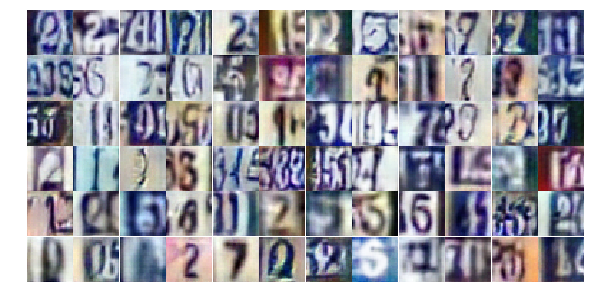

Epoch 20/25... Discriminator Loss: 0.6187... Generator Loss: 1.2183
Epoch 20/25... Discriminator Loss: 0.4064... Generator Loss: 1.5293
Epoch 20/25... Discriminator Loss: 1.8698... Generator Loss: 0.2493
Epoch 20/25... Discriminator Loss: 0.7696... Generator Loss: 0.9984
Epoch 20/25... Discriminator Loss: 0.8917... Generator Loss: 0.9437
Epoch 20/25... Discriminator Loss: 0.5593... Generator Loss: 1.4257
Epoch 20/25... Discriminator Loss: 0.8674... Generator Loss: 1.0465
Epoch 20/25... Discriminator Loss: 1.1313... Generator Loss: 0.5929
Epoch 20/25... Discriminator Loss: 0.7007... Generator Loss: 0.9723
Epoch 20/25... Discriminator Loss: 1.0584... Generator Loss: 0.6286


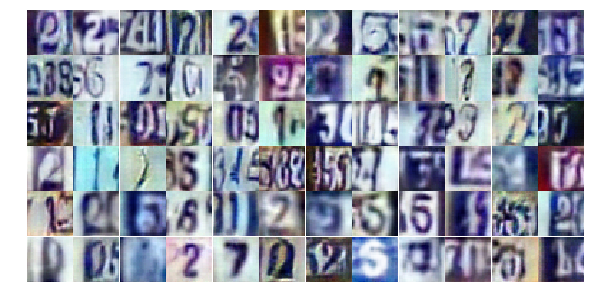

Epoch 20/25... Discriminator Loss: 1.3409... Generator Loss: 0.4769
Epoch 20/25... Discriminator Loss: 0.6263... Generator Loss: 1.2217
Epoch 20/25... Discriminator Loss: 0.8611... Generator Loss: 0.9632
Epoch 20/25... Discriminator Loss: 1.3063... Generator Loss: 0.5740
Epoch 20/25... Discriminator Loss: 0.8703... Generator Loss: 0.7703
Epoch 20/25... Discriminator Loss: 1.0194... Generator Loss: 0.6331
Epoch 20/25... Discriminator Loss: 1.0704... Generator Loss: 0.6033
Epoch 20/25... Discriminator Loss: 0.4280... Generator Loss: 1.7027
Epoch 20/25... Discriminator Loss: 0.8836... Generator Loss: 0.8640
Epoch 20/25... Discriminator Loss: 0.6597... Generator Loss: 1.0517


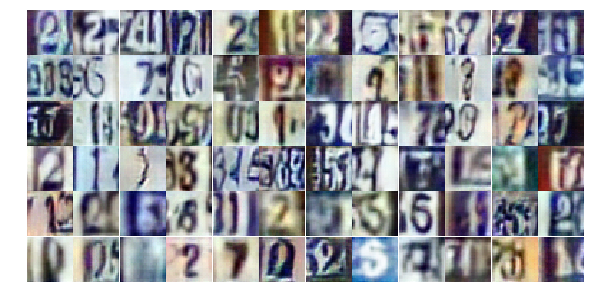

Epoch 20/25... Discriminator Loss: 0.6268... Generator Loss: 1.1797
Epoch 20/25... Discriminator Loss: 0.8043... Generator Loss: 0.9695
Epoch 20/25... Discriminator Loss: 0.4504... Generator Loss: 1.5089
Epoch 20/25... Discriminator Loss: 0.7019... Generator Loss: 1.2469
Epoch 20/25... Discriminator Loss: 0.4608... Generator Loss: 1.8366
Epoch 20/25... Discriminator Loss: 0.4961... Generator Loss: 1.4424
Epoch 21/25... Discriminator Loss: 0.9614... Generator Loss: 0.7337
Epoch 21/25... Discriminator Loss: 1.0460... Generator Loss: 0.5744
Epoch 21/25... Discriminator Loss: 1.0851... Generator Loss: 0.6042
Epoch 21/25... Discriminator Loss: 0.8057... Generator Loss: 0.9627


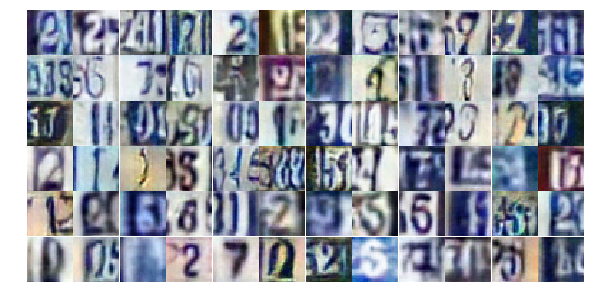

Epoch 21/25... Discriminator Loss: 0.8127... Generator Loss: 0.9162
Epoch 21/25... Discriminator Loss: 1.8221... Generator Loss: 0.3196
Epoch 21/25... Discriminator Loss: 0.4985... Generator Loss: 1.7708
Epoch 21/25... Discriminator Loss: 0.3858... Generator Loss: 2.4078
Epoch 21/25... Discriminator Loss: 0.9269... Generator Loss: 0.7043
Epoch 21/25... Discriminator Loss: 0.4901... Generator Loss: 1.3938
Epoch 21/25... Discriminator Loss: 1.0237... Generator Loss: 0.7168
Epoch 21/25... Discriminator Loss: 1.1377... Generator Loss: 0.5616
Epoch 21/25... Discriminator Loss: 0.7379... Generator Loss: 1.0117
Epoch 21/25... Discriminator Loss: 1.2244... Generator Loss: 0.5168


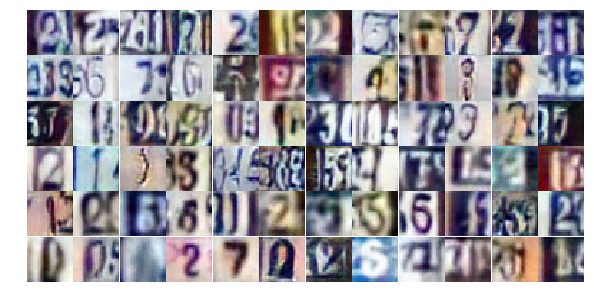

Epoch 21/25... Discriminator Loss: 0.3598... Generator Loss: 1.9385
Epoch 21/25... Discriminator Loss: 0.8743... Generator Loss: 0.7979
Epoch 21/25... Discriminator Loss: 2.7145... Generator Loss: 5.1368
Epoch 21/25... Discriminator Loss: 1.2063... Generator Loss: 0.7091
Epoch 21/25... Discriminator Loss: 0.7138... Generator Loss: 1.3338
Epoch 21/25... Discriminator Loss: 0.7220... Generator Loss: 1.0189
Epoch 21/25... Discriminator Loss: 1.0856... Generator Loss: 0.6529
Epoch 21/25... Discriminator Loss: 0.5555... Generator Loss: 1.3222
Epoch 21/25... Discriminator Loss: 0.5971... Generator Loss: 1.2171
Epoch 21/25... Discriminator Loss: 0.8001... Generator Loss: 0.9132


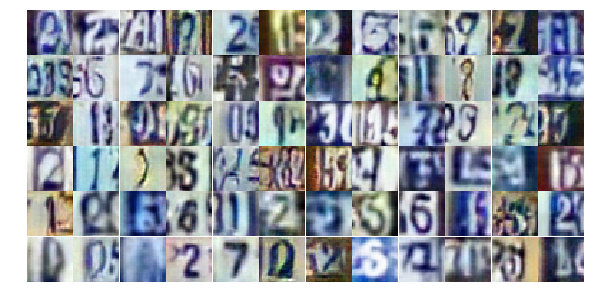

Epoch 21/25... Discriminator Loss: 0.7619... Generator Loss: 1.1707
Epoch 21/25... Discriminator Loss: 0.4240... Generator Loss: 1.6920
Epoch 21/25... Discriminator Loss: 0.9851... Generator Loss: 0.6834
Epoch 21/25... Discriminator Loss: 0.7900... Generator Loss: 0.9411
Epoch 21/25... Discriminator Loss: 0.7511... Generator Loss: 0.9241
Epoch 21/25... Discriminator Loss: 1.2370... Generator Loss: 0.5148
Epoch 21/25... Discriminator Loss: 0.6082... Generator Loss: 2.7578
Epoch 21/25... Discriminator Loss: 0.7029... Generator Loss: 1.1048
Epoch 21/25... Discriminator Loss: 1.4481... Generator Loss: 0.3833
Epoch 21/25... Discriminator Loss: 1.2748... Generator Loss: 0.6312


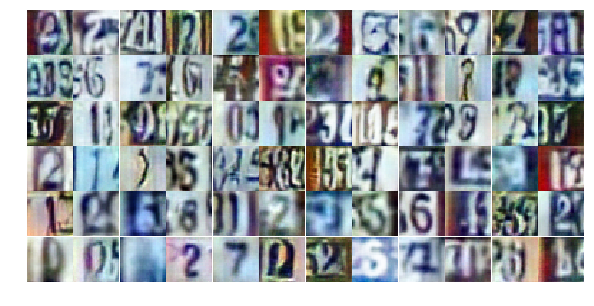

Epoch 21/25... Discriminator Loss: 1.3597... Generator Loss: 0.4387
Epoch 21/25... Discriminator Loss: 0.5935... Generator Loss: 1.1594
Epoch 21/25... Discriminator Loss: 1.6920... Generator Loss: 0.3478
Epoch 21/25... Discriminator Loss: 0.5729... Generator Loss: 1.1602
Epoch 21/25... Discriminator Loss: 0.8624... Generator Loss: 0.7576
Epoch 21/25... Discriminator Loss: 0.7690... Generator Loss: 0.7889
Epoch 21/25... Discriminator Loss: 0.8359... Generator Loss: 1.0850
Epoch 21/25... Discriminator Loss: 1.6491... Generator Loss: 0.3351
Epoch 21/25... Discriminator Loss: 0.7697... Generator Loss: 0.9918
Epoch 21/25... Discriminator Loss: 0.4985... Generator Loss: 1.6693


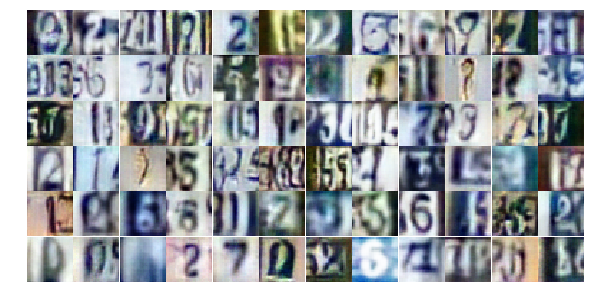

Epoch 21/25... Discriminator Loss: 0.5706... Generator Loss: 1.5318
Epoch 21/25... Discriminator Loss: 1.8282... Generator Loss: 0.2842
Epoch 21/25... Discriminator Loss: 0.6479... Generator Loss: 1.0973
Epoch 21/25... Discriminator Loss: 0.7422... Generator Loss: 1.0543
Epoch 21/25... Discriminator Loss: 0.5477... Generator Loss: 1.3138
Epoch 21/25... Discriminator Loss: 0.6833... Generator Loss: 1.0080
Epoch 21/25... Discriminator Loss: 0.8353... Generator Loss: 0.8365
Epoch 21/25... Discriminator Loss: 1.6105... Generator Loss: 0.3545
Epoch 21/25... Discriminator Loss: 1.2441... Generator Loss: 0.5455
Epoch 21/25... Discriminator Loss: 0.7415... Generator Loss: 0.9618


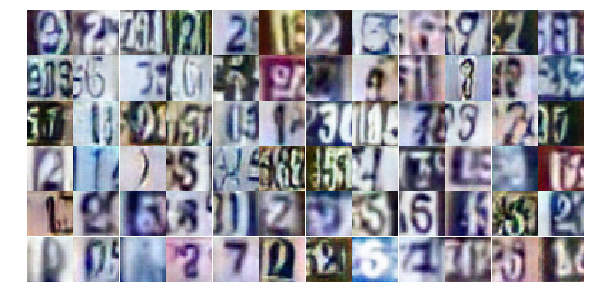

Epoch 21/25... Discriminator Loss: 0.6471... Generator Loss: 1.0516
Epoch 21/25... Discriminator Loss: 0.9132... Generator Loss: 0.7314
Epoch 21/25... Discriminator Loss: 0.6544... Generator Loss: 1.1243
Epoch 22/25... Discriminator Loss: 0.6674... Generator Loss: 2.0269
Epoch 22/25... Discriminator Loss: 0.8847... Generator Loss: 0.8607
Epoch 22/25... Discriminator Loss: 0.6825... Generator Loss: 1.4329
Epoch 22/25... Discriminator Loss: 0.5000... Generator Loss: 1.6225
Epoch 22/25... Discriminator Loss: 0.3634... Generator Loss: 1.8296
Epoch 22/25... Discriminator Loss: 1.2485... Generator Loss: 0.5519
Epoch 22/25... Discriminator Loss: 1.0932... Generator Loss: 0.5901


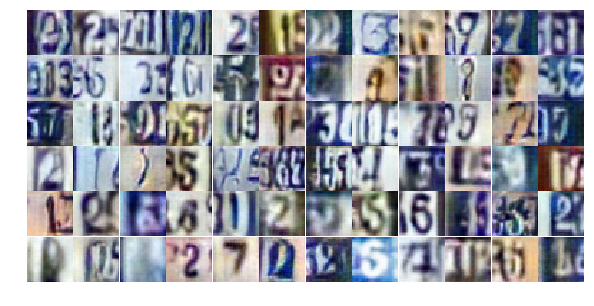

Epoch 22/25... Discriminator Loss: 0.7054... Generator Loss: 1.4134
Epoch 22/25... Discriminator Loss: 0.9324... Generator Loss: 0.7972
Epoch 22/25... Discriminator Loss: 1.6438... Generator Loss: 0.2905
Epoch 22/25... Discriminator Loss: 0.8348... Generator Loss: 0.7693
Epoch 22/25... Discriminator Loss: 0.7605... Generator Loss: 1.0160
Epoch 22/25... Discriminator Loss: 0.5363... Generator Loss: 1.2768
Epoch 22/25... Discriminator Loss: 0.9252... Generator Loss: 0.7201
Epoch 22/25... Discriminator Loss: 0.5182... Generator Loss: 1.5288
Epoch 22/25... Discriminator Loss: 1.3310... Generator Loss: 0.4556
Epoch 22/25... Discriminator Loss: 2.1195... Generator Loss: 0.2081


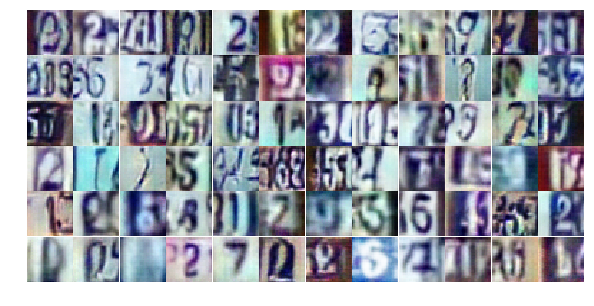

Epoch 22/25... Discriminator Loss: 0.9612... Generator Loss: 1.1363
Epoch 22/25... Discriminator Loss: 0.7398... Generator Loss: 0.9350
Epoch 22/25... Discriminator Loss: 0.9264... Generator Loss: 0.8392
Epoch 22/25... Discriminator Loss: 0.8146... Generator Loss: 0.7742
Epoch 22/25... Discriminator Loss: 0.8412... Generator Loss: 0.7818
Epoch 22/25... Discriminator Loss: 1.0201... Generator Loss: 0.6694
Epoch 22/25... Discriminator Loss: 0.5498... Generator Loss: 1.2104
Epoch 22/25... Discriminator Loss: 0.4078... Generator Loss: 1.5779
Epoch 22/25... Discriminator Loss: 0.6366... Generator Loss: 1.1045
Epoch 22/25... Discriminator Loss: 0.7452... Generator Loss: 0.9074


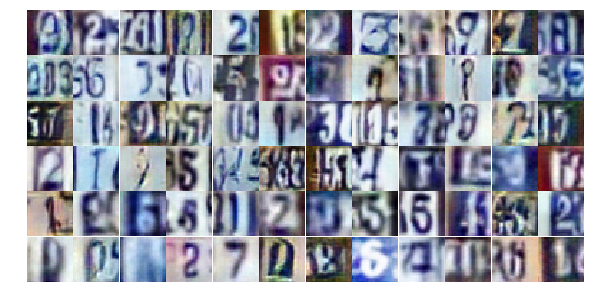

Epoch 22/25... Discriminator Loss: 0.3550... Generator Loss: 1.7093
Epoch 22/25... Discriminator Loss: 0.7289... Generator Loss: 0.9311
Epoch 22/25... Discriminator Loss: 0.9496... Generator Loss: 0.6876
Epoch 22/25... Discriminator Loss: 0.8846... Generator Loss: 0.8021
Epoch 22/25... Discriminator Loss: 0.8510... Generator Loss: 0.8930
Epoch 22/25... Discriminator Loss: 1.1250... Generator Loss: 0.6099
Epoch 22/25... Discriminator Loss: 1.5750... Generator Loss: 0.3661
Epoch 22/25... Discriminator Loss: 0.5345... Generator Loss: 1.2183
Epoch 22/25... Discriminator Loss: 1.1153... Generator Loss: 0.6509
Epoch 22/25... Discriminator Loss: 1.4474... Generator Loss: 0.3894


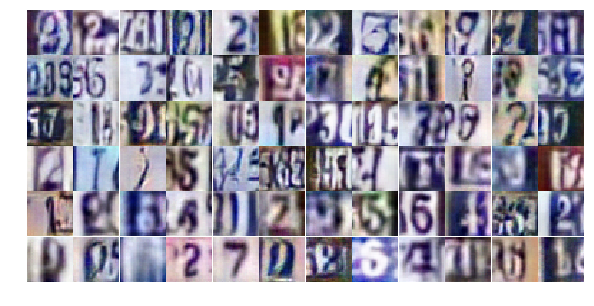

Epoch 22/25... Discriminator Loss: 0.7648... Generator Loss: 1.4085
Epoch 22/25... Discriminator Loss: 0.6137... Generator Loss: 1.2788
Epoch 22/25... Discriminator Loss: 0.3437... Generator Loss: 2.1350
Epoch 22/25... Discriminator Loss: 0.9566... Generator Loss: 0.7447
Epoch 22/25... Discriminator Loss: 0.3637... Generator Loss: 2.0599
Epoch 22/25... Discriminator Loss: 0.3454... Generator Loss: 1.6739
Epoch 22/25... Discriminator Loss: 0.8956... Generator Loss: 0.8645
Epoch 22/25... Discriminator Loss: 1.2482... Generator Loss: 0.6263
Epoch 22/25... Discriminator Loss: 1.5279... Generator Loss: 0.4384
Epoch 22/25... Discriminator Loss: 0.5171... Generator Loss: 1.4757


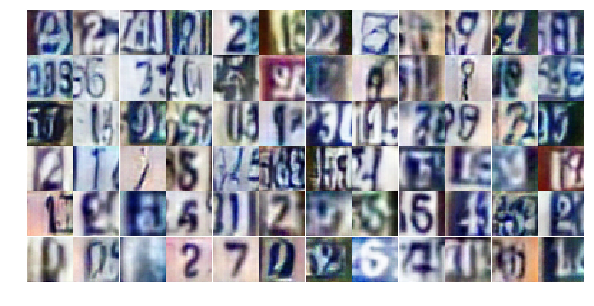

Epoch 22/25... Discriminator Loss: 1.5021... Generator Loss: 0.3797
Epoch 22/25... Discriminator Loss: 0.6478... Generator Loss: 1.1679
Epoch 22/25... Discriminator Loss: 0.8534... Generator Loss: 0.8923
Epoch 22/25... Discriminator Loss: 1.1674... Generator Loss: 0.5989
Epoch 22/25... Discriminator Loss: 0.8924... Generator Loss: 0.7982
Epoch 22/25... Discriminator Loss: 0.7851... Generator Loss: 1.0443
Epoch 22/25... Discriminator Loss: 1.2316... Generator Loss: 0.5014
Epoch 22/25... Discriminator Loss: 0.6404... Generator Loss: 1.0031
Epoch 22/25... Discriminator Loss: 0.9085... Generator Loss: 1.6924
Epoch 22/25... Discriminator Loss: 0.8461... Generator Loss: 0.8905


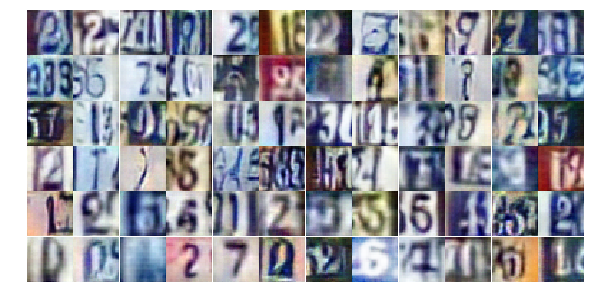

Epoch 23/25... Discriminator Loss: 0.5586... Generator Loss: 1.5523
Epoch 23/25... Discriminator Loss: 0.4550... Generator Loss: 1.4030
Epoch 23/25... Discriminator Loss: 0.8736... Generator Loss: 0.8587
Epoch 23/25... Discriminator Loss: 0.5148... Generator Loss: 1.4311
Epoch 23/25... Discriminator Loss: 0.7796... Generator Loss: 2.4031
Epoch 23/25... Discriminator Loss: 1.1179... Generator Loss: 0.5918
Epoch 23/25... Discriminator Loss: 1.3316... Generator Loss: 0.4570
Epoch 23/25... Discriminator Loss: 0.7434... Generator Loss: 0.8932
Epoch 23/25... Discriminator Loss: 0.6544... Generator Loss: 1.1444
Epoch 23/25... Discriminator Loss: 0.5235... Generator Loss: 1.3174


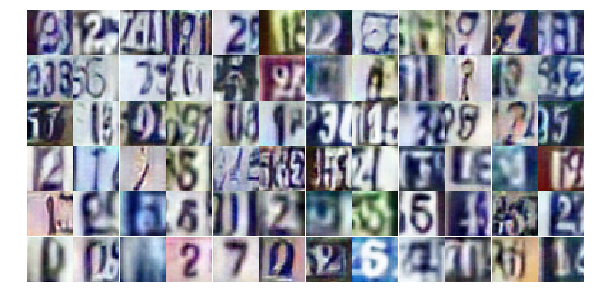

Epoch 23/25... Discriminator Loss: 0.6861... Generator Loss: 0.9959
Epoch 23/25... Discriminator Loss: 0.7643... Generator Loss: 0.8944
Epoch 23/25... Discriminator Loss: 1.0712... Generator Loss: 0.5994
Epoch 23/25... Discriminator Loss: 0.7864... Generator Loss: 0.8515
Epoch 23/25... Discriminator Loss: 0.5238... Generator Loss: 1.6455
Epoch 23/25... Discriminator Loss: 0.7746... Generator Loss: 0.9256
Epoch 23/25... Discriminator Loss: 0.8828... Generator Loss: 0.8467
Epoch 23/25... Discriminator Loss: 0.6227... Generator Loss: 1.1802
Epoch 23/25... Discriminator Loss: 0.6802... Generator Loss: 1.1633
Epoch 23/25... Discriminator Loss: 0.7902... Generator Loss: 1.0583


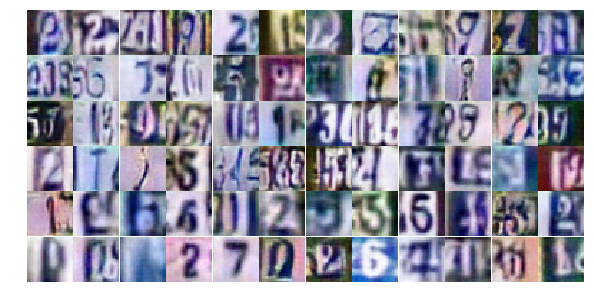

Epoch 23/25... Discriminator Loss: 0.8217... Generator Loss: 0.8672
Epoch 23/25... Discriminator Loss: 0.5225... Generator Loss: 1.7079
Epoch 23/25... Discriminator Loss: 0.9470... Generator Loss: 0.6914
Epoch 23/25... Discriminator Loss: 0.8529... Generator Loss: 0.7945
Epoch 23/25... Discriminator Loss: 1.1275... Generator Loss: 0.5890
Epoch 23/25... Discriminator Loss: 0.8765... Generator Loss: 0.8056
Epoch 23/25... Discriminator Loss: 0.5940... Generator Loss: 1.3649
Epoch 23/25... Discriminator Loss: 1.0000... Generator Loss: 0.6442
Epoch 23/25... Discriminator Loss: 1.8806... Generator Loss: 0.2956
Epoch 23/25... Discriminator Loss: 8.2759... Generator Loss: 0.0061


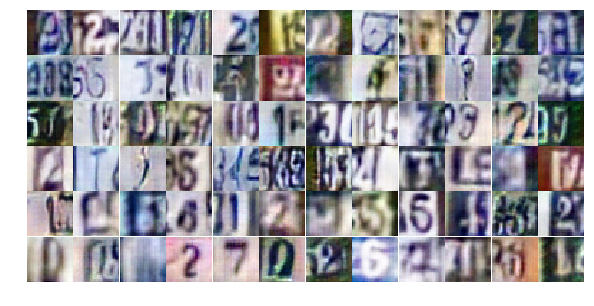

Epoch 23/25... Discriminator Loss: 0.8826... Generator Loss: 2.0284
Epoch 23/25... Discriminator Loss: 0.7581... Generator Loss: 1.0425
Epoch 23/25... Discriminator Loss: 0.8142... Generator Loss: 1.8989
Epoch 23/25... Discriminator Loss: 1.0106... Generator Loss: 0.6421
Epoch 23/25... Discriminator Loss: 0.9187... Generator Loss: 0.8685
Epoch 23/25... Discriminator Loss: 0.8438... Generator Loss: 0.8605
Epoch 23/25... Discriminator Loss: 1.3968... Generator Loss: 0.4218
Epoch 23/25... Discriminator Loss: 0.5989... Generator Loss: 1.2328
Epoch 23/25... Discriminator Loss: 0.5065... Generator Loss: 1.4264
Epoch 23/25... Discriminator Loss: 0.8418... Generator Loss: 0.7799


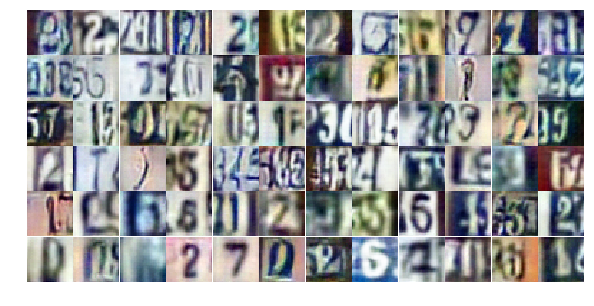

Epoch 23/25... Discriminator Loss: 0.8665... Generator Loss: 0.8702
Epoch 23/25... Discriminator Loss: 0.8258... Generator Loss: 0.8789
Epoch 23/25... Discriminator Loss: 1.3638... Generator Loss: 0.4458
Epoch 23/25... Discriminator Loss: 0.9479... Generator Loss: 0.7084
Epoch 23/25... Discriminator Loss: 1.3946... Generator Loss: 0.4888
Epoch 23/25... Discriminator Loss: 0.9377... Generator Loss: 0.8204
Epoch 23/25... Discriminator Loss: 0.8536... Generator Loss: 0.7909
Epoch 23/25... Discriminator Loss: 1.2955... Generator Loss: 0.4725
Epoch 23/25... Discriminator Loss: 0.8567... Generator Loss: 0.9146
Epoch 23/25... Discriminator Loss: 0.7154... Generator Loss: 1.1390


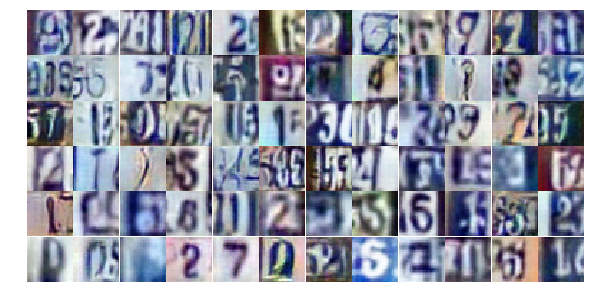

Epoch 23/25... Discriminator Loss: 0.6354... Generator Loss: 1.1524
Epoch 23/25... Discriminator Loss: 1.3625... Generator Loss: 0.4448
Epoch 23/25... Discriminator Loss: 1.3698... Generator Loss: 0.5708
Epoch 23/25... Discriminator Loss: 0.4339... Generator Loss: 1.5421
Epoch 23/25... Discriminator Loss: 1.1900... Generator Loss: 0.5366
Epoch 23/25... Discriminator Loss: 0.6676... Generator Loss: 1.1596
Epoch 23/25... Discriminator Loss: 0.9729... Generator Loss: 0.7138
Epoch 24/25... Discriminator Loss: 0.9854... Generator Loss: 0.6294
Epoch 24/25... Discriminator Loss: 0.7900... Generator Loss: 0.9874
Epoch 24/25... Discriminator Loss: 1.4505... Generator Loss: 0.3751


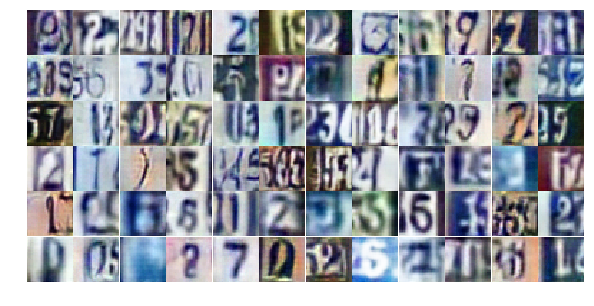

Epoch 24/25... Discriminator Loss: 0.6924... Generator Loss: 1.0024
Epoch 24/25... Discriminator Loss: 0.6683... Generator Loss: 1.1151
Epoch 24/25... Discriminator Loss: 0.5714... Generator Loss: 1.1233
Epoch 24/25... Discriminator Loss: 0.9143... Generator Loss: 2.1216
Epoch 24/25... Discriminator Loss: 0.5929... Generator Loss: 1.1778
Epoch 24/25... Discriminator Loss: 0.6522... Generator Loss: 1.1123
Epoch 24/25... Discriminator Loss: 0.8771... Generator Loss: 0.7795
Epoch 24/25... Discriminator Loss: 0.9416... Generator Loss: 0.7215
Epoch 24/25... Discriminator Loss: 0.3369... Generator Loss: 1.7705
Epoch 24/25... Discriminator Loss: 0.6269... Generator Loss: 1.3966


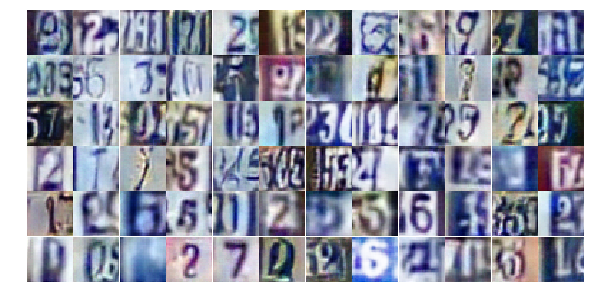

Epoch 24/25... Discriminator Loss: 1.2644... Generator Loss: 0.4875
Epoch 24/25... Discriminator Loss: 1.3502... Generator Loss: 0.4325
Epoch 24/25... Discriminator Loss: 0.9664... Generator Loss: 0.7327
Epoch 24/25... Discriminator Loss: 0.7514... Generator Loss: 0.9492
Epoch 24/25... Discriminator Loss: 0.6655... Generator Loss: 2.9654
Epoch 24/25... Discriminator Loss: 1.1330... Generator Loss: 0.5489
Epoch 24/25... Discriminator Loss: 0.4697... Generator Loss: 1.4326
Epoch 24/25... Discriminator Loss: 1.1789... Generator Loss: 0.5892
Epoch 24/25... Discriminator Loss: 1.1314... Generator Loss: 0.5788
Epoch 24/25... Discriminator Loss: 0.8092... Generator Loss: 0.8546


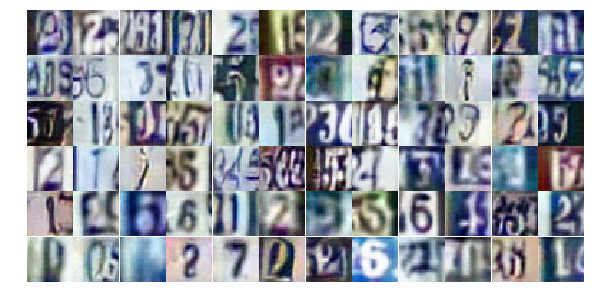

Epoch 24/25... Discriminator Loss: 0.9201... Generator Loss: 0.7398
Epoch 24/25... Discriminator Loss: 0.6086... Generator Loss: 1.2147
Epoch 24/25... Discriminator Loss: 0.5177... Generator Loss: 1.5119
Epoch 24/25... Discriminator Loss: 1.1641... Generator Loss: 0.6997
Epoch 24/25... Discriminator Loss: 0.6478... Generator Loss: 1.0705
Epoch 24/25... Discriminator Loss: 0.6513... Generator Loss: 1.1101
Epoch 24/25... Discriminator Loss: 0.5103... Generator Loss: 1.2196
Epoch 24/25... Discriminator Loss: 0.6360... Generator Loss: 1.5096
Epoch 24/25... Discriminator Loss: 0.5843... Generator Loss: 1.2224
Epoch 24/25... Discriminator Loss: 0.7971... Generator Loss: 0.9670


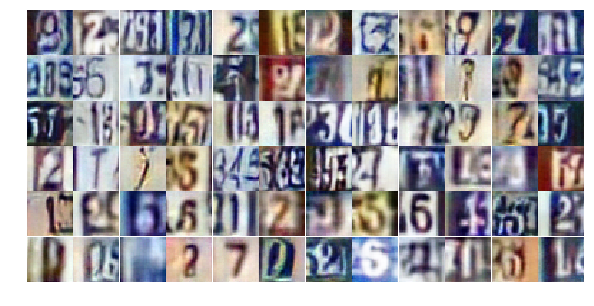

Epoch 24/25... Discriminator Loss: 0.3563... Generator Loss: 2.0519
Epoch 24/25... Discriminator Loss: 0.6594... Generator Loss: 1.0202
Epoch 24/25... Discriminator Loss: 1.3525... Generator Loss: 0.4492
Epoch 24/25... Discriminator Loss: 1.5366... Generator Loss: 0.3975
Epoch 24/25... Discriminator Loss: 0.9141... Generator Loss: 0.7937
Epoch 24/25... Discriminator Loss: 1.4317... Generator Loss: 0.4375
Epoch 24/25... Discriminator Loss: 1.7946... Generator Loss: 0.2830
Epoch 24/25... Discriminator Loss: 0.8510... Generator Loss: 0.8079
Epoch 24/25... Discriminator Loss: 0.8901... Generator Loss: 0.8090
Epoch 24/25... Discriminator Loss: 0.5810... Generator Loss: 1.2849


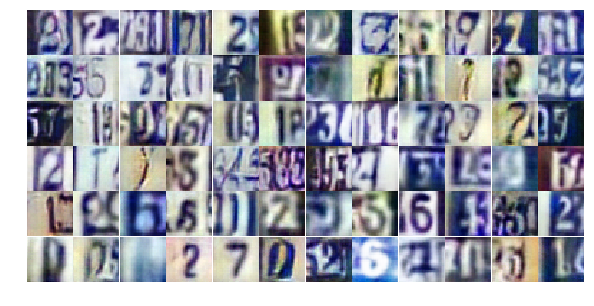

Epoch 24/25... Discriminator Loss: 0.9219... Generator Loss: 0.7615
Epoch 24/25... Discriminator Loss: 1.0954... Generator Loss: 0.5727
Epoch 24/25... Discriminator Loss: 1.6668... Generator Loss: 0.3302
Epoch 24/25... Discriminator Loss: 1.7047... Generator Loss: 0.2976
Epoch 24/25... Discriminator Loss: 1.3179... Generator Loss: 0.4897
Epoch 24/25... Discriminator Loss: 0.6280... Generator Loss: 1.1716
Epoch 24/25... Discriminator Loss: 1.0476... Generator Loss: 0.7415
Epoch 24/25... Discriminator Loss: 0.6850... Generator Loss: 1.1418
Epoch 24/25... Discriminator Loss: 0.9134... Generator Loss: 0.7018
Epoch 24/25... Discriminator Loss: 0.9429... Generator Loss: 0.8099


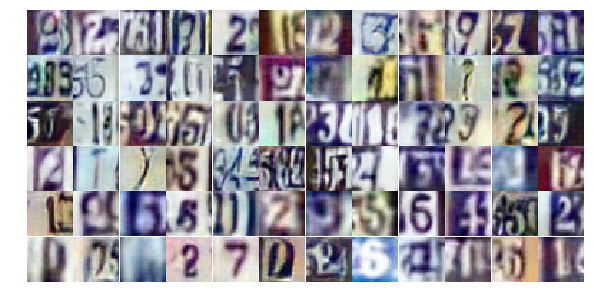

Epoch 24/25... Discriminator Loss: 2.1923... Generator Loss: 0.2132
Epoch 24/25... Discriminator Loss: 1.4710... Generator Loss: 0.4069
Epoch 24/25... Discriminator Loss: 1.3771... Generator Loss: 0.4252
Epoch 24/25... Discriminator Loss: 0.8342... Generator Loss: 0.9656
Epoch 24/25... Discriminator Loss: 1.1715... Generator Loss: 0.5687
Epoch 25/25... Discriminator Loss: 0.7421... Generator Loss: 0.9006
Epoch 25/25... Discriminator Loss: 0.4177... Generator Loss: 1.8002
Epoch 25/25... Discriminator Loss: 0.7673... Generator Loss: 0.8907
Epoch 25/25... Discriminator Loss: 0.9245... Generator Loss: 0.7487
Epoch 25/25... Discriminator Loss: 0.9296... Generator Loss: 0.7158


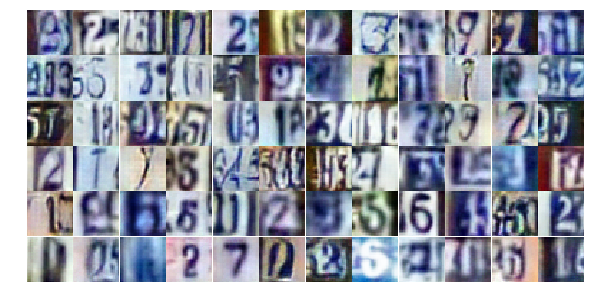

Epoch 25/25... Discriminator Loss: 1.0649... Generator Loss: 0.5558
Epoch 25/25... Discriminator Loss: 0.7737... Generator Loss: 1.0883
Epoch 25/25... Discriminator Loss: 0.6413... Generator Loss: 1.0490
Epoch 25/25... Discriminator Loss: 1.2003... Generator Loss: 0.5154
Epoch 25/25... Discriminator Loss: 0.7684... Generator Loss: 0.9651
Epoch 25/25... Discriminator Loss: 0.9663... Generator Loss: 0.7070
Epoch 25/25... Discriminator Loss: 0.9581... Generator Loss: 0.6446
Epoch 25/25... Discriminator Loss: 0.7045... Generator Loss: 1.2214
Epoch 25/25... Discriminator Loss: 0.5759... Generator Loss: 1.1974
Epoch 25/25... Discriminator Loss: 0.7328... Generator Loss: 0.9602


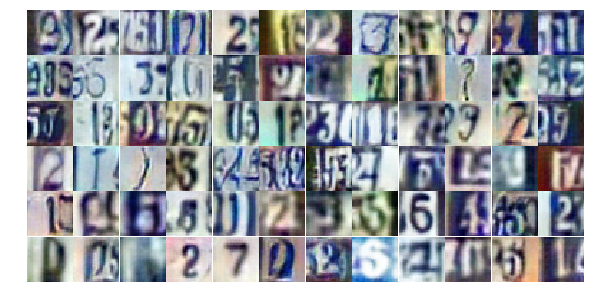

Epoch 25/25... Discriminator Loss: 0.8916... Generator Loss: 0.7704
Epoch 25/25... Discriminator Loss: 0.4940... Generator Loss: 1.8348
Epoch 25/25... Discriminator Loss: 1.9696... Generator Loss: 0.2441
Epoch 25/25... Discriminator Loss: 2.7400... Generator Loss: 0.2935
Epoch 25/25... Discriminator Loss: 2.2288... Generator Loss: 0.4851
Epoch 25/25... Discriminator Loss: 1.5516... Generator Loss: 0.8081
Epoch 25/25... Discriminator Loss: 1.5201... Generator Loss: 1.0824
Epoch 25/25... Discriminator Loss: 1.5519... Generator Loss: 0.9108
Epoch 25/25... Discriminator Loss: 1.3436... Generator Loss: 0.8724
Epoch 25/25... Discriminator Loss: 1.3866... Generator Loss: 0.7171


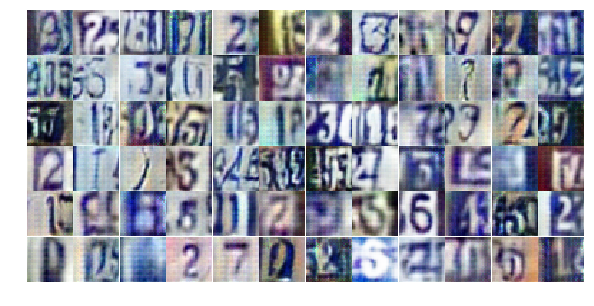

Epoch 25/25... Discriminator Loss: 1.4010... Generator Loss: 0.9934
Epoch 25/25... Discriminator Loss: 1.4820... Generator Loss: 1.0499
Epoch 25/25... Discriminator Loss: 1.5303... Generator Loss: 0.6570
Epoch 25/25... Discriminator Loss: 1.1993... Generator Loss: 1.0880
Epoch 25/25... Discriminator Loss: 1.4029... Generator Loss: 0.9387
Epoch 25/25... Discriminator Loss: 1.1665... Generator Loss: 1.1327
Epoch 25/25... Discriminator Loss: 1.1072... Generator Loss: 0.8327
Epoch 25/25... Discriminator Loss: 0.9354... Generator Loss: 1.9829
Epoch 25/25... Discriminator Loss: 0.9346... Generator Loss: 1.3927
Epoch 25/25... Discriminator Loss: 1.4298... Generator Loss: 0.5144


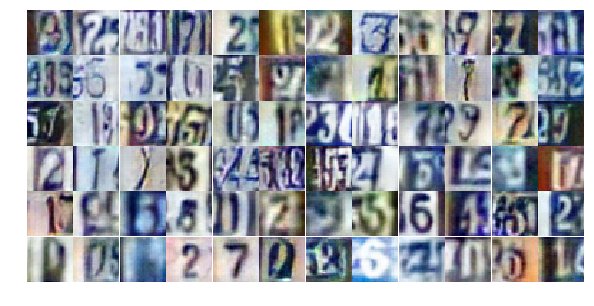

Epoch 25/25... Discriminator Loss: 0.9328... Generator Loss: 0.8348
Epoch 25/25... Discriminator Loss: 0.8033... Generator Loss: 0.9969
Epoch 25/25... Discriminator Loss: 0.9810... Generator Loss: 2.0466
Epoch 25/25... Discriminator Loss: 0.7808... Generator Loss: 0.9395
Epoch 25/25... Discriminator Loss: 1.4731... Generator Loss: 0.4541
Epoch 25/25... Discriminator Loss: 1.1007... Generator Loss: 0.6509
Epoch 25/25... Discriminator Loss: 0.6559... Generator Loss: 1.1749
Epoch 25/25... Discriminator Loss: 0.9284... Generator Loss: 0.7227
Epoch 25/25... Discriminator Loss: 1.8397... Generator Loss: 0.2631
Epoch 25/25... Discriminator Loss: 0.8662... Generator Loss: 0.7819


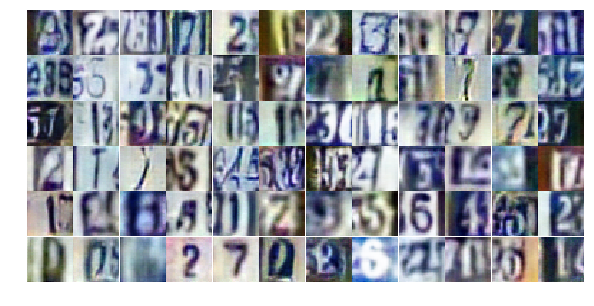

Epoch 25/25... Discriminator Loss: 0.8034... Generator Loss: 1.3231
Epoch 25/25... Discriminator Loss: 1.0631... Generator Loss: 0.6954
Epoch 25/25... Discriminator Loss: 1.1383... Generator Loss: 0.5806
Epoch 25/25... Discriminator Loss: 1.4583... Generator Loss: 0.3963
Epoch 25/25... Discriminator Loss: 0.8936... Generator Loss: 0.8036
Epoch 25/25... Discriminator Loss: 0.4826... Generator Loss: 1.3726
Epoch 25/25... Discriminator Loss: 1.3184... Generator Loss: 0.5309
Epoch 25/25... Discriminator Loss: 0.6883... Generator Loss: 1.0454
Epoch 25/25... Discriminator Loss: 0.7644... Generator Loss: 0.9470
Epoch 25/25... Discriminator Loss: 1.1102... Generator Loss: 0.5789


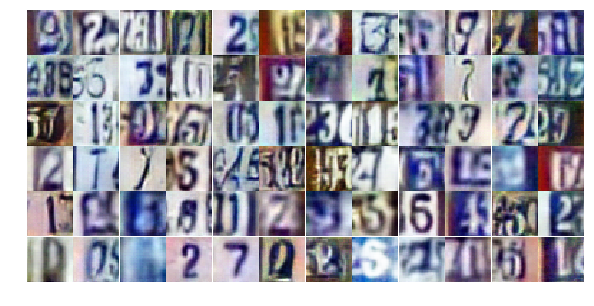

Epoch 25/25... Discriminator Loss: 0.9146... Generator Loss: 0.8746
Epoch 25/25... Discriminator Loss: 1.1225... Generator Loss: 0.7027


In [27]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

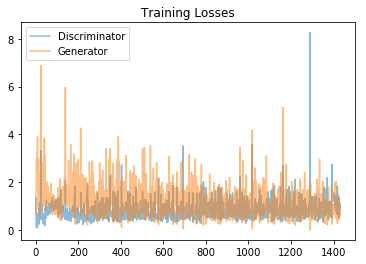

In [28]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

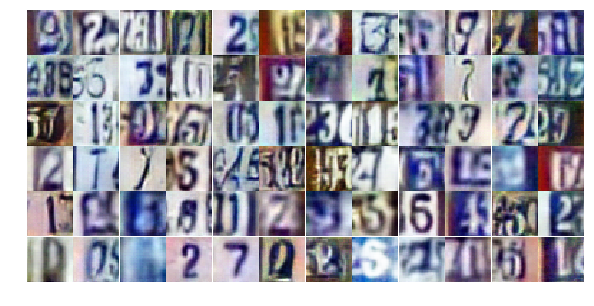

In [29]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))